# Bias Mitigation Experiments - COMPAS

## Table of Contents

<!-- To return to the table of contents, click on the number at any major section heading.

* [1. Prepare COMPAS data](#1.-Prepare-COMPAS-data)

* [2. Training Baseline Models](#2.-Training-Baseline-Models)
    * [2.1 Logistic Regression](#2.1-Learning-a-Logistic-Regression-(LR)-classifier-on-original-data)
    * [2.2 Random Forest](#2.2-Learning-a-Random-Forest-(RF)-classifier-on-original-data)

* [3. Bias mitigation using pre-processing technique](#3.-Bias-mitigation-using-pre-processing-technique)

   * [3.1 Reweighing](#3.1-Reweighing)
       * [3.1.1 RW on Logistic Regression](#3.1.1.-Learning-a-Logistic-Regression-(LR)-classifier-on-data-transformed-by-reweighing)
       * [3.1.2 RW on Random Forest](#3.1.2.-Learning-a-Random-Forest-(RF)-classifier-on-data-transformed-by-reweighing)
   * [3.2 Disparate impact remover ](#3.2-Disparate-impact-remover)
       * [3.2.1 DIR on Logistic Regression](#3.2.1-Learning-a-Logistic-Regression-(LR)-classifier-on-data-transformed-by-DIR)
       * [3.2.2 DIR on Random Forest](#3.2.2-Learning-a-Random-Forest-(RF)-classifier-on-data-transformed-by-DIR)
  
* [4. Bias mitigation using in-processing technique](#4.-Bias-mitigation-using-in-processing-technique)
    * [4.1 Prejudice Remover (PR)](#4.1-Prejudice-Remover-(PR))
    * [4.2 Adversarial Debiasing](#4.2-Adversarial-Debiasing)

* [5. Bias mitigation using post-processing technique](#5.-Bias-mitigation-using-post-processing-technique)
    * [5.1 Reject option classification (ROC)](#5.1-Reject-option-classification-(RejOpCl))
        * [5.1.1 ROC on Logistic Regression](#5.1.1-Reject-option-classification-on-Logistic-Regression)
        * [5.1.2 ROC on Random Forest](#5.1.2-Reject-option-classification-on-Random-Forest)
    * [5.2 Equalized odds processor (EOPP)](#5.2-Equalized-odds-processor-(EqOddsPr))
        * [5.2.1 EOPP on Logistic Regression](#5.2.1-Equalized-odds-processor-on-Logistic-Regression)
        * [5.2.2 EOPP on Random Forest](#5.2.2-Equalized-odds-processor-on-Random-Forest)

* [6. Summary of results](#6.-Summary-of-Model-Learning-Results)

* [7. Analyze rates of different mitigators](#7.-Analyze-rates-of-different-mitigators)

 -->

In [1]:
data_name = 'Compas'

In [2]:
# to ignore warnings
import warnings
# warnings.filterwarnings('ignore')

In [3]:
import numpy as np
import pandas as pd
import tensorflow.compat.v1 as tf
# tf.disable_eager_execution() # comment out when running TabTransformer models

2023-02-13 22:51:20.955334: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2023-02-13 22:51:20.955365: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.


## [1.](#Table-of-Contents) Prepare COMPAS data

In [4]:
# read in data as pandas data frame
df = pd.read_csv("../data/Compas/compas-scores-two-years.csv")
# check columns
pd.set_option('display.max_columns', None) # expand all columns
print(df.shape)
df.head()

(7214, 53)


,id,name,first,last,compas_screening_date,sex,dob,age,age_cat,race,juv_fel_count,decile_score,juv_misd_count,juv_other_count,priors_count,days_b_screening_arrest,c_jail_in,c_jail_out,c_case_number,c_offense_date,c_arrest_date,c_days_from_compas,c_charge_degree,c_charge_desc,is_recid,r_case_number,r_charge_degree,r_days_from_arrest,r_offense_date,r_charge_desc,r_jail_in,r_jail_out,violent_recid,is_violent_recid,vr_case_number,vr_charge_degree,vr_offense_date,vr_charge_desc,type_of_assessment,decile_score.1,score_text,screening_date,v_type_of_assessment,v_decile_score,v_score_text,v_screening_date,in_custody,out_custody,priors_count.1,start,end,event,two_year_recid
0,1,miguel hernandez,miguel,hernandez,2013-08-14,Male,1947-04-18,69,Greater than 45,Other,0,1,0,0,0,-1.0,2013-08-13 06:03:42,2013-08-14 05:41:20,13011352CF10A,2013-08-13,NaN,1.0,F,Aggravated Assault w/Firearm,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,Risk of Recidivism,1,Low,2013-08-14,Risk of Violence,1,Low,2013-08-14,2014-07-07,2014-07-14,0,0,327,0,0
1,3,kevon dixon,kevon,dixon,2013-01-27,Male,1982-01-22,34,25 - 45,African-American,0,3,0,0,0,-1.0,2013-01-26 03:45:27,2013-02-05 05:36:53,13001275CF10A,2013-01-26,NaN,1.0,F,Felony Battery w/Prior Convict,1,13009779CF10A,(F3),NaN,2013-07-05,Felony Battery (Dom Strang),NaN,NaN,NaN,1,13009779CF10A,(F3),2013-07-05,Felony Battery (Dom Strang),Risk of Recidivism,3,Low,2013-01-27,Risk of Violence,1,Low,2013-01-27,2013-01-26,2013-02-05,0,9,159,1,1
2,4,ed philo,ed,philo,2013-04-14,Male,1991-05-14,24,Less than 25,African-American,0,4,0,1,4,-1.0,2013-04-13 04:58:34,2013-04-14 07:02:04,13005330CF10A,2013-04-13,NaN,1.0,F,Possession of Cocaine,1,13011511MM10A,(M1),0.0,2013-06-16,Driving Under The Influence,2013-06-16,2013-06-16,NaN,0,NaN,NaN,NaN,NaN,Risk of Recidivism,4,Low,2013-04-14,Risk of Violence,3,Low,2013-04-14,2013-06-16,2013-06-16,4,0,63,0,1
3,5,marcu brown,marcu,brown,2013-01-13,Male,1993-01-21,23,Less than 25,African-American,0,8,1,0,1,NaN,NaN,NaN,13000570CF10A,2013-01-12,NaN,1.0,F,Possession of Cannabis,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,Risk of Recidivism,8,High,2013-01-13,Risk of Violence,6,Medium,2013-01-13,NaN,NaN,1,0,1174,0,0
4,6,bouthy pierrelouis,bouthy,pierrelouis,2013-03-26,Male,1973-01-22,43,25 - 45,Other,0,1,0,0,2,NaN,NaN,NaN,12014130CF10A,NaN,2013-01-09,76.0,F,arrest case no charge,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,Risk of Recidivism,1,Low,2013-03-26,Risk of Violence,1,Low,2013-03-26,NaN,NaN,2,0,1102,0,0


In [5]:
df['race'].value_counts()

African-American    3696
Caucasian           2454
Hispanic             637
Other                377
Asian                 32
Native American       18
Name: race, dtype: int64

In [6]:
# data pre-processing
import re
label = 'two_year_recid'
protected_attribute = 'race'
# 1. select features of interest
keep_var = ['sex','age','race','juv_fel_count','juv_misd_count','juv_other_count','priors_count',
            'c_charge_degree', 'two_year_recid']
df = df[keep_var]

# 2. encode label and potential protected features 
race_mapping = {'Caucasian': 1, 'African-American': 0}
sex_mapping = {'Female': 1, 'Male': 0} # female is the privileged group in this case

df = df[df.race.isin(race_mapping.keys())] # only include samples with certain race values
df.race.replace(race_mapping, inplace=True)
df.sex.replace(sex_mapping, inplace=True)
df = df.reset_index(drop=True)

print(df.shape)
df.head()

(6150, 9)


,sex,age,race,juv_fel_count,juv_misd_count,juv_other_count,priors_count,c_charge_degree,two_year_recid
0,0,34,0,0,0,0,0,F,1
1,0,24,0,0,0,1,4,F,1
2,0,23,0,0,1,0,1,F,0
3,0,41,1,0,0,0,14,F,1
4,1,39,1,0,0,0,0,M,0


In [7]:
# flip labels to ensure pos_label = 1, not becoming recidivist
df[label] = (~df[label].astype(bool)).astype(int)

# select descriptive features and target variable
X = df.drop(columns=label, axis=1) # select all features but target feature
y = df[[protected_attribute, label]] # include protected feature in order to AIF360

In [8]:
# set protected attribute as index
X = X.set_index([protected_attribute], append = True, drop = False)
y = y.set_index([protected_attribute], append = True)

# make y data frames to 1d array to pass modeling, but keep index (protected attribute)
y = pd.Series(y[label], index=y.index)

In [10]:
X.to_pickle('../data/{}/{}_X'.format(data_name, data_name))
y.to_pickle('../data/{}/{}_y'.format(data_name, data_name))

## [2.](#Table-of-Contents) Proposed GridSearch Approach 

The GridSearch Approach includes hyperparameter, threshold, and Bias Mitigation

In [4]:
from FairGridSearch import *
%load_ext autoreload
%autoreload 2
# allow automatic reloading of changes in FairGridSearch file

pip install 'aif360[LawSchoolGPA]'
pip install 'aif360[FairAdapt]'


In [5]:
# None, better
# 'RW', worse
# 'LFR_pre', stuck
# 'LFR_in', stuck
# 'AD', stuck
# 'EGR',better
# 'ROC', better
# 'CEO', better

## 3. Case Study: COMPAS

In [6]:
label = 'two_year_recid'
protected_attribute = 'race'

pos_label = 1
priv_group = 1

cv=10
n_jobs=multiprocessing.cpu_count()-1

In [7]:
X = pd.read_pickle('../data/{}/{}_X'.format(data_name, data_name))
y = pd.read_pickle('../data/{}/{}_y'.format(data_name, data_name))

In [8]:
# define desired metric for the use case
ACC_METRIC = 'avg_norm_mcc_score'
FAIR_METRIC = 'abs_avg_ppvd_score'

### Logistic Regression

In [9]:
import timeit
start = timeit.default_timer()

param_grid = {'hyperp_grid': {'C':[1, 10],'solver':['liblinear', 'saga'],'penalty':['l2']}, 
              'threshold': np.linspace(0.3, 0.7, 5),
              'Bias_Mitigation':[None,'RW','LFR_pre','LFR_in','AD','EGR','ROC','CEO','RW+ROC','RW+CEO']}

clf_lr = fair_GridsearchCV(base='LR', param_grid=param_grid, 
                           prot_attr=protected_attribute, pos_label=pos_label, priv_group=priv_group,
                           cv=cv, n_jobs=n_jobs)
if __name__ == '__main__':
    clf_lr.fit(X=X, y=y)
    
results_lr = clf_lr.output_table
print(clf_lr._best_param)

stop = timeit.default_timer()
runtime = stop - start
if runtime < 60:
    print('Time: ', runtime, 'sec')
else: print('Time: ', runtime/60, 'min')
results_lr.to_pickle('./{}_results/{}_results_LR'.format(data_name,data_name))
style_table(results_lr)

  0%|          | 0/4 [00:00<?, ?it/s]

{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}
------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

{'C': 1, 'penalty': 'l2', 'solver': 'saga'}
------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

{'C': 10, 'penalty': 'l2', 'solver': 'liblinear'}
------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

{'C': 10, 'penalty': 'l2', 'solver': 'saga'}
------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib

base_estimator                                                   LR
param              {'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}
Bias_Mitigation                                                  AD
threshold                                                       0.6
Name: 23, dtype: object
Time:  5.112763596649999 min


,base_estimator,param,Bias_Mitigation,threshold,avg_acc_score,avg_bacc_score,avg_f1_score,avg_auc_score,avg_mcc_score,avg_norm_mcc_score,avg_spd_score,avg_aod_score,avg_eod_score,avg_ford_score,avg_ppvd_score,avg_(1-consistency_score),avg_gei_score,avg_ti_score,cost
0,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}",None,0.300000,0.599675,0.574001,0.717826,0.722252,0.230838,0.615419,-0.111578,-0.101662,-0.047617,-0.040474,-0.085145,0.041789,0.075919,0.084654,0.496159
1,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}",None,0.400000,0.644878,0.625993,0.731284,0.722252,0.307816,0.653908,-0.167803,-0.145699,-0.090881,-0.005364,-0.069432,0.055089,0.092411,0.110363,0.513895
2,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}",None,0.500000,0.674797,0.668928,0.712626,0.722252,0.344032,0.672016,-0.259550,-0.227603,-0.177167,-0.052065,-0.022598,0.054667,0.141747,0.191353,0.587534
3,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}",None,0.600000,0.631057,0.641059,0.587770,0.722252,0.292908,0.646454,-0.272406,-0.240094,-0.251880,-0.067096,-0.000951,0.053496,0.247697,0.353812,0.625952
4,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}",None,0.700000,0.571545,0.592756,0.409891,0.722252,0.234684,0.617342,-0.204943,-0.179076,-0.232693,-0.074657,-0.017874,0.038504,0.359579,0.509255,0.587601
5,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}",RW,0.300000,0.595610,0.569373,0.716542,0.710707,0.223255,0.611627,-0.035465,-0.018977,-0.017801,-0.022973,-0.116823,0.044520,0.074609,0.082661,0.423838
6,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}",RW,0.400000,0.628943,0.609497,0.720747,0.710707,0.270825,0.635412,-0.019245,0.007191,0.010330,-0.115990,-0.113930,0.056390,0.095209,0.115446,0.383832
7,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}",RW,0.500000,0.653171,0.646175,0.697547,0.710707,0.299696,0.649848,0.044163,0.077048,0.108109,-0.187841,-0.098558,0.062341,0.146172,0.197301,0.394315
8,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}",RW,0.600000,0.631545,0.641380,0.589259,0.710707,0.293352,0.646676,-0.017352,0.012480,0.050168,-0.151855,-0.055709,0.049593,0.246495,0.352042,0.370676
9,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}",RW,0.700000,0.565203,0.587241,0.390756,0.710707,0.226524,0.613262,-0.056577,-0.035529,-0.040883,-0.116220,-0.052975,0.037691,0.370796,0.523575,0.443315


### Random Forest

In [10]:
import timeit
start = timeit.default_timer()

param_grid = {'hyperp_grid': {'n_estimators':[10, 50],'criterion':['gini', 'entropy'], 'max_depth':[16]}, 
              'threshold': np.linspace(0.3, 0.7, 5),
              'Bias_Mitigation':[None,'RW','LFR_pre','EGR','ROC','CEO','RW+ROC','RW+CEO']}

clf_rf = fair_GridsearchCV(base='RF', param_grid=param_grid,
                           prot_attr=protected_attribute, pos_label=pos_label, priv_group=priv_group,
                           cv=cv, n_jobs=n_jobs)
if __name__ == '__main__':
    clf_rf.fit(X=X, y=y)
    
results_rf = clf_rf.output_table
print(clf_rf._best_param)

stop = timeit.default_timer()
runtime = stop - start
if runtime < 60:
    print('Time: ', runtime, 'sec')
else: print('Time: ', runtime/60, 'min')
results_rf.to_pickle('./{}_results/{}_results_RF'.format(data_name, data_name))
style_table(results_rf)

  0%|          | 0/4 [00:00<?, ?it/s]

{'criterion': 'gini', 'max_depth': 16, 'n_estimators': 10}
------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use groupby instead. df.sum(level=1) should use df.groupby(level=1).sum().
  lambda_event = (lambda_vec["+"] - self.ratio * lambda_vec["-"]).sum(level=_EVENT) / \
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use grou

{'criterion': 'gini', 'max_depth': 16, 'n_estimators': 50}
------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-u

{'criterion': 'entropy', 'max_depth': 16, 'n_estimators': 10}
------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use groupby instead. df.sum(level=1) should use df.groupby(level=1).sum().
  lambda_event = (lambda_vec["+"] - self.ratio * lambda_vec["-"]).sum(level=_EVENT) / \
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use grou

{'criterion': 'entropy', 'max_depth': 16, 'n_estimators': 50}
------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/def

base_estimator                                                    RF
param              {'criterion': 'entropy', 'max_depth': 16, 'n_e...
Bias_Mitigation                                               RW+CEO
threshold                                                        0.4
Name: 116, dtype: object
Time:  4.742698474000008 min


,base_estimator,param,Bias_Mitigation,threshold,avg_acc_score,avg_bacc_score,avg_f1_score,avg_auc_score,avg_mcc_score,avg_norm_mcc_score,avg_spd_score,avg_aod_score,avg_eod_score,avg_ford_score,avg_ppvd_score,avg_(1-consistency_score),avg_gei_score,avg_ti_score,cost
0,RF,"{'criterion': 'gini', 'max_depth': 16, 'n_estimators': 10}",None,0.300000,0.615610,0.598383,0.703140,0.663190,0.230911,0.615455,-0.106297,-0.089824,-0.037734,-0.155259,-0.077496,0.183870,0.110417,0.140535,0.490842
1,RF,"{'criterion': 'gini', 'max_depth': 16, 'n_estimators': 10}",None,0.400000,0.627317,0.616621,0.689357,0.663190,0.246955,0.623477,-0.119614,-0.097943,-0.050725,-0.140409,-0.069217,0.209138,0.138534,0.184877,0.496137
2,RF,"{'criterion': 'gini', 'max_depth': 16, 'n_estimators': 10}",None,0.500000,0.624390,0.621109,0.655208,0.663190,0.243601,0.621800,-0.163223,-0.142134,-0.087508,-0.141510,-0.041868,0.231089,0.179442,0.247596,0.541423
3,RF,"{'criterion': 'gini', 'max_depth': 16, 'n_estimators': 10}",None,0.600000,0.610244,0.614493,0.601527,0.663190,0.229984,0.614992,-0.171675,-0.150868,-0.106398,-0.134833,-0.024559,0.240195,0.230142,0.322105,0.556682
4,RF,"{'criterion': 'gini', 'max_depth': 16, 'n_estimators': 10}",None,0.700000,0.578699,0.590770,0.510974,0.663190,0.193138,0.596569,-0.154254,-0.137963,-0.103684,-0.134942,-0.008952,0.230504,0.300365,0.418587,0.557685
5,RF,"{'criterion': 'gini', 'max_depth': 16, 'n_estimators': 10}",RW,0.300000,0.610732,0.593396,0.699751,0.660284,0.219199,0.609599,-0.062055,-0.045177,0.000197,-0.175159,-0.084772,0.183480,0.111536,0.142540,0.452455
6,RF,"{'criterion': 'gini', 'max_depth': 16, 'n_estimators': 10}",RW,0.400000,0.620650,0.609560,0.685165,0.660284,0.233071,0.616535,-0.074983,-0.055433,-0.000400,-0.175014,-0.069537,0.212000,0.139298,0.186063,0.458447
7,RF,"{'criterion': 'gini', 'max_depth': 16, 'n_estimators': 10}",RW,0.500000,0.619187,0.615167,0.653931,0.660284,0.232207,0.616104,-0.089016,-0.069172,-0.009063,-0.169990,-0.051353,0.231740,0.177888,0.245035,0.472913
8,RF,"{'criterion': 'gini', 'max_depth': 16, 'n_estimators': 10}",RW,0.600000,0.608943,0.613295,0.599541,0.660284,0.227649,0.613824,-0.096230,-0.076152,-0.020008,-0.158787,-0.030064,0.244715,0.231567,0.324046,0.482405
9,RF,"{'criterion': 'gini', 'max_depth': 16, 'n_estimators': 10}",RW,0.700000,0.585691,0.597399,0.522257,0.660284,0.206279,0.603139,-0.091651,-0.074004,-0.029989,-0.147578,-0.016628,0.232065,0.292466,0.408987,0.488511


### Gradient Boosting

In [11]:
import timeit
start = timeit.default_timer()

param_grid = {'hyperp_grid': {'n_estimators':[10, 50],'criterion':['friedman_mse'],'max_depth':[8, 32]}, 
              'threshold': np.linspace(0.3, 0.7, 5),
              'Bias_Mitigation':[None,'RW','LFR_pre','EGR','ROC','CEO','RW+ROC','RW+CEO']}

clf_gb = fair_GridsearchCV(base='GB', param_grid=param_grid,
                           prot_attr=protected_attribute, pos_label=pos_label, priv_group=priv_group,
                           cv=cv, n_jobs=n_jobs)
if __name__ == '__main__':
    clf_gb.fit(X=X, y=y)
    
results_gb = clf_gb.output_table
print(clf_gb._best_param)

stop = timeit.default_timer()
runtime = stop - start
if runtime < 60:
    print('Time: ', runtime, 'sec')
else: print('Time: ', runtime/60, 'min')
results_gb.to_pickle('./{}_results/{}_results_GB'.format(data_name, data_name))
style_table(results_gb)

  0%|          | 0/4 [00:00<?, ?it/s]

{'criterion': 'friedman_mse', 'max_depth': 8, 'n_estimators': 10}
------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use groupby instead. df.sum(level=1) should use df.groupby(level=1).sum().
  lambda_event = (lambda_vec["+"] - self.ratio * lambda_vec["-"]).sum(level=_EVENT) / \
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_divi

{'criterion': 'friedman_mse', 'max_depth': 8, 'n_estimators': 50}
------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use groupby instead. df.sum(level=1) should use df.groupby(level=1).sum().
  lambda_event = (lambda_vec["+"] - self.ratio * lambda_vec["-"]).sum(level=_EVENT) / \
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use groupby instead. df.sum(level=1) should use df.groupby(level=1).sum().
  lambda_event = (lambda_vec["+"] - self.ratio * lambda_vec["-"]).sum(level=_EVENT) / \
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in D

{'criterion': 'friedman_mse', 'max_depth': 32, 'n_estimators': 10}
------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use groupby instead. df.sum(level=1) should use df.groupby(level=1).sum().
  lambda_event = (lambda_vec["+"] - self.ratio * lambda_vec["-"]).sum(level=_EVENT) / \
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use groupby instead. df.sum(level=1) should use df.groupby(level=1).sum().
  lambda_event = (lambda_vec["+"] - self.ratio * lambda_vec["-"]).sum(level=_EVENT) / \
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in D

{'criterion': 'friedman_mse', 'max_depth': 32, 'n_estimators': 50}
------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use groupby instead. df.sum(level=1) should use df.groupby(level=1).sum().
  lambda_event = (lambda_vec["+"] - self.ratio * lambda_vec["-"]).sum(level=_EVENT) / \
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use groupby instead. df.sum(level=1) should use df.groupby(level=1).sum().
  lambda_event = (lambda_vec["+"] - self.ratio * lambda_vec["-"]).sum(level=_EVENT) / \
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in D

base_estimator                                                    GB
param              {'criterion': 'friedman_mse', 'max_depth': 8, ...
Bias_Mitigation                                                   RW
threshold                                                        0.6
Name: 8, dtype: object
Time:  12.657458908383342 min


,base_estimator,param,Bias_Mitigation,threshold,avg_acc_score,avg_bacc_score,avg_f1_score,avg_auc_score,avg_mcc_score,avg_norm_mcc_score,avg_spd_score,avg_aod_score,avg_eod_score,avg_ford_score,avg_ppvd_score,avg_(1-consistency_score),avg_gei_score,avg_ti_score,cost
0,GB,"{'criterion': 'friedman_mse', 'max_depth': 8, 'n_estimators': 10}",None,0.300000,0.585691,0.558000,0.713716,0.709030,0.205935,0.602967,-0.078145,-0.070057,-0.027467,-0.084818,-0.094617,0.076846,0.071011,0.077126,0.475177
1,GB,"{'criterion': 'friedman_mse', 'max_depth': 8, 'n_estimators': 10}",None,0.400000,0.639024,0.620677,0.725053,0.709030,0.290908,0.645454,-0.164981,-0.145556,-0.078278,-0.081382,-0.062511,0.112228,0.096960,0.118003,0.519527
2,GB,"{'criterion': 'friedman_mse', 'max_depth': 8, 'n_estimators': 10}",None,0.500000,0.660650,0.653442,0.705004,0.709030,0.315194,0.657597,-0.214521,-0.185615,-0.133958,-0.084464,-0.038121,0.125528,0.141737,0.190566,0.556924
3,GB,"{'criterion': 'friedman_mse', 'max_depth': 8, 'n_estimators': 10}",None,0.600000,0.635447,0.643286,0.606692,0.709030,0.292767,0.646383,-0.151591,-0.119631,-0.110287,-0.104059,-0.038681,0.126081,0.233329,0.331968,0.505208
4,GB,"{'criterion': 'friedman_mse', 'max_depth': 8, 'n_estimators': 10}",None,0.700000,0.534634,0.559683,0.302317,0.709030,0.174600,0.587300,-0.125080,-0.109205,-0.138647,-0.100275,-0.044276,0.093041,0.424384,0.586527,0.537779
5,GB,"{'criterion': 'friedman_mse', 'max_depth': 8, 'n_estimators': 10}",RW,0.300000,0.586504,0.558784,0.714414,0.698300,0.207888,0.603944,-0.045359,-0.034228,-0.014248,-0.074723,-0.107467,0.078764,0.070618,0.076438,0.441415
6,GB,"{'criterion': 'friedman_mse', 'max_depth': 8, 'n_estimators': 10}",RW,0.400000,0.633984,0.615036,0.723008,0.698300,0.281626,0.640813,-0.084238,-0.062670,-0.015362,-0.141592,-0.081647,0.115545,0.095886,0.116354,0.443424
7,GB,"{'criterion': 'friedman_mse', 'max_depth': 8, 'n_estimators': 10}",RW,0.500000,0.653984,0.646434,0.700520,0.698300,0.301329,0.650665,-0.069164,-0.038242,-0.003989,-0.140962,-0.077299,0.136911,0.142928,0.192255,0.418499
8,GB,"{'criterion': 'friedman_mse', 'max_depth': 8, 'n_estimators': 10}",RW,0.600000,0.631870,0.639058,0.607064,0.698300,0.283026,0.641513,-0.000101,0.030090,0.060512,-0.150672,-0.077696,0.122081,0.232145,0.329231,0.358588
9,GB,"{'criterion': 'friedman_mse', 'max_depth': 8, 'n_estimators': 10}",RW,0.700000,0.524715,0.550549,0.274185,0.698300,0.154687,0.577343,-0.005671,0.004980,0.020629,-0.130648,-0.050535,0.088650,0.441825,0.605819,0.428328


### Support Vector Machine

In [12]:
import timeit
start = timeit.default_timer()

param_grid = {'hyperp_grid': {'kernel':['rbf','linear','poly','sigmoid'],'gamma':['scale']},
              'threshold': np.linspace(0.3, 0.7, 5),
              'Bias_Mitigation':[None,'RW','LFR_pre','EGR','ROC','CEO','RW+ROC','RW+CEO']}

clf_svm = fair_GridsearchCV(base='SVM', param_grid=param_grid,
                            prot_attr=protected_attribute, pos_label=pos_label, priv_group=priv_group,
                            cv=cv, n_jobs=n_jobs)
if __name__ == '__main__':
    clf_svm.fit(X=X, y=y)
    
results_svm = clf_svm.output_table
print(clf_svm._best_param)

stop = timeit.default_timer()
runtime = stop - start
if runtime < 60:
    print('Time: ', runtime, 'sec')
else: print('Time: ', runtime/60, 'min')
results_svm.to_pickle('./{}_results/{}_results_SVM'.format(data_name, data_name))
style_table(results_svm)

  0%|          | 0/4 [00:00<?, ?it/s]

{'gamma': 'scale', 'kernel': 'rbf'}
------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/def

{'gamma': 'scale', 'kernel': 'linear'}
------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use groupby instead. df.sum(level=1) should use df.groupby(level=1).sum().
  lambda_event = (lambda_vec["+"] - self.ratio * lambda_vec["-"]).sum(level=_EVENT) / \
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use groupby instead. df.sum(level=1) should use df.groupby(level=1).sum().
  lambda_event = (lambda_vec["+"] - self.ratio * lambda_vec["-"]).sum(level=_EVENT) / \
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in D

{'gamma': 'scale', 'kernel': 'poly'}
------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use groupby instead. df.sum(level=1) should use df.groupby(level=1).sum().
  lambda_event = (lambda_vec["+"] - self.ratio * lambda_vec["-"]).sum(level=_EVENT) / \
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use grou

{'gamma': 'scale', 'kernel': 'sigmoid'}
------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

base_estimator                                        SVM
param              {'gamma': 'scale', 'kernel': 'linear'}
Bias_Mitigation                                        RW
threshold                                             0.5
Name: 47, dtype: object
Time:  181.51275711590003 min


,base_estimator,param,Bias_Mitigation,threshold,avg_acc_score,avg_bacc_score,avg_f1_score,avg_auc_score,avg_mcc_score,avg_norm_mcc_score,avg_spd_score,avg_aod_score,avg_eod_score,avg_ford_score,avg_ppvd_score,avg_(1-consistency_score),avg_gei_score,avg_ti_score,cost
0,SVM,"{'gamma': 'scale', 'kernel': 'rbf'}",None,0.300000,0.638374,0.618835,0.728254,0.719220,0.294836,0.647418,-0.189346,-0.170681,-0.104854,0.007808,-0.063433,0.055285,0.091635,0.109257,0.541928
1,SVM,"{'gamma': 'scale', 'kernel': 'rbf'}",None,0.400000,0.659187,0.644980,0.728129,0.719220,0.322318,0.661159,-0.224587,-0.199339,-0.137076,-0.016419,-0.048607,0.050244,0.108839,0.137291,0.563428
2,SVM,"{'gamma': 'scale', 'kernel': 'rbf'}",None,0.500000,0.672195,0.664129,0.718378,0.719220,0.339463,0.669732,-0.271906,-0.242521,-0.182132,-0.039299,-0.022286,0.054439,0.132440,0.176072,0.602174
3,SVM,"{'gamma': 'scale', 'kernel': 'rbf'}",None,0.600000,0.670407,0.671506,0.679594,0.719220,0.342379,0.671190,-0.305641,-0.270018,-0.251843,-0.035261,-0.004983,0.060390,0.177543,0.249190,0.634451
4,SVM,"{'gamma': 'scale', 'kernel': 'rbf'}",None,0.700000,0.611870,0.626659,0.528443,0.719220,0.278641,0.639320,-0.234751,-0.203574,-0.232786,-0.073784,-0.004531,0.069138,0.287560,0.411968,0.595431
5,SVM,"{'gamma': 'scale', 'kernel': 'rbf'}",RW,0.300000,0.630732,0.610309,0.725062,0.715772,0.280774,0.640387,-0.090430,-0.067233,-0.043636,-0.051267,-0.096648,0.062472,0.090149,0.107008,0.450043
6,SVM,"{'gamma': 'scale', 'kernel': 'rbf'}",RW,0.400000,0.652846,0.638446,0.723651,0.715772,0.308351,0.654175,-0.121529,-0.092757,-0.061597,-0.077018,-0.081378,0.048813,0.110284,0.139701,0.467354
7,SVM,"{'gamma': 'scale', 'kernel': 'rbf'}",RW,0.500000,0.668130,0.659453,0.717045,0.715772,0.331250,0.665625,-0.097301,-0.062551,-0.035208,-0.107862,-0.077044,0.059512,0.131294,0.174072,0.431676
8,SVM,"{'gamma': 'scale', 'kernel': 'rbf'}",RW,0.600000,0.663577,0.664049,0.675630,0.715772,0.327551,0.663775,-0.071281,-0.035071,-0.006802,-0.131827,-0.065444,0.061691,0.178379,0.249414,0.407506
9,SVM,"{'gamma': 'scale', 'kernel': 'rbf'}",RW,0.700000,0.599675,0.616610,0.493379,0.715772,0.266070,0.633035,-0.037421,-0.010971,0.001639,-0.128320,-0.057156,0.079057,0.309636,0.442455,0.404386


### Gaussian Naive Bayes

In [13]:
# model for Reweighing
import timeit
start = timeit.default_timer()

param_grid = {'hyperp_grid': {'var_smoothing': np.logspace(0,-9, num=4)}, 
              'threshold': np.linspace(0.3, 0.7, 5),
              'Bias_Mitigation':[None,'RW','LFR_pre','EGR','ROC','CEO','RW+ROC','RW+CEO']}

clf_nb = fair_GridsearchCV(base='NB', param_grid=param_grid, 
                           prot_attr=protected_attribute, pos_label=pos_label, priv_group=priv_group,
                           cv=cv, n_jobs=n_jobs)
if __name__ == '__main__':
    clf_nb.fit(X=X, y=y)
    
results_nb = clf_nb.output_table
# print(clf._best_param)

stop = timeit.default_timer()
runtime = stop - start
if runtime < 60:
    print('Time: ', runtime, 'sec')
else: print('Time: ', runtime/60, 'min')
results_nb.to_pickle('./{}_results/{}_results_NB'.format(data_name, data_name))
style_table(results_nb)

  0%|          | 0/4 [00:00<?, ?it/s]

{'var_smoothing': 1.0}
------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use groupby instead. df.sum(level=1) should use df.groupby(level=1).sum().
  lambda_event = (lambda_vec["+"] - self.ratio * lambda_vec["-"]).sum(level=_EVENT) / \
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use groupby instead. df.sum(level=1) should use df.groupby(level=1).sum().
  lambda_event = (lambda_vec["+"] - self.ratio * lambda_vec["-"]).sum(level=_EVENT) / \
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in D

{'var_smoothing': 0.001}
------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use groupby instead. df.sum(level=1) should use df.groupby(level=1).sum().
  lambda_event = (lambda_vec["+"] - self.ratio * lambda_vec["-"]).sum(level=_EVENT) / \
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavi

{'var_smoothing': 1e-06}
------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/def

{'var_smoothing': 1e-09}
------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/def

Time:  2.3397720214000097 min


,base_estimator,param,Bias_Mitigation,threshold,avg_acc_score,avg_bacc_score,avg_f1_score,avg_auc_score,avg_mcc_score,avg_norm_mcc_score,avg_spd_score,avg_aod_score,avg_eod_score,avg_ford_score,avg_ppvd_score,avg_(1-consistency_score),avg_gei_score,avg_ti_score,cost
0,NB,{'var_smoothing': 1.0},None,0.300000,0.575285,0.546649,0.709220,0.692631,0.177991,0.588996,-0.070237,-0.064005,-0.029772,-0.086361,-0.100305,0.024163,0.069672,0.075490,0.481242
1,NB,{'var_smoothing': 1.0},None,0.400000,0.588780,0.562144,0.712883,0.692631,0.204197,0.602098,-0.101381,-0.093215,-0.046881,-0.061901,-0.091242,0.024715,0.074756,0.083290,0.499282
2,NB,{'var_smoothing': 1.0},None,0.500000,0.601463,0.577360,0.714471,0.692631,0.223306,0.611653,-0.132180,-0.121785,-0.068094,-0.068099,-0.083372,0.026602,0.082473,0.095528,0.520527
3,NB,{'var_smoothing': 1.0},None,0.600000,0.622764,0.602679,0.718093,0.692631,0.257808,0.628904,-0.188148,-0.173747,-0.106898,-0.042329,-0.066018,0.031870,0.094212,0.114055,0.559244
4,NB,{'var_smoothing': 1.0},None,0.700000,0.644878,0.639246,0.684619,0.692631,0.283326,0.641663,-0.421188,-0.397104,-0.362373,0.058857,-0.021911,0.036098,0.156826,0.213725,0.779525
5,NB,{'var_smoothing': 1.0},RW,0.300000,0.571057,0.542067,0.707301,0.694582,0.165520,0.582760,-0.060051,-0.053720,-0.028679,-0.065757,-0.105622,0.023154,0.069284,0.075092,0.477291
6,NB,{'var_smoothing': 1.0},RW,0.400000,0.585203,0.557820,0.712545,0.694582,0.199458,0.599729,-0.077976,-0.069263,-0.033298,-0.063200,-0.097969,0.027350,0.072439,0.079589,0.478247
7,NB,{'var_smoothing': 1.0},RW,0.500000,0.597724,0.572845,0.714097,0.694582,0.217807,0.608903,-0.106102,-0.094993,-0.052724,-0.064840,-0.091372,0.027545,0.080048,0.091676,0.497199
8,NB,{'var_smoothing': 1.0},RW,0.600000,0.619024,0.598224,0.717429,0.694582,0.251908,0.625954,-0.144730,-0.129040,-0.077353,-0.061126,-0.078759,0.031447,0.092160,0.110794,0.518776
9,NB,{'var_smoothing': 1.0},RW,0.700000,0.637561,0.634800,0.664736,0.694582,0.272469,0.636234,-0.215159,-0.188030,-0.163849,-0.079711,-0.054071,0.038244,0.175556,0.242236,0.578925


### TabTransformer

In [9]:
import timeit
start = timeit.default_timer()

param_grid = {'hyperp_grid': {'epochs':[20, 30],'learing_rate':[1e-04, 1e-05]},
              'threshold': np.linspace(0.3, 0.7, 5),
              'Bias_Mitigation':[None,'RW','ROC','CEO','RW+ROC','RW+CEO']}

clf_tab = fair_GridsearchCV(base='TabTrans',param_grid=param_grid, 
                            prot_attr=protected_attribute, pos_label=pos_label, priv_group=priv_group,
                            cv=cv, n_jobs=n_jobs)

clf_tab.fit(X=X, y=y)
results_tab = clf_tab.output_table
# print(clf._best_param)

stop = timeit.default_timer()
runtime = stop - start
if runtime < 60:
    print('Time: ', runtime, 'sec')
else: print('Time: ', runtime/60, 'min')
results_tab.to_pickle('./{}_results/{}_results_TabTrans'.format(data_name, data_name))

style_table(results_tab)

  0%|          | 0/4 [00:00<?, ?it/s]

{'epochs': 20, 'learing_rate': 0.0001}



100%|██████████| 1/1 [00:00<00:00, 27.19it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 40.80it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
2023-02-13 22:51:31.788903: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory
2023-02-13 22:51:3

------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

  0%|          | 0/1 [00:00<?, ?it/s]/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instea

------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------{'epochs': 20, 'learing_rate': 0.0001}
{'epochs': 20, 'learing_rate': 0.0001}
------------------------------------------------------------------------------------------

------------------------------------------------------------------------------------------
Epoch 1/20
------------------------------------------------------------------------------------------
{'epochs': 20, 'learing_rate': 0.0001}
------------------------------------------------------------------------------------------Epoch 1/20

Epoch 1/20
9/9 [==============================] - 7s 169ms/step - loss: 0.8492 - PR AUC: 0.5183 - val_loss: 0.9453 - val_PR AUC: 0.5833
Epoch 2/20
9/9 [==============================] - 1s 80ms/step - loss: 0.7900 - PR AUC: 0.5565 - val_loss: 0.9409 - val_PR AUC: 0.6354
Epoch 3/20
9/9 [============================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 1s 76ms/step - loss: 0.7022 - PR AUC: 0.6215 - val_loss: 0.6832 - val_PR AUC: 0.6880
Epoch 18/20


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


1/9 [==>...........................] - ETA: 0s - loss: 0.7011 - PR AUC: 0.6439


100%|██████████| 1/1 [00:00<00:00, 368.83it/s]


Epoch 1/20
9/9 [==============================] - 1s 87ms/step - loss: 0.7020 - PR AUC: 0.6201 - val_loss: 0.6793 - val_PR AUC: 0.6851
Epoch 19/20
9/9 [==============================] - 1s 79ms/step - loss: 0.6924 - PR AUC: 0.6363 - val_loss: 0.6867 - val_PR AUC: 0.6628
Epoch 20/20
2/2 [==============================] - 1s 9ms/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/def

Epoch 1/20
2/2 [==============================] - 1s 13ms/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/def

Epoch 1/20
9/9 [==============================] - 7s 215ms/step - loss: 0.6987 - PR AUC: 0.6247 - val_loss: 0.6580 - val_PR AUC: 0.6858
Epoch 2/20
9/9 [==============================] - 1s 79ms/step - loss: 0.6976 - PR AUC: 0.6319 - val_loss: 0.6528 - val_PR AUC: 0.6895
Epoch 3/20
9/9 [==============================] - 1s 83ms/step - loss: 0.7096 - PR AUC: 0.6080 - val_loss: 0.6506 - val_PR AUC: 0.6888
Epoch 4/20
9/9 [==============================] - 1s 104ms/step - loss: 0.7043 - PR AUC: 0.6230 - val_loss: 0.6495 - val_PR AUC: 0.6883
Epoch 5/20
9/9 [==============================] - 6s 243ms/step - loss: 0.6960 - PR AUC: 0.6300 - val_loss: 0.6616 - val_PR AUC: 0.6671
Epoch 2/20
9/9 [==============================] - 1s 83ms/step - loss: 0.6999 - PR AUC: 0.6179 - val_loss: 0.6785 - val_PR AUC: 0.6668
Epoch 3/20
9/9 [==============================] - 1s 80ms/step - loss: 0.6988 - PR AUC: 0.6345 - val_loss: 0.6604 - val_PR AUC: 0.6611
Epoch 4/20
9/9 [==============================] - 1s

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 1s 88ms/step - loss: 0.6858 - PR AUC: 0.6267 - val_loss: 0.6408 - val_PR AUC: 0.6466
Epoch 18/20
Epoch 1/20
9/9 [==============================] - 1s 91ms/step - loss: 0.6730 - PR AUC: 0.6469 - val_loss: 0.6383 - val_PR AUC: 0.6485
Epoch 19/20
9/9 [==============================] - 1s 102ms/step - loss: 0.6764 - PR AUC: 0.6383 - val_loss: 0.6492 - val_PR AUC: 0.6745
Epoch 19/20
9/9 [==============================] - 1s 96ms/step - loss: 0.6852 - PR AUC: 0.6289 - val_loss: 0.6377 - val_PR AUC: 0.6465
Epoch 20/20
Epoch 20/20
2/2 [==============================] - 1s 15ms/step
Epoch 1/20
Epoch 1/20
9/9 [==============================] - 7s 221ms/step - loss: 0.6830 - PR AUC: 0.6342 - val_loss: 0.6377 - val_PR AUC: 0.6876
Epoch 2/20
9/9 [==============================] - 1s 76ms/step - loss: 0.6668 - PR AUC: 0.6465 - val_loss: 0.6371 - val_PR AUC: 0.6878
Epoch 3/20
9/9 [==============================] - 1s 84ms/step - loss: 0.6726 - PR AUC: 0.6504 - v

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 1s 68ms/step - loss: 0.6637 - PR AUC: 0.6495 - val_loss: 0.6395 - val_PR AUC: 0.6905
Epoch 19/20
2/2 [==============================] - 1s 13ms/step
Epoch 1/20
Epoch 20/20
2/9 [=====>........................] - ETA: 0s - loss: 0.6602 - PR AUC: 0.6312 

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 6s 230ms/step - loss: 0.6694 - PR AUC: 0.6360 - val_loss: 0.6292 - val_PR AUC: 0.6864
Epoch 2/20
9/9 [==============================] - 1s 79ms/step - loss: 0.6692 - PR AUC: 0.6439 - val_loss: 0.6293 - val_PR AUC: 0.6888
Epoch 3/20
9/9 [==============================] - 6s 236ms/step - loss: 0.6651 - PR AUC: 0.6419 - val_loss: 0.6394 - val_PR AUC: 0.6915
Epoch 4/20
9/9 [==============================] - 1s 83ms/step - loss: 0.6579 - PR AUC: 0.6542 - val_loss: 0.6297 - val_PR AUC: 0.6844
Epoch 5/20
9/9 [==============================] - 1s 91ms/step - loss: 0.6608 - PR AUC: 0.6457 - val_loss: 0.6387 - val_PR AUC: 0.6937
Epoch 3/20
9/9 [==============================] - 1s 108ms/step - loss: 0.6610 - PR AUC: 0.6400 - val_loss: 0.6300 - val_PR AUC: 0.6811
Epoch 6/20
9/9 [==============================] - 1s 63ms/step - loss: 0.6660 - PR AUC: 0.6483 - val_loss: 0.6382 - val_PR AUC: 0.6943
Epoch 5/20
9/9 [==============================] - 1s 97ms/step 

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 217.05it/s]


9/9 [==============================] - 1s 94ms/step - loss: 0.6761 - PR AUC: 0.6340 - val_loss: 0.6279 - val_PR AUC: 0.6669
Epoch 10/20
9/9 [==============================] - 1s 92ms/step - loss: 0.6583 - PR AUC: 0.6541 - val_loss: 0.6374 - val_PR AUC: 0.6968
Epoch 14/20
9/9 [==============================] - 1s 97ms/step - loss: 0.6556 - PR AUC: 0.6629 - val_loss: 0.6277 - val_PR AUC: 0.6663
Epoch 11/20
9/9 [==============================] - 1s 98ms/step - loss: 0.6651 - PR AUC: 0.6472 - val_loss: 0.6276 - val_PR AUC: 0.6675
Epoch 12/20
9/9 [==============================] - 1s 87ms/step - loss: 0.6607 - PR AUC: 0.6449 - val_loss: 0.6369 - val_PR AUC: 0.6985
Epoch 16/20
9/9 [==============================] - 1s 95ms/step - loss: 0.6590 - PR AUC: 0.6526 - val_loss: 0.6275 - val_PR AUC: 0.6684
Epoch 13/20
9/9 [==============================] - 1s 86ms/step - loss: 0.6608 - PR AUC: 0.6450 - val_loss: 0.6275 - val_PR AUC: 0.6699
Epoch 14/20
9/9 [==============================] - 1s 71ms/s

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


Epoch 3/20



100%|██████████| 1/1 [00:00<00:00, 268.42it/s]


9/9 [==============================] - 1s 91ms/step - loss: 0.6658 - PR AUC: 0.6446 - val_loss: 0.6293 - val_PR AUC: 0.6886
Epoch 4/20
9/9 [==============================] - 1s 81ms/step - loss: 0.6745 - PR AUC: 0.6384 - val_loss: 0.6293 - val_PR AUC: 0.6874
Epoch 5/20
6/9 [===================>..........] - ETA: 0s - loss: 0.6702 - PR AUC: 0.6368

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

  0%|          | 0/1 [00:00<?, ?it/s]

7/9 [======================>.......] - ETA: 0s - loss: 0.6690 - PR AUC: 0.6351

100%|██████████| 1/1 [00:00<00:00, 248.48it/s]


Epoch 1/20
9/9 [==============================] - 1s 76ms/step - loss: 0.6672 - PR AUC: 0.6418 - val_loss: 0.6292 - val_PR AUC: 0.6862
Epoch 6/20
9/9 [==============================] - 1s 80ms/step - loss: 0.6634 - PR AUC: 0.6441 - val_loss: 0.6292 - val_PR AUC: 0.6845
Epoch 7/20
9/9 [==============================] - 1s 83ms/step - loss: 0.6632 - PR AUC: 0.6436 - val_loss: 0.6295 - val_PR AUC: 0.6790
Epoch 8/20
9/9 [==============================] - 1s 82ms/step - loss: 0.6603 - PR AUC: 0.6590 - val_loss: 0.6300 - val_PR AUC: 0.6762
Epoch 9/20
9/9 [==============================] - 1s 88ms/step - loss: 0.6595 - PR AUC: 0.6475 - val_loss: 0.6299 - val_PR AUC: 0.6793
Epoch 10/20
9/9 [==============================] - 1s 77ms/step - loss: 0.6593 - PR AUC: 0.6535 - val_loss: 0.6300 - val_PR AUC: 0.6818
Epoch 11/20
9/9 [==============================] - 1s 93ms/step - loss: 0.6590 - PR AUC: 0.6521 - val_loss: 0.6369 - val_PR AUC: 0.6991
Epoch 3/20
9/9 [==============================] - 1s 

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 399.19it/s]


Epoch 1/20
9/9 [==============================] - 7s 204ms/step - loss: 0.6623 - PR AUC: 0.6503 - val_loss: 0.6276 - val_PR AUC: 0.6678
Epoch 2/20
9/9 [==============================] - 1s 86ms/step - loss: 0.6572 - PR AUC: 0.6608 - val_loss: 0.6278 - val_PR AUC: 0.6683
Epoch 3/20
9/9 [==============================] - 1s 99ms/step - loss: 0.6557 - PR AUC: 0.6487 - val_loss: 0.6359 - val_PR AUC: 0.7012
Epoch 5/20
9/9 [==============================] - 1s 89ms/step - loss: 0.6598 - PR AUC: 0.6496 - val_loss: 0.6279 - val_PR AUC: 0.6659
Epoch 4/20
9/9 [==============================] - 1s 99ms/step - loss: 0.6597 - PR AUC: 0.6527 - val_loss: 0.6283 - val_PR AUC: 0.6658
Epoch 5/20
9/9 [==============================] - 1s 91ms/step - loss: 0.6500 - PR AUC: 0.6642 - val_loss: 0.6368 - val_PR AUC: 0.6986
Epoch 7/20
9/9 [==============================] - 1s 89ms/step - loss: 0.6564 - PR AUC: 0.6537 - val_loss: 0.6287 - val_PR AUC: 0.6627
Epoch 6/20
9/9 [==============================] - 1s 6

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


4/9 [============>.................] - ETA: 0s - loss: 0.6661 - PR AUC: 0.6497

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


7/9 [======================>.......] - ETA: 0s - loss: 0.6626 - PR AUC: 0.6441


100%|██████████| 1/1 [00:00<00:00, 248.48it/s]


9/9 [==============================] - 1s 91ms/step - loss: 0.6559 - PR AUC: 0.6515 - val_loss: 0.6373 - val_PR AUC: 0.6999
Epoch 14/20
9/9 [==============================] - 1s 89ms/step - loss: 0.6638 - PR AUC: 0.6475 - val_loss: 0.6289 - val_PR AUC: 0.6896
Epoch 5/20
9/9 [==============================] - 1s 87ms/step - loss: 0.6633 - PR AUC: 0.6437 - val_loss: 0.6293 - val_PR AUC: 0.6890
Epoch 6/20
4/9 [============>.................] - ETA: 0s - loss: 0.6612 - PR AUC: 0.6502

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]



5/9 [===============>..............] - ETA: 0s - loss: 0.6597 - PR AUC: 0.6447

100%|██████████| 1/1 [00:00<00:00, 219.21it/s]


Epoch 1/20
9/9 [==============================] - 1s 82ms/step - loss: 0.6660 - PR AUC: 0.6438 - val_loss: 0.6295 - val_PR AUC: 0.6860
Epoch 7/20
9/9 [==============================] - 1s 77ms/step - loss: 0.6595 - PR AUC: 0.6558 - val_loss: 0.6297 - val_PR AUC: 0.6870
Epoch 8/20
9/9 [==============================] - 1s 78ms/step - loss: 0.6661 - PR AUC: 0.6488 - val_loss: 0.6301 - val_PR AUC: 0.6847
Epoch 9/20
9/9 [==============================] - 1s 77ms/step - loss: 0.6707 - PR AUC: 0.6322 - val_loss: 0.6301 - val_PR AUC: 0.6847
Epoch 10/20
9/9 [==============================] - 1s 77ms/step - loss: 0.6581 - PR AUC: 0.6512 - val_loss: 0.6296 - val_PR AUC: 0.6870
Epoch 12/20
9/9 [==============================] - 7s 238ms/step - loss: 0.6582 - PR AUC: 0.6549 - val_loss: 0.6280 - val_PR AUC: 0.6654
Epoch 2/20
9/9 [==============================] - 1s 75ms/step - loss: 0.6582 - PR AUC: 0.6568 - val_loss: 0.6294 - val_PR AUC: 0.6868
Epoch 13/20
2/2 [==============================] - 1


100%|██████████| 1/1 [00:00<00:00, 215.30it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


3/9 [=========>....................] - ETA: 0s - loss: 0.6486 - PR AUC: 0.6854

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 146.21it/s]


4/9 [============>.................] - ETA: 0s - loss: 0.6490 - PR AUC: 0.6815------------------------------------------------------------------------------------------
{'epochs': 20, 'learing_rate': 0.0001}
9/9 [==============================] - 1s 95ms/step - loss: 0.6518 - PR AUC: 0.6637 - val_loss: 0.6294 - val_PR AUC: 0.6622
Epoch 5/20
9/9 [==============================] - 1s 63ms/step - loss: 0.6562 - PR AUC: 0.6542 - val_loss: 0.6295 - val_PR AUC: 0.6613
Epoch 6/20
9/9 [==============================] - 1s 101ms/step - loss: 0.6545 - PR AUC: 0.6547 - val_loss: 0.6358 - val_PR AUC: 0.7007
Epoch 4/20
9/9 [==============================] - 1s 93ms/step - loss: 0.6534 - PR AUC: 0.6644 - val_loss: 0.6292 - val_PR AUC: 0.6632
Epoch 7/20
9/9 [==============================] - 1s 92ms/step - loss: 0.6558 - PR AUC: 0.6612 - val_loss: 0.6289 - val_PR AUC: 0.6638
Epoch 8/20
9/9 [==============================] - 1s 99ms/step - loss: 0.6591 - PR AUC: 0.6499 - val_loss: 0.6366 - val_PR AUC:


100%|██████████| 1/1 [00:00<00:00, 352.79it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 321.08it/s]


------------------------------------------------------------------------------------------
{'epochs': 20, 'learing_rate': 0.0001}
------------------------------------------------------------------------------------------
Epoch 1/20
Epoch 11/20
9/9 [==============================] - 1s 81ms/step - loss: 0.6501 - PR AUC: 0.6570 - val_loss: 0.6366 - val_PR AUC: 0.7005
Epoch 12/20
2/2 [==============================] - 1s 11ms/step



100%|██████████| 1/1 [00:00<00:00, 382.45it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 379.06it/s]


------------------------------------------------------------------------------------------
{'epochs': 20, 'learing_rate': 0.0001}
------------------------------------------------------------------------------------------
9/9 [==============================] - 11s 236ms/step - loss: 1.0211 - PR AUC: 0.4929 - val_loss: 0.8497 - val_PR AUC: 0.5036
Epoch 2/20
Epoch 1/20
9/9 [==============================] - 1s 83ms/step - loss: 0.9450 - PR AUC: 0.4979 - val_loss: 0.7962 - val_PR AUC: 0.5058
Epoch 3/20
9/9 [==============================] - 1s 75ms/step - loss: 0.8977 - PR AUC: 0.5177 - val_loss: 0.7359 - val_PR AUC: 0.5060
Epoch 4/20
9/9 [==============================] - 1s 77ms/step - loss: 0.8825 - PR AUC: 0.5183 - val_loss: 0.7190 - val_PR AUC: 0.5125
Epoch 5/20
9/9 [==============================] - 1s 76ms/step - loss: 0.8444 - PR AUC: 0.5312 - val_loss: 0.7084 - val_PR AUC: 0.5136
Epoch 6/20
9/9 [==============================] - 1s 79ms/step - loss: 0.8278 - PR AUC: 0.5392 - val_l

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


6/9 [===================>..........] - ETA: 0s - loss: 0.7743 - PR AUC: 0.5593

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


7/9 [======================>.......] - ETA: 0s - loss: 0.7774 - PR AUC: 0.5566

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


9/9 [==============================] - 1s 91ms/step - loss: 0.7858 - PR AUC: 0.5693 - val_loss: 0.7533 - val_PR AUC: 0.5281


8/9 [=========================>....] - ETA: 0s - loss: 0.7722 - PR AUC: 0.5606Epoch 13/20


100%|██████████| 1/1 [00:00<00:00, 234.11it/s]


9/9 [==============================] - 1s 60ms/step - loss: 0.7980 - PR AUC: 0.5530 - val_loss: 0.7423 - val_PR AUC: 0.5350
Epoch 14/20
9/9 [==============================] - 1s 91ms/step - loss: 0.7744 - PR AUC: 0.5570 - val_loss: 0.6682 - val_PR AUC: 0.6886
Epoch 17/20
9/9 [==============================] - 1s 101ms/step - loss: 0.7990 - PR AUC: 0.5593 - val_loss: 0.7351 - val_PR AUC: 0.5475
Epoch 15/20
9/9 [==============================] - 1s 96ms/step - loss: 0.7643 - PR AUC: 0.5600 - val_loss: 0.6654 - val_PR AUC: 0.6870
Epoch 18/20
9/9 [==============================] - 1s 67ms/step - loss: 0.7599 - PR AUC: 0.5633 - val_loss: 0.6627 - val_PR AUC: 0.6881
Epoch 19/20
9/9 [==============================] - 1s 87ms/step - loss: 0.7448 - PR AUC: 0.5775 - val_loss: 0.6614 - val_PR AUC: 0.6965
Epoch 20/20
9/9 [==============================] - 1s 82ms/step - loss: 0.7535 - PR AUC: 0.5911 - val_loss: 0.7095 - val_PR AUC: 0.5572
Epoch 18/20
2/2 [==============================] - 2s 13ms/

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


8/9 [=========================>....] - ETA: 0s - loss: 0.7617 - PR AUC: 0.5787

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - ETA: 0s - loss: 0.7612 - PR AUC: 0.5794

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 1s 81ms/step - loss: 0.7612 - PR AUC: 0.5794 - val_loss: 0.6983 - val_PR AUC: 0.5786
Epoch 20/20


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [0

9/9 [==============================] - 1s 63ms/step - loss: 0.7661 - PR AUC: 0.5787 - val_loss: 0.6955 - val_PR AUC: 0.5833
Epoch 2/20
9/9 [==============================] - 1s 82ms/step - loss: 0.7278 - PR AUC: 0.5945 - val_loss: 0.6732 - val_PR AUC: 0.6567
Epoch 3/20
9/9 [==============================] - 1s 80ms/step - loss: 0.7259 - PR AUC: 0.5955 - val_loss: 0.6712 - val_PR AUC: 0.6511
Epoch 4/20


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

2/9 [=====>........................] - ETA: 0s - loss: 0.7434 - PR AUC: 0.5974

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


3/9 [=========>....................] - ETA: 0s - loss: 0.7406 - PR AUC: 0.5859

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


4/9 [============>.................] - ETA: 0s - loss: 0.7409 - PR AUC: 0.5877


100%|██████████| 1/1 [00:00<00:00, 234.46it/s]


Epoch 1/20
9/9 [==============================] - 1s 80ms/step - loss: 0.7286 - PR AUC: 0.5935 - val_loss: 0.6689 - val_PR AUC: 0.6454
Epoch 5/20
9/9 [==============================] - 1s 79ms/step - loss: 0.7289 - PR AUC: 0.5898 - val_loss: 0.6668 - val_PR AUC: 0.6578
Epoch 6/20
9/9 [==============================] - 1s 93ms/step - loss: 0.7272 - PR AUC: 0.5931 - val_loss: 0.6655 - val_PR AUC: 0.6472
Epoch 7/20
9/9 [==============================] - 1s 80ms/step - loss: 0.7196 - PR AUC: 0.5965 - val_loss: 0.6644 - val_PR AUC: 0.6478
Epoch 8/20
9/9 [==============================] - 7s 243ms/step - loss: 0.7477 - PR AUC: 0.5689 - val_loss: 0.6581 - val_PR AUC: 0.6992
Epoch 2/20
9/9 [==============================] - 1s 81ms/step - loss: 0.7190 - PR AUC: 0.5993 - val_loss: 0.6622 - val_PR AUC: 0.6512
Epoch 9/20
9/9 [==============================] - 1s 90ms/step - loss: 0.7386 - PR AUC: 0.5837 - val_loss: 0.6544 - val_PR AUC: 0.7048
Epoch 3/20
9/9 [==============================] - 1s 9

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 1s 94ms/step - loss: 0.7261 - PR AUC: 0.6041 - val_loss: 0.6641 - val_PR AUC: 0.6056
Epoch 12/20
9/9 [==============================] - 1s 65ms/step - loss: 0.7118 - PR AUC: 0.6060 - val_loss: 0.6404 - val_PR AUC: 0.6917
Epoch 19/20
9/9 [==============================] - 1s 103ms/step - loss: 0.7200 - PR AUC: 0.6037 - val_loss: 0.6589 - val_PR AUC: 0.6148
Epoch 14/20
9/9 [==============================] - 1s 70ms/step - loss: 0.7197 - PR AUC: 0.6077 - val_loss: 0.6577 - val_PR AUC: 0.6205
Epoch 15/20
9/9 [==============================] - 1s 84ms/step - loss: 0.7149 - PR AUC: 0.6076 - val_loss: 0.6556 - val_PR AUC: 0.6274
Epoch 16/20
9/9 [==============================] - 1s 79ms/step - loss: 0.7137 - PR AUC: 0.6068 - val_loss: 0.6539 - val_PR AUC: 0.6306
Epoch 17/20
2/9 [=====>........................] - ETA: 0s - loss: 0.7182 - PR AUC: 0.5991

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 1s 82ms/step - loss: 0.7128 - PR AUC: 0.6098 - val_loss: 0.6522 - val_PR AUC: 0.6315
Epoch 18/20
9/9 [==============================] - 1s 93ms/step - loss: 0.7054 - PR AUC: 0.6231 - val_loss: 0.6512 - val_PR AUC: 0.6372
Epoch 19/20
9/9 [==============================] - 7s 219ms/step - loss: 0.6877 - PR AUC: 0.6241 - val_loss: 0.6355 - val_PR AUC: 0.6639
Epoch 2/20
9/9 [==============================] - 1s 92ms/step - loss: 0.6965 - PR AUC: 0.6324 - val_loss: 0.6512 - val_PR AUC: 0.6333
Epoch 20/20
9/9 [==============================] - 1s 87ms/step - loss: 0.6949 - PR AUC: 0.6258 - val_loss: 0.6338 - val_PR AUC: 0.6657
Epoch 3/20
9/9 [==============================] - 1s 89ms/step - loss: 0.6906 - PR AUC: 0.6292 - val_loss: 0.6327 - val_PR AUC: 0.6688
Epoch 4/20
9/9 [==============================] - 1s 78ms/step - loss: 0.6985 - PR AUC: 0.6181 - val_loss: 0.6322 - val_PR AUC: 0.6684
Epoch 5/20
1/9 [==>...........................] - ETA: 0s - lo

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Epoch 1/20
9/9 [==============================] - 1s 77ms/step - loss: 0.6946 - PR AUC: 0.6226 - val_loss: 0.6313 - val_PR AUC: 0.6695
Epoch 6/20
9/9 [==============================] - 1s 91ms/step - loss: 0.7002 - PR AUC: 0.6158 - val_loss: 0.6300 - val_PR AUC: 0.6782
Epoch 7/20
9/9 [==============================] - 1s 83ms/step - loss: 0.6844 - PR AUC: 0.6309 - val_loss: 0.6292 - val_PR AUC: 0.6732
Epoch 8/20
9/9 [==============================] - 7s 245ms/step - loss: 0.7121 - PR AUC: 0.5992 - val_loss: 0.6347 - val_PR AUC: 0.6739
Epoch 2/20
9/9 [==============================] - 1s 87ms/step - loss: 0.6950 - PR AUC: 0.6281 - val_loss: 0.6286 - val_PR AUC: 0.6738
Epoch 9/20
9/9 [==============================] - 1s 93ms/step - loss: 0.7032 - PR AUC: 0.6068 - val_loss: 0.6321 - val_PR AUC: 0.7142
Epoch 3/20
9/9 [==============================] - 1s 97ms/step - loss: 0.6869 - PR AUC: 0.6332 - val_loss: 0.6280 - val_PR AUC: 0.6694
Epoch 10/20
9/9 [==============================] - 1s 

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 1s 92ms/step - loss: 0.7015 - PR AUC: 0.6086 - val_loss: 0.6216 - val_PR AUC: 0.7181
Epoch 15/20
9/9 [==============================] - 1s 94ms/step - loss: 0.6923 - PR AUC: 0.6243 - val_loss: 0.6431 - val_PR AUC: 0.6350
Epoch 10/20
9/9 [==============================] - 1s 97ms/step - loss: 0.7015 - PR AUC: 0.6151 - val_loss: 0.6222 - val_PR AUC: 0.7152
Epoch 16/20
9/9 [==============================] - 1s 90ms/step - loss: 0.6933 - PR AUC: 0.6241 - val_loss: 0.6423 - val_PR AUC: 0.6366
Epoch 11/20
9/9 [==============================] - 1s 101ms/step - loss: 0.6963 - PR AUC: 0.6240 - val_loss: 0.6425 - val_PR AUC: 0.6366
Epoch 12/20
9/9 [==============================] - 1s 90ms/step - loss: 0.6866 - PR AUC: 0.6223 - val_loss: 0.6216 - val_PR AUC: 0.7177
Epoch 18/20
9/9 [==============================] - 1s 103ms/step - loss: 0.6826 - PR AUC: 0.6293 - val_loss: 0.6427 - val_PR AUC: 0.6362
Epoch 13/20
9/9 [==============================] - 1s 82ms

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Epoch 1/20
9/9 [==============================] - 1s 81ms/step - loss: 0.6775 - PR AUC: 0.6373 - val_loss: 0.6408 - val_PR AUC: 0.6386
Epoch 18/20
9/9 [==============================] - 8s 195ms/step - loss: 0.6768 - PR AUC: 0.6436 - val_loss: 0.6240 - val_PR AUC: 0.6706
Epoch 2/20
9/9 [==============================] - 1s 97ms/step - loss: 0.6821 - PR AUC: 0.6378 - val_loss: 0.6403 - val_PR AUC: 0.6390
Epoch 19/20
9/9 [==============================] - 1s 94ms/step - loss: 0.6812 - PR AUC: 0.6329 - val_loss: 0.6236 - val_PR AUC: 0.6704
Epoch 3/20
9/9 [==============================] - 1s 89ms/step - loss: 0.6870 - PR AUC: 0.6292 - val_loss: 0.6403 - val_PR AUC: 0.6406
Epoch 20/20
9/9 [==============================] - 1s 88ms/step - loss: 0.6831 - PR AUC: 0.6308 - val_loss: 0.6231 - val_PR AUC: 0.6691
Epoch 5/20
9/9 [==============================] - 1s 78ms/step - loss: 0.6798 - PR AUC: 0.6356 - val_loss: 0.6229 - val_PR AUC: 0.6683


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Epoch 1/20
Epoch 6/20
9/9 [==============================] - 7s 187ms/step - loss: 0.6880 - PR AUC: 0.6242 - val_loss: 0.6197 - val_PR AUC: 0.7202
Epoch 2/20
9/9 [==============================] - 1s 72ms/step - loss: 0.6713 - PR AUC: 0.6419 - val_loss: 0.6229 - val_PR AUC: 0.6718
Epoch 9/20
9/9 [==============================] - 1s 82ms/step - loss: 0.6678 - PR AUC: 0.6408 - val_loss: 0.6229 - val_PR AUC: 0.6714
Epoch 10/20
9/9 [==============================] - 1s 68ms/step - loss: 0.6686 - PR AUC: 0.6550 - val_loss: 0.6229 - val_PR AUC: 0.6711
Epoch 4/20
9/9 [==============================] - 1s 88ms/step - loss: 0.6860 - PR AUC: 0.6346 - val_loss: 0.6172 - val_PR AUC: 0.7178
Epoch 5/20
9/9 [==============================] - 1s 95ms/step - loss: 0.6785 - PR AUC: 0.6291 - val_loss: 0.6230 - val_PR AUC: 0.6706
Epoch 12/20
9/9 [==============================] - 7s 239ms/step - loss: 0.6803 - PR AUC: 0.6359 - val_loss: 0.6405 - val_PR AUC: 0.6387
Epoch 2/20
9/9 [========================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 134.34it/s]


9/9 [==============================] - 1s 92ms/step - loss: 0.6700 - PR AUC: 0.6472 - val_loss: 0.6379 - val_PR AUC: 0.6462
Epoch 13/20
Epoch 8/20
9/9 [==============================] - 1s 95ms/step - loss: 0.6876 - PR AUC: 0.6204 - val_loss: 0.6163 - val_PR AUC: 0.7202
Epoch 14/20
9/9 [==============================] - 1s 69ms/step - loss: 0.6787 - PR AUC: 0.6328 - val_loss: 0.6164 - val_PR AUC: 0.7188
Epoch 15/20
9/9 [==============================] - 1s 83ms/step - loss: 0.6801 - PR AUC: 0.6258 - val_loss: 0.6165 - val_PR AUC: 0.7185
Epoch 16/20
9/9 [==============================] - 1s 85ms/step - loss: 0.6778 - PR AUC: 0.6307 - val_loss: 0.6163 - val_PR AUC: 0.7168
Epoch 17/20
9/9 [==============================] - 1s 84ms/step - loss: 0.6712 - PR AUC: 0.6478 - val_loss: 0.6382 - val_PR AUC: 0.6462
Epoch 12/20
9/9 [==============================] - 1s 77ms/step - loss: 0.6743 - PR AUC: 0.6429 - val_loss: 0.6382 - val_PR AUC: 0.6455
Epoch 13/20
4/9 [============>.................] 

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


4/9 [============>.................] - ETA: 0s - loss: 0.6717 - PR AUC: 0.6477


100%|██████████| 1/1 [00:00<00:00, 146.75it/s]


Epoch 1/20
9/9 [==============================] - 1s 92ms/step - loss: 0.6745 - PR AUC: 0.6440 - val_loss: 0.6382 - val_PR AUC: 0.6473
Epoch 14/20
9/9 [==============================] - 7s 209ms/step - loss: 0.6775 - PR AUC: 0.6323 - val_loss: 0.6229 - val_PR AUC: 0.6719
Epoch 2/20
9/9 [==============================] - 1s 86ms/step - loss: 0.6777 - PR AUC: 0.6348 - val_loss: 0.6380 - val_PR AUC: 0.6472
Epoch 15/20
9/9 [==============================] - 1s 88ms/step - loss: 0.6765 - PR AUC: 0.6400 - val_loss: 0.6380 - val_PR AUC: 0.6497
Epoch 16/20
9/9 [==============================] - 1s 90ms/step - loss: 0.6757 - PR AUC: 0.6439 - val_loss: 0.6228 - val_PR AUC: 0.6705
Epoch 4/20
9/9 [==============================] - 1s 97ms/step - loss: 0.6737 - PR AUC: 0.6411 - val_loss: 0.6379 - val_PR AUC: 0.6489
Epoch 17/20
9/9 [==============================] - 1s 84ms/step - loss: 0.6787 - PR AUC: 0.6303 - val_loss: 0.6382 - val_PR AUC: 0.6490
Epoch 18/20
9/9 [==============================] -

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


8/9 [=========================>....] - ETA: 0s - loss: 0.6907 - PR AUC: 0.6101


100%|██████████| 1/1 [00:00<00:00, 187.31it/s]


9/9 [==============================] - 1s 92ms/step - loss: 0.6900 - PR AUC: 0.6119 - val_loss: 0.6161 - val_PR AUC: 0.7174
Epoch 3/20
9/9 [==============================] - 1s 99ms/step - loss: 0.6733 - PR AUC: 0.6401 - val_loss: 0.6225 - val_PR AUC: 0.6712
Epoch 10/20
9/9 [==============================] - 1s 94ms/step - loss: 0.6796 - PR AUC: 0.6275 - val_loss: 0.6157 - val_PR AUC: 0.7178
Epoch 4/20
9/9 [==============================] - 1s 67ms/step - loss: 0.6701 - PR AUC: 0.6476 - val_loss: 0.6226 - val_PR AUC: 0.6683
Epoch 12/20
Epoch 5/20
9/9 [==============================] - 1s 93ms/step - loss: 0.6856 - PR AUC: 0.6256 - val_loss: 0.6160 - val_PR AUC: 0.7136
Epoch 6/20
9/9 [==============================] - 1s 96ms/step - loss: 0.6687 - PR AUC: 0.6443 - val_loss: 0.6224 - val_PR AUC: 0.6705
Epoch 13/20
9/9 [==============================] - 1s 92ms/step - loss: 0.6702 - PR AUC: 0.6417 - val_loss: 0.6222 - val_PR AUC: 0.6698
Epoch 14/20
9/9 [==============================] - 1

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


2/9 [=====>........................] - ETA: 0s - loss: 0.6540 - PR AUC: 0.6392

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


3/9 [=========>....................] - ETA: 0s - loss: 0.6586 - PR AUC: 0.6420


100%|██████████| 1/1 [00:00<00:00, 242.77it/s]


9/9 [==============================] - 1s 77ms/step - loss: 0.6681 - PR AUC: 0.6369 - val_loss: 0.6381 - val_PR AUC: 0.6521
Epoch 6/20
4/9 [============>.................] - ETA: 0s - loss: 0.6649 - PR AUC: 0.6448

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/9 [===============>..............] - ETA: 0s - loss: 0.6631 - PR AUC: 0.6550

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

  0%|          | 0/1 [00:00<?, ?it/s]

6/9 [===================>..........] - ETA: 0s - loss: 0.6630 - PR AUC: 0.6524

100%|██████████| 1/1 [00:00<00:00, 350.34it/s]


Epoch 1/20
9/9 [==============================] - 1s 79ms/step - loss: 0.6731 - PR AUC: 0.6450 - val_loss: 0.6384 - val_PR AUC: 0.6526
Epoch 7/20
9/9 [==============================] - 1s 79ms/step - loss: 0.6667 - PR AUC: 0.6499 - val_loss: 0.6385 - val_PR AUC: 0.6499
Epoch 8/20
9/9 [==============================] - 1s 77ms/step - loss: 0.6770 - PR AUC: 0.6345 - val_loss: 0.6383 - val_PR AUC: 0.6524
Epoch 9/20
9/9 [==============================] - 1s 77ms/step - loss: 0.6723 - PR AUC: 0.6398 - val_loss: 0.6378 - val_PR AUC: 0.6570
Epoch 10/20
9/9 [==============================] - 1s 75ms/step - loss: 0.6717 - PR AUC: 0.6406 - val_loss: 0.6374 - val_PR AUC: 0.6534
Epoch 11/20
9/9 [==============================] - 1s 91ms/step - loss: 0.6695 - PR AUC: 0.6474 - val_loss: 0.6372 - val_PR AUC: 0.6538
Epoch 12/20
9/9 [==============================] - 1s 93ms/step - loss: 0.6678 - PR AUC: 0.6492 - val_loss: 0.6372 - val_PR AUC: 0.6559
Epoch 13/20
9/9 [==============================] - 7

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


2/9 [=====>........................] - ETA: 0s - loss: 0.6564 - PR AUC: 0.6612

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

  0%|          | 0/1 [00:00<?, ?it/s]

1/9 [==>...........................] - ETA: 1s - loss: 0.6354 - PR AUC: 0.6983

100%|██████████| 1/1 [00:00<00:00, 202.35it/s]


9/9 [==============================] - 1s 90ms/step - loss: 0.6762 - PR AUC: 0.6278 - val_loss: 0.6152 - val_PR AUC: 0.7176
Epoch 11/20
9/9 [==============================] - 1s 69ms/step - loss: 0.6766 - PR AUC: 0.6244 - val_loss: 0.6148 - val_PR AUC: 0.7175
Epoch 12/20
9/9 [==============================] - 1s 73ms/step - loss: 0.6719 - PR AUC: 0.6296 - val_loss: 0.6151 - val_PR AUC: 0.7156



100%|██████████| 1/1 [00:00<00:00, 376.24it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 421.11it/s]


------------------------------------------------------------------------------------------
{'epochs': 20, 'learing_rate': 0.0001}
------------------------------------------------------------------------------------------
Epoch 1/20
Epoch 13/20
9/9 [==============================] - 1s 77ms/step - loss: 0.6737 - PR AUC: 0.6306 - val_loss: 0.6157 - val_PR AUC: 0.7093
Epoch 14/20
9/9 [==============================] - 1s 78ms/step - loss: 0.6747 - PR AUC: 0.6295 - val_loss: 0.6159 - val_PR AUC: 0.7021
Epoch 15/20
9/9 [==============================] - 1s 84ms/step - loss: 0.6741 - PR AUC: 0.6259 - val_loss: 0.6142 - val_PR AUC: 0.7158
Epoch 17/20
9/9 [==============================] - 7s 229ms/step - loss: 0.6620 - PR AUC: 0.6521 - val_loss: 0.6379 - val_PR AUC: 0.6564
Epoch 2/20
9/9 [==============================] - 1s 71ms/step - loss: 0.6705 - PR AUC: 0.6356 - val_loss: 0.6380 - val_PR AUC: 0.6549
Epoch 3/20
9/9 [==============================] - 1s 91ms/step - loss: 0.6730 - PR AUC: 


100%|██████████| 1/1 [00:00<00:00, 265.56it/s]

4/9 [============>.................] - ETA: 0s - loss: 0.6816 - PR AUC: 0.6225


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 253.97it/s]


6/9 [===================>..........] - ETA: 0s - loss: 0.6754 - PR AUC: 0.6340----------------------------------------------------------------------------------------
{'epochs': 20, 'learing_rate': 0.0001}
------------------------------------------------------------------------------------------
9/9 [==============================] - 1s 75ms/step - loss: 0.6692 - PR AUC: 0.6396 - val_loss: 0.6365 - val_PR AUC: 0.6606
Epoch 8/20
9/9 [==============================] - 12s 187ms/step - loss: 0.9050 - PR AUC: 0.5378 - val_loss: 0.8099 - val_PR AUC: 0.5778
Epoch 2/20
Epoch 10/20
9/9 [==============================] - 1s 88ms/step - loss: 0.6603 - PR AUC: 0.6448 - val_loss: 0.6364 - val_PR AUC: 0.6568
Epoch 11/20
9/9 [==============================] - 1s 95ms/step - loss: 0.8540 - PR AUC: 0.5347 - val_loss: 0.8422 - val_PR AUC: 0.5779
Epoch 3/20
9/9 [==============================] - 1s 91ms/step - loss: 0.6623 - PR AUC: 0.6411 - val_loss: 0.6367 - val_PR AUC: 0.6585
Epoch 12/20
9/9 [=======


100%|██████████| 1/1 [00:00<00:00, 96.99it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

  0%|          | 0/1 [00:00<?, ?it/s]

4/9 [============>.................] - ETA: 0s - loss: 0.8625 - PR AUC: 0.5206

100%|██████████| 1/1 [00:00<00:00, 251.47it/s]


9/9 [==============================] - 1s 88ms/step - loss: 0.7337 - PR AUC: 0.6084 - val_loss: 0.7800 - val_PR AUC: 0.6495
Epoch 13/20
5/9 [===============>..............] - ETA: 0s - loss: 0.8558 - PR AUC: 0.5277------------------------------------------------------------------------------------------
{'epochs': 20, 'learing_rate': 0.0001}
------------------------------------------------------------------------------------------
Epoch 1/20
9/9 [==============================] - 1s 91ms/step - loss: 0.8441 - PR AUC: 0.5386 - val_loss: 0.8655 - val_PR AUC: 0.5922
Epoch 3/20
9/9 [==============================] - 1s 88ms/step - loss: 0.7362 - PR AUC: 0.5966 - val_loss: 0.7591 - val_PR AUC: 0.6489
Epoch 14/20
9/9 [==============================] - 1s 92ms/step - loss: 0.8233 - PR AUC: 0.5429 - val_loss: 0.8751 - val_PR AUC: 0.6049
Epoch 4/20
9/9 [==============================] - 1s 97ms/step - loss: 0.7241 - PR AUC: 0.6081 - val_loss: 0.7421 - val_PR AUC: 0.6449
Epoch 15/20
9/9 [=======

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 253.29it/s]


Epoch 1/20
Epoch 13/20
9/9 [==============================] - 1s 78ms/step - loss: 0.7355 - PR AUC: 0.5955 - val_loss: 0.7979 - val_PR AUC: 0.6524
Epoch 14/20
9/9 [==============================] - 1s 91ms/step - loss: 0.7226 - PR AUC: 0.6103 - val_loss: 0.7808 - val_PR AUC: 0.6549
Epoch 15/20
9/9 [==============================] - 1s 79ms/step - loss: 0.7177 - PR AUC: 0.6115 - val_loss: 0.7620 - val_PR AUC: 0.6451
Epoch 16/20
9/9 [==============================] - 12s 237ms/step - loss: 0.9719 - PR AUC: 0.5066 - val_loss: 0.7812 - val_PR AUC: 0.6026
Epoch 2/20
9/9 [==============================] - 1s 79ms/step - loss: 0.7199 - PR AUC: 0.6092 - val_loss: 0.7492 - val_PR AUC: 0.6502
Epoch 17/20
9/9 [==============================] - 1s 91ms/step - loss: 0.8739 - PR AUC: 0.5474 - val_loss: 0.7837 - val_PR AUC: 0.6029
Epoch 3/20
9/9 [==============================] - 1s 92ms/step - loss: 0.7155 - PR AUC: 0.6135 - val_loss: 0.7363 - val_PR AUC: 0.6515
Epoch 18/20
9/9 [====================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 1s 90ms/step - loss: 0.7949 - PR AUC: 0.5589 - val_loss: 0.8117 - val_PR AUC: 0.5834
Epoch 7/20
9/9 [==============================] - ETA: 0s - loss: 0.7096 - PR AUC: 0.6199

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

  0%|          | 0/1 [00:00<?, ?it/s]

3/9 [=========>....................] - ETA: 0s - loss: 0.7781 - PR AUC: 0.5863

100%|██████████| 1/1 [00:00<00:00, 222.33it/s]


Epoch 1/20
9/9 [==============================] - 1s 88ms/step - loss: 0.7810 - PR AUC: 0.5658 - val_loss: 0.8045 - val_PR AUC: 0.5773
Epoch 8/20
9/9 [==============================] - 1s 92ms/step - loss: 0.7034 - PR AUC: 0.6179 - val_loss: 0.6761 - val_PR AUC: 0.6536
Epoch 4/20
9/9 [==============================] - 1s 90ms/step - loss: 0.7777 - PR AUC: 0.5673 - val_loss: 0.7914 - val_PR AUC: 0.5813
Epoch 9/20
9/9 [==============================] - 1s 89ms/step - loss: 0.7021 - PR AUC: 0.6359 - val_loss: 0.6732 - val_PR AUC: 0.6566
Epoch 5/20
9/9 [==============================] - 1s 87ms/step - loss: 0.7621 - PR AUC: 0.5768 - val_loss: 0.7860 - val_PR AUC: 0.5797
Epoch 10/20
9/9 [==============================] - 1s 75ms/step - loss: 0.7550 - PR AUC: 0.5774 - val_loss: 0.7820 - val_PR AUC: 0.5810
Epoch 6/20
9/9 [==============================] - 1s 68ms/step - loss: 0.6975 - PR AUC: 0.6270 - val_loss: 0.6658 - val_PR AUC: 0.6574
Epoch 7/20
9/9 [==============================] - 1s 8

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 1s 83ms/step - loss: 0.7075 - PR AUC: 0.6212 - val_loss: 0.6606 - val_PR AUC: 0.6674
Epoch 8/20
3/9 [=========>....................] - ETA: 0s - loss: 0.6856 - PR AUC: 0.6436

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 219.60it/s]


Epoch 1/20
9/9 [==============================] - 1s 66ms/step - loss: 0.6804 - PR AUC: 0.6335 - val_loss: 0.6408 - val_PR AUC: 0.6653
Epoch 9/20
9/9 [==============================] - 1s 76ms/step - loss: 0.7011 - PR AUC: 0.6185 - val_loss: 0.6529 - val_PR AUC: 0.6688
Epoch 10/20
9/9 [==============================] - 1s 87ms/step - loss: 0.6895 - PR AUC: 0.6355 - val_loss: 0.6402 - val_PR AUC: 0.6678
Epoch 19/20
9/9 [==============================] - 1s 92ms/step - loss: 0.6951 - PR AUC: 0.6366 - val_loss: 0.6519 - val_PR AUC: 0.6676
Epoch 11/20
9/9 [==============================] - 1s 94ms/step - loss: 0.6756 - PR AUC: 0.6453 - val_loss: 0.6404 - val_PR AUC: 0.6661
Epoch 20/20
9/9 [==============================] - 1s 62ms/step - loss: 0.6861 - PR AUC: 0.6366 - val_loss: 0.6415 - val_PR AUC: 0.6633
Epoch 12/20
9/9 [==============================] - 1s 73ms/step - loss: 0.6960 - PR AUC: 0.6327 - val_loss: 0.6499 - val_PR AUC: 0.6713
Epoch 13/20
9/9 [==============================] -

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 1s 82ms/step - loss: 0.6830 - PR AUC: 0.6350 - val_loss: 0.6395 - val_PR AUC: 0.6756
Epoch 13/20
9/9 [==============================] - 8s 223ms/step - loss: 0.6869 - PR AUC: 0.6315 - val_loss: 0.6513 - val_PR AUC: 0.6398
Epoch 2/20
9/9 [==============================] - 1s 85ms/step - loss: 0.6825 - PR AUC: 0.6454 - val_loss: 0.6505 - val_PR AUC: 0.6397
Epoch 4/20
9/9 [==============================] - 1s 80ms/step - loss: 0.6885 - PR AUC: 0.6354 - val_loss: 0.6511 - val_PR AUC: 0.6390
Epoch 5/20
9/9 [==============================] - 1s 92ms/step - loss: 0.6785 - PR AUC: 0.6357 - val_loss: 0.6370 - val_PR AUC: 0.6773
Epoch 16/20
9/9 [==============================] - 1s 90ms/step - loss: 0.6807 - PR AUC: 0.6448 - val_loss: 0.6523 - val_PR AUC: 0.6378
Epoch 6/20
9/9 [==============================] - 1s 91ms/step - loss: 0.6677 - PR AUC: 0.6550 - val_loss: 0.6365 - val_PR AUC: 0.6753
Epoch 17/20
9/9 [==============================] - 1s 99ms/step

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 1s 63ms/step - loss: 0.6675 - PR AUC: 0.6507 - val_loss: 0.6371 - val_PR AUC: 0.6635
Epoch 5/20
Epoch 11/20
9/9 [==============================] - 1s 97ms/step - loss: 0.6730 - PR AUC: 0.6546 - val_loss: 0.6470 - val_PR AUC: 0.6456
Epoch 12/20
9/9 [==============================] - 1s 72ms/step - loss: 0.6805 - PR AUC: 0.6428 - val_loss: 0.6481 - val_PR AUC: 0.6449
Epoch 13/20
9/9 [==============================] - 1s 94ms/step - loss: 0.6582 - PR AUC: 0.6650 - val_loss: 0.6373 - val_PR AUC: 0.6656
Epoch 7/20
9/9 [==============================] - 1s 89ms/step - loss: 0.6723 - PR AUC: 0.6425 - val_loss: 0.6482 - val_PR AUC: 0.6447
Epoch 14/20
9/9 [==============================] - 1s 91ms/step - loss: 0.6757 - PR AUC: 0.6453 - val_loss: 0.6487 - val_PR AUC: 0.6454
Epoch 15/20
9/9 [==============================] - 1s 93ms/step - loss: 0.6630 - PR AUC: 0.6559 - val_loss: 0.6380 - val_PR AUC: 0.6643
Epoch 9/20
9/9 [==============================] - 

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 1s 92ms/step - loss: 0.6677 - PR AUC: 0.6405 - val_loss: 0.6367 - val_PR AUC: 0.6751
Epoch 5/20
9/9 [==============================] - 1s 68ms/step - loss: 0.6783 - PR AUC: 0.6272 - val_loss: 0.6364 - val_PR AUC: 0.6747
Epoch 6/20
9/9 [==============================] - 1s 77ms/step - loss: 0.6686 - PR AUC: 0.6533 - val_loss: 0.6367 - val_PR AUC: 0.6750
Epoch 7/20
2/9 [=====>........................] - ETA: 0s - loss: 0.6581 - PR AUC: 0.6461

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


3/9 [=========>....................] - ETA: 0s - loss: 0.6676 - PR AUC: 0.6373


100%|██████████| 1/1 [00:00<00:00, 268.33it/s]


9/9 [==============================] - 1s 74ms/step - loss: 0.6675 - PR AUC: 0.6454 - val_loss: 0.6366 - val_PR AUC: 0.6733
Epoch 8/20
9/9 [==============================] - 1s 75ms/step - loss: 0.6721 - PR AUC: 0.6389 - val_loss: 0.6369 - val_PR AUC: 0.6745
Epoch 9/20
9/9 [==============================] - 1s 78ms/step - loss: 0.6635 - PR AUC: 0.6623 - val_loss: 0.6382 - val_PR AUC: 0.6724
Epoch 10/20
9/9 [==============================] - 7s 235ms/step - loss: 0.6718 - PR AUC: 0.6415 - val_loss: 0.6475 - val_PR AUC: 0.6484
Epoch 2/20
9/9 [==============================] - ETA: 0s - loss: 0.6687 - PR AUC: 0.6551

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 256.82it/s]


9/9 [==============================] - 1s 83ms/step - loss: 0.6687 - PR AUC: 0.6551 - val_loss: 0.6473 - val_PR AUC: 0.6482
Epoch 1/20
Epoch 3/20
9/9 [==============================] - 6s 196ms/step - loss: 0.6642 - PR AUC: 0.6587 - val_loss: 0.6374 - val_PR AUC: 0.6638
Epoch 2/20
9/9 [==============================] - 1s 95ms/step - loss: 0.6647 - PR AUC: 0.6468 - val_loss: 0.6476 - val_PR AUC: 0.6470
Epoch 4/20
9/9 [==============================] - 1s 91ms/step - loss: 0.6607 - PR AUC: 0.6483 - val_loss: 0.6375 - val_PR AUC: 0.6651
Epoch 4/20
9/9 [==============================] - 1s 95ms/step - loss: 0.6661 - PR AUC: 0.6566 - val_loss: 0.6479 - val_PR AUC: 0.6469
Epoch 6/20
9/9 [==============================] - 1s 96ms/step - loss: 0.6633 - PR AUC: 0.6539 - val_loss: 0.6371 - val_PR AUC: 0.6666
Epoch 5/20
9/9 [==============================] - 1s 59ms/step - loss: 0.6642 - PR AUC: 0.6465 - val_loss: 0.6485 - val_PR AUC: 0.6448
Epoch 8/20
9/9 [==============================] - ETA:

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


8/9 [=========================>....] - ETA: 0s - loss: 0.6622 - PR AUC: 0.6430

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


9/9 [==============================] - ETA: 0s - loss: 0.6630 - PR AUC: 0.6420


  0%|          | 0/1 [00:00<?, ?it/s]

5/9 [===============>..............] - ETA: 0s - loss: 0.6617 - PR AUC: 0.6455

100%|██████████| 1/1 [00:00<00:00, 323.48it/s]


Epoch 1/20
9/9 [==============================] - 1s 86ms/step - loss: 0.6627 - PR AUC: 0.6454 - val_loss: 0.6359 - val_PR AUC: 0.6781
Epoch 13/20
9/9 [==============================] - 1s 80ms/step - loss: 0.6661 - PR AUC: 0.6407 - val_loss: 0.6359 - val_PR AUC: 0.6809
Epoch 14/20
2/9 [=====>........................] - ETA: 0s - loss: 0.6606 - PR AUC: 0.6638

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


3/9 [=========>....................] - ETA: 0s - loss: 0.6605 - PR AUC: 0.6629


  0%|          | 0/1 [00:00<?, ?it/s]

4/9 [============>.................] - ETA: 0s - loss: 0.6634 - PR AUC: 0.6581

100%|██████████| 1/1 [00:00<00:00, 264.49it/s]


Epoch 1/20
9/9 [==============================] - 1s 92ms/step - loss: 0.6630 - PR AUC: 0.6607 - val_loss: 0.6358 - val_PR AUC: 0.6810
Epoch 15/20
9/9 [==============================] - 1s 77ms/step - loss: 0.6679 - PR AUC: 0.6490 - val_loss: 0.6362 - val_PR AUC: 0.6787
Epoch 16/20
9/9 [==============================] - 1s 79ms/step - loss: 0.6608 - PR AUC: 0.6528 - val_loss: 0.6360 - val_PR AUC: 0.6803
Epoch 17/20
9/9 [==============================] - 1s 75ms/step - loss: 0.6633 - PR AUC: 0.6519 - val_loss: 0.6359 - val_PR AUC: 0.6798
Epoch 18/20
9/9 [==============================] - 1s 75ms/step - loss: 0.6665 - PR AUC: 0.6461 - val_loss: 0.6362 - val_PR AUC: 0.6782
Epoch 19/20
9/9 [==============================] - 1s 83ms/step - loss: 0.6631 - PR AUC: 0.6500 - val_loss: 0.6362 - val_PR AUC: 0.6772
Epoch 20/20
9/9 [==============================] - 7s 239ms/step - loss: 0.6570 - PR AUC: 0.6589 - val_loss: 0.6370 - val_PR AUC: 0.6669


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 291.94it/s]


Epoch 1/20
9/9 [==============================] - 6s 171ms/step - loss: 0.6609 - PR AUC: 0.6499 - val_loss: 0.6469 - val_PR AUC: 0.6501
Epoch 2/20
9/9 [==============================] - 1s 85ms/step - loss: 0.6655 - PR AUC: 0.6484 - val_loss: 0.6374 - val_PR AUC: 0.6672
Epoch 3/20
9/9 [==============================] - 1s 86ms/step - loss: 0.6668 - PR AUC: 0.6357 - val_loss: 0.6381 - val_PR AUC: 0.6662
Epoch 4/20
9/9 [==============================] - 1s 85ms/step - loss: 0.6571 - PR AUC: 0.6637 - val_loss: 0.6378 - val_PR AUC: 0.6689
Epoch 5/20
9/9 [==============================] - 1s 82ms/step - loss: 0.6604 - PR AUC: 0.6584 - val_loss: 0.6491 - val_PR AUC: 0.6515
Epoch 5/20
9/9 [==============================] - 1s 93ms/step - loss: 0.6518 - PR AUC: 0.6667 - val_loss: 0.6377 - val_PR AUC: 0.6673
Epoch 6/20
9/9 [==============================] - 1s 80ms/step - loss: 0.6578 - PR AUC: 0.6496 - val_loss: 0.6482 - val_PR AUC: 0.6514
Epoch 7/20
9/9 [==============================] - 1s 7

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


7/9 [======================>.......] - ETA: 0s - loss: 0.6558 - PR AUC: 0.6623

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 268.90it/s]


9/9 [==============================] - 1s 74ms/step - loss: 0.6535 - PR AUC: 0.6664 - val_loss: 0.6374 - val_PR AUC: 0.6768
Epoch 5/20



100%|██████████| 1/1 [00:00<00:00, 262.78it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]



1/9 [==>...........................] - ETA: 0s - loss: 0.6563 - PR AUC: 0.6706

100%|██████████| 1/1 [00:00<00:00, 280.93it/s]


2/9 [=====>........................] - ETA: 0s - loss: 0.6608 - PR AUC: 0.6492------------------------------------------------------------------------------------------
{'epochs': 20, 'learing_rate': 0.0001}
------------------------------------------------------------------------------------------
9/9 [==============================] - 1s 77ms/step - loss: 0.6587 - PR AUC: 0.6535 - val_loss: 0.6368 - val_PR AUC: 0.6771
Epoch 6/20
9/9 [==============================] - 1s 79ms/step - loss: 0.6567 - PR AUC: 0.6592 - val_loss: 0.6370 - val_PR AUC: 0.6765
Epoch 7/20
9/9 [==============================] - 1s 76ms/step - loss: 0.6556 - PR AUC: 0.6656 - val_loss: 0.6370 - val_PR AUC: 0.6771
Epoch 8/20
9/9 [==============================] - 1s 77ms/step - loss: 0.6617 - PR AUC: 0.6426 - val_loss: 0.6376 - val_PR AUC: 0.6764
Epoch 9/20
9/9 [==============================] - 1s 94ms/step - loss: 0.6645 - PR AUC: 0.6444 - val_loss: 0.6378 - val_PR AUC: 0.6769
Epoch 10/20
9/9 [====================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/def

Epoch 1/20
9/9 [==============================] - 4s 139ms/step - loss: 0.6657 - PR AUC: 0.6467 - val_loss: 0.6696 - val_PR AUC: 0.6513
Epoch 2/20
9/9 [==============================] - 0s 48ms/step - loss: 0.6772 - PR AUC: 0.6186 - val_loss: 0.6697 - val_PR AUC: 0.6621
Epoch 3/20
9/9 [==============================] - 1s 55ms/step - loss: 0.6662 - PR AUC: 0.6411 - val_loss: 0.6690 - val_PR AUC: 0.6622
Epoch 4/20
9/9 [==============================] - 0s 47ms/step - loss: 0.6755 - PR AUC: 0.6241 - val_loss: 0.6657 - val_PR AUC: 0.6666
Epoch 5/20
9/9 [==============================] - 0s 47ms/step - loss: 0.6624 - PR AUC: 0.6531 - val_loss: 0.6639 - val_PR AUC: 0.6662
Epoch 6/20
9/9 [==============================] - 0s 46ms/step - loss: 0.6687 - PR AUC: 0.6350 - val_loss: 0.6625 - val_PR AUC: 0.6692
Epoch 7/20
9/9 [==============================] - 0s 47ms/step - loss: 0.6648 - PR AUC: 0.6400 - val_loss: 0.6608 - val_PR AUC: 0.6626
Epoch 8/20
9/9 [==============================] - 0s 4

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Epoch 1/20
9/9 [==============================] - 5s 145ms/step - loss: 0.6582 - PR AUC: 0.6586 - val_loss: 0.6484 - val_PR AUC: 0.6869
Epoch 2/20
9/9 [==============================] - 0s 47ms/step - loss: 0.6551 - PR AUC: 0.6548 - val_loss: 0.6476 - val_PR AUC: 0.6873
Epoch 3/20
9/9 [==============================] - 0s 46ms/step - loss: 0.6529 - PR AUC: 0.6531 - val_loss: 0.6467 - val_PR AUC: 0.6849
Epoch 4/20
9/9 [==============================] - 0s 47ms/step - loss: 0.6577 - PR AUC: 0.6561 - val_loss: 0.6470 - val_PR AUC: 0.6867
Epoch 5/20
9/9 [==============================] - 0s 47ms/step - loss: 0.6567 - PR AUC: 0.6482 - val_loss: 0.6492 - val_PR AUC: 0.6833
Epoch 6/20
9/9 [==============================] - 0s 47ms/step - loss: 0.6616 - PR AUC: 0.6360 - val_loss: 0.6500 - val_PR AUC: 0.6813
Epoch 7/20
9/9 [==============================] - 0s 46ms/step - loss: 0.6542 - PR AUC: 0.6528 - val_loss: 0.6509 - val_PR AUC: 0.6818
Epoch 8/20
9/9 [==============================] - 0s 4

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Epoch 1/20
9/9 [==============================] - 4s 146ms/step - loss: 0.6554 - PR AUC: 0.6542 - val_loss: 0.6400 - val_PR AUC: 0.6925
Epoch 2/20
9/9 [==============================] - 0s 46ms/step - loss: 0.6472 - PR AUC: 0.6635 - val_loss: 0.6401 - val_PR AUC: 0.6948
Epoch 3/20
9/9 [==============================] - 0s 47ms/step - loss: 0.6474 - PR AUC: 0.6603 - val_loss: 0.6404 - val_PR AUC: 0.6928
Epoch 4/20
9/9 [==============================] - 0s 52ms/step - loss: 0.6459 - PR AUC: 0.6614 - val_loss: 0.6402 - val_PR AUC: 0.6924
Epoch 5/20
9/9 [==============================] - 0s 47ms/step - loss: 0.6505 - PR AUC: 0.6642 - val_loss: 0.6396 - val_PR AUC: 0.6953
Epoch 6/20
9/9 [==============================] - 0s 47ms/step - loss: 0.6494 - PR AUC: 0.6534 - val_loss: 0.6393 - val_PR AUC: 0.6968
Epoch 7/20
9/9 [==============================] - 0s 47ms/step - loss: 0.6434 - PR AUC: 0.6761 - val_loss: 0.6389 - val_PR AUC: 0.6984
Epoch 8/20
9/9 [==============================] - 0s 4

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 367.47it/s]


Epoch 1/20
9/9 [==============================] - 4s 138ms/step - loss: 0.6455 - PR AUC: 0.6670 - val_loss: 0.6386 - val_PR AUC: 0.6967
Epoch 2/20
9/9 [==============================] - 0s 48ms/step - loss: 0.6536 - PR AUC: 0.6512 - val_loss: 0.6388 - val_PR AUC: 0.6958
Epoch 3/20
9/9 [==============================] - 0s 49ms/step - loss: 0.6481 - PR AUC: 0.6614 - val_loss: 0.6387 - val_PR AUC: 0.6966
Epoch 4/20
9/9 [==============================] - 0s 47ms/step - loss: 0.6467 - PR AUC: 0.6560 - val_loss: 0.6387 - val_PR AUC: 0.6947
Epoch 5/20
9/9 [==============================] - 0s 47ms/step - loss: 0.6463 - PR AUC: 0.6620 - val_loss: 0.6388 - val_PR AUC: 0.6989
Epoch 6/20
9/9 [==============================] - 0s 46ms/step - loss: 0.6491 - PR AUC: 0.6610 - val_loss: 0.6388 - val_PR AUC: 0.6950
Epoch 7/20
9/9 [==============================] - 0s 47ms/step - loss: 0.6490 - PR AUC: 0.6520 - val_loss: 0.6388 - val_PR AUC: 0.6972
Epoch 8/20
9/9 [==============================] - 0s 4

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 292.65it/s]


Epoch 1/20
9/9 [==============================] - 5s 148ms/step - loss: 0.6478 - PR AUC: 0.6654 - val_loss: 0.6384 - val_PR AUC: 0.6961
Epoch 2/20
9/9 [==============================] - 0s 47ms/step - loss: 0.6472 - PR AUC: 0.6575 - val_loss: 0.6386 - val_PR AUC: 0.6960
Epoch 3/20
9/9 [==============================] - 0s 47ms/step - loss: 0.6457 - PR AUC: 0.6568 - val_loss: 0.6384 - val_PR AUC: 0.6961
Epoch 4/20
9/9 [==============================] - 0s 47ms/step - loss: 0.6485 - PR AUC: 0.6556 - val_loss: 0.6384 - val_PR AUC: 0.6975
Epoch 5/20
9/9 [==============================] - 0s 47ms/step - loss: 0.6492 - PR AUC: 0.6589 - val_loss: 0.6383 - val_PR AUC: 0.6983
Epoch 6/20
9/9 [==============================] - 0s 45ms/step - loss: 0.6457 - PR AUC: 0.6587 - val_loss: 0.6387 - val_PR AUC: 0.6974
Epoch 7/20
9/9 [==============================] - 0s 47ms/step - loss: 0.6447 - PR AUC: 0.6650 - val_loss: 0.6387 - val_PR AUC: 0.6985
Epoch 8/20
9/9 [==============================] - 0s 4

 25%|██▌       | 1/4 [08:46<26:19, 526.39s/it]

{'epochs': 20, 'learing_rate': 1e-05}



100%|██████████| 1/1 [00:00<00:00, 31.19it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 32.78it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future ve

------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


100%|██████████| 1/1 [00:00<00:00, 310.46it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 274.87it/s]


------------------------------------------------------------------------------------------
{'epochs': 20, 'learing_rate': 1e-05}
------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------
{'epochs': 20, 'learing_rate': 1e-05}
------------------------------------------------------------------------------------------
Epoch 1/20
------------------------------------------------------------------------------------------
{'epochs': 20, 'learing_rate': 1e-05}
------------------------------------------------------------------------------------------
Epoch 1/20
Epoch 1/20
9/9 [==============================] - 8s 172ms/step - loss: 0.8613 - PR AUC: 0.5182 - val_loss: 0.9334 - val_PR AUC: 0.6212
Epoch 2/20
9/9 [==============================] - 1s 75ms/step - loss: 0.8609 - PR AUC: 0.5175 - val_loss: 0.9159 - val_PR AUC: 0.6286
Epoch 3/20
9/9 [==============================]

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 1s 92ms/step - loss: 0.7898 - PR AUC: 0.5532 - val_loss: 0.7541 - val_PR AUC: 0.6241
Epoch 19/20


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


8/9 [=========================>....] - ETA: 0s - loss: 0.7958 - PR AUC: 0.5360

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - ETA: 0s - loss: 0.7951 - PR AUC: 0.5400

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 223.83it/s]


9/9 [==============================] - 1s 98ms/step - loss: 0.7951 - PR AUC: 0.5400 - val_loss: 0.7411 - val_PR AUC: 0.6372
Epoch 1/20
Epoch 20/20
9/9 [==============================] - 1s 98ms/step - loss: 0.7878 - PR AUC: 0.5516 - val_loss: 0.7513 - val_PR AUC: 0.6252
Epoch 20/20
2/2 [==============================] - 1s 13ms/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/def

Epoch 1/20
2/2 [==============================] - 2s 11ms/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/def

Epoch 1/20
9/9 [==============================] - 11s 452ms/step - loss: 0.7786 - PR AUC: 0.5560 - val_loss: 0.7502 - val_PR AUC: 0.6343
Epoch 2/20
9/9 [==============================] - 2s 219ms/step - loss: 0.7864 - PR AUC: 0.5475 - val_loss: 0.7459 - val_PR AUC: 0.6364
Epoch 3/20
9/9 [==============================] - 2s 211ms/step - loss: 0.7749 - PR AUC: 0.5603 - val_loss: 0.7426 - val_PR AUC: 0.6358
Epoch 4/20
9/9 [==============================] - 14s 515ms/step - loss: 0.7884 - PR AUC: 0.5485 - val_loss: 0.7443 - val_PR AUC: 0.6189
Epoch 2/20
9/9 [==============================] - 1s 106ms/step - loss: 0.7789 - PR AUC: 0.5521 - val_loss: 0.7396 - val_PR AUC: 0.6195
Epoch 3/20
9/9 [==============================] - 1s 158ms/step - loss: 0.7816 - PR AUC: 0.5567 - val_loss: 0.7351 - val_PR AUC: 0.6190
Epoch 4/20
9/9 [==============================] - 1s 135ms/step - loss: 0.7787 - PR AUC: 0.5567 - val_loss: 0.7309 - val_PR AUC: 0.6202
Epoch 5/20
9/9 [==============================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


6/9 [===================>..........] - ETA: 0s - loss: 0.7610 - PR AUC: 0.5752

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


2/2 [==============================] - 2s 10ms/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Epoch 1/20
Epoch 17/20
9/9 [==============================] - 2s 181ms/step - loss: 0.7671 - PR AUC: 0.5609 - val_loss: 0.6900 - val_PR AUC: 0.6472
Epoch 18/20
9/9 [==============================] - 2s 162ms/step - loss: 0.7611 - PR AUC: 0.5656 - val_loss: 0.6876 - val_PR AUC: 0.6430
Epoch 19/20
9/9 [==============================] - 2s 172ms/step - loss: 0.7548 - PR AUC: 0.5722 - val_loss: 0.6852 - val_PR AUC: 0.6439
Epoch 20/20
2/2 [==============================] - 2s 22ms/stepss: 0.7579 - PR AUC: 0.56


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/def

Epoch 1/20
9/9 [==============================] - 12s 493ms/step - loss: 0.7602 - PR AUC: 0.5597 - val_loss: 0.6944 - val_PR AUC: 0.6456
Epoch 2/20
9/9 [==============================] - 12s 451ms/step - loss: 0.7579 - PR AUC: 0.5691 - val_loss: 0.6900 - val_PR AUC: 0.6243
Epoch 2/20
9/9 [==============================] - 2s 203ms/step - loss: 0.7485 - PR AUC: 0.5761 - val_loss: 0.6933 - val_PR AUC: 0.6464
Epoch 3/20
9/9 [==============================] - 1s 156ms/step - loss: 0.7470 - PR AUC: 0.5804 - val_loss: 0.6903 - val_PR AUC: 0.6509
Epoch 4/20
Epoch 3/20
9/9 [==============================] - 2s 201ms/step - loss: 0.7391 - PR AUC: 0.5872 - val_loss: 0.6861 - val_PR AUC: 0.6280
Epoch 4/20
9/9 [==============================] - 2s 229ms/step - loss: 0.7419 - PR AUC: 0.5841 - val_loss: 0.6887 - val_PR AUC: 0.6514
Epoch 5/20
9/9 [==============================] - 2s 209ms/step - loss: 0.7327 - PR AUC: 0.5896 - val_loss: 0.6875 - val_PR AUC: 0.6507
Epoch 6/20
9/9 [===================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - ETA: 0s - loss: 0.7362 - PR AUC: 0.5850

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Epoch 1/20
9/9 [==============================] - 2s 172ms/step - loss: 0.7362 - PR AUC: 0.5850 - val_loss: 0.6683 - val_PR AUC: 0.6599
Epoch 14/20


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Epoch 1/20
9/9 [==============================] - 2s 182ms/step - loss: 0.7293 - PR AUC: 0.5901 - val_loss: 0.6665 - val_PR AUC: 0.6636
Epoch 15/20
9/9 [==============================] - 2s 189ms/step - loss: 0.7267 - PR AUC: 0.5967 - val_loss: 0.6645 - val_PR AUC: 0.6642
Epoch 16/20
9/9 [==============================] - 2s 180ms/step - loss: 0.7378 - PR AUC: 0.5801 - val_loss: 0.6632 - val_PR AUC: 0.6613
Epoch 17/20
9/9 [==============================] - 2s 169ms/step - loss: 0.7310 - PR AUC: 0.5834 - val_loss: 0.6618 - val_PR AUC: 0.6645
Epoch 18/20
9/9 [==============================] - 2s 172ms/step - loss: 0.7320 - PR AUC: 0.5890 - val_loss: 0.6607 - val_PR AUC: 0.6621
Epoch 19/20
9/9 [==============================] - 2s 229ms/step - loss: 0.7353 - PR AUC: 0.5857 - val_loss: 0.6599 - val_PR AUC: 0.6640
Epoch 20/20
9/9 [==============================] - 15s 470ms/step - loss: 0.7243 - PR AUC: 0.5895 - val_loss: 0.6638 - val_PR AUC: 0.6737
Epoch 2/20


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1/9 [==>...........................] - ETA: 1s - loss: 0.7590 - PR AUC: 0.5488Epoch 2/20


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 211ms/step - loss: 0.7136 - PR AUC: 0.6044 - val_loss: 0.6528 - val_PR AUC: 0.6458
Epoch 3/20
9/9 [==============================] - 2s 185ms/step - loss: 0.7386 - PR AUC: 0.5774 - val_loss: 0.6513 - val_PR AUC: 0.6463
Epoch 4/20
9/9 [==============================] - 2s 173ms/step - loss: 0.7248 - PR AUC: 0.5896 - val_loss: 0.6507 - val_PR AUC: 0.6482
Epoch 5/20
9/9 [==============================] - 2s 212ms/step - loss: 0.7206 - PR AUC: 0.5962 - val_loss: 0.6610 - val_PR AUC: 0.6749
Epoch 5/20
9/9 [==============================] - 2s 221ms/step - loss: 0.7209 - PR AUC: 0.5982 - val_loss: 0.6498 - val_PR AUC: 0.6493
Epoch 6/20
9/9 [==============================] - 2s 201ms/step - loss: 0.7330 - PR AUC: 0.5867 - val_loss: 0.6611 - val_PR AUC: 0.6743
Epoch 6/20
9/9 [==============================] - 2s 163ms/step - loss: 0.7170 - PR AUC: 0.6028 - val_loss: 0.6603 - val_PR AUC: 0.6765
Epoch 7/20
9/9 [==============================] - 2s 211ms/

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

  0%|     

3/9 [=========>....................] - ETA: 1s - loss: 0.7250 - PR AUC: 0.5825

100%|██████████| 1/1 [00:00<00:00, 17.57it/s]


Epoch 1/20
Epoch 1/20
9/9 [==============================] - 2s 180ms/step - loss: 0.7233 - PR AUC: 0.5941 - val_loss: 0.6505 - val_PR AUC: 0.6661
Epoch 14/20
9/9 [==============================] - 2s 179ms/step - loss: 0.7247 - PR AUC: 0.5860 - val_loss: 0.6502 - val_PR AUC: 0.6667
Epoch 15/20
9/9 [==============================] - 2s 188ms/step - loss: 0.7073 - PR AUC: 0.6089 - val_loss: 0.6499 - val_PR AUC: 0.6660
Epoch 16/20
9/9 [==============================] - 2s 174ms/step - loss: 0.7167 - PR AUC: 0.6052 - val_loss: 0.6493 - val_PR AUC: 0.6669
Epoch 17/20
9/9 [==============================] - 2s 218ms/step - loss: 0.7099 - PR AUC: 0.6024 - val_loss: 0.6488 - val_PR AUC: 0.6676
Epoch 18/20
9/9 [==============================] - 2s 192ms/step - loss: 0.7098 - PR AUC: 0.6186 - val_loss: 0.6482 - val_PR AUC: 0.6695
Epoch 19/20
9/9 [==============================] - 2s 181ms/step - loss: 0.7142 - PR AUC: 0.6018 - val_loss: 0.6480 - val_PR AUC: 0.6679
Epoch 20/20
9/9 [==============

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


2/9 [=====>........................] - ETA: 0s - loss: 0.7086 - PR AUC: 0.5961


100%|██████████| 1/1 [00:00<00:00, 290.48it/s]


Epoch 1/20
9/9 [==============================] - 2s 212ms/step - loss: 0.7171 - PR AUC: 0.5887 - val_loss: 0.6442 - val_PR AUC: 0.6504
Epoch 5/20
9/9 [==============================] - 1s 149ms/step - loss: 0.7066 - PR AUC: 0.6030 - val_loss: 0.6445 - val_PR AUC: 0.6515
Epoch 6/20
Epoch 6/20
9/9 [==============================] - 2s 200ms/step - loss: 0.7035 - PR AUC: 0.6142 - val_loss: 0.6442 - val_PR AUC: 0.6512
Epoch 7/20
9/9 [==============================] - 2s 218ms/step - loss: 0.7015 - PR AUC: 0.6138 - val_loss: 0.6516 - val_PR AUC: 0.6790
Epoch 7/20
9/9 [==============================] - 2s 189ms/step - loss: 0.7047 - PR AUC: 0.6115 - val_loss: 0.6516 - val_PR AUC: 0.6798
Epoch 8/20
9/9 [==============================] - 2s 172ms/step - loss: 0.7088 - PR AUC: 0.6044 - val_loss: 0.6512 - val_PR AUC: 0.6794
Epoch 9/20
9/9 [==============================] - 2s 200ms/step - loss: 0.7047 - PR AUC: 0.6040 - val_loss: 0.6434 - val_PR AUC: 0.6507
Epoch 9/20
9/9 [=====================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


8/9 [=========================>....] - ETA: 0s - loss: 0.7029 - PR AUC: 0.6042

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 248.37it/s]


9/9 [==============================] - 2s 170ms/step - loss: 0.7020 - PR AUC: 0.6068 - val_loss: 0.6453 - val_PR AUC: 0.6689
Epoch 11/20


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1/9 [==>...........................] - ETA: 2s - loss: 0.6965 - PR AUC: 0.6356

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 305.11it/s]


9/9 [==============================] - 2s 180ms/step - loss: 0.7167 - PR AUC: 0.5864 - val_loss: 0.6450 - val_PR AUC: 0.6704
Epoch 12/20
9/9 [==============================] - 2s 174ms/step - loss: 0.7035 - PR AUC: 0.6017 - val_loss: 0.6445 - val_PR AUC: 0.6709
Epoch 13/20
9/9 [==============================] - 2s 169ms/step - loss: 0.7030 - PR AUC: 0.6126 - val_loss: 0.6442 - val_PR AUC: 0.6715
Epoch 14/20
9/9 [==============================] - 2s 172ms/step - loss: 0.7052 - PR AUC: 0.6052 - val_loss: 0.6438 - val_PR AUC: 0.6712
Epoch 15/20
9/9 [==============================] - 2s 186ms/step - loss: 0.6989 - PR AUC: 0.6136 - val_loss: 0.6437 - val_PR AUC: 0.6724
Epoch 16/20
9/9 [==============================] - 2s 241ms/step - loss: 0.7125 - PR AUC: 0.5957 - val_loss: 0.6432 - val_PR AUC: 0.6722
Epoch 18/20
9/9 [==============================] - 2s 187ms/step - loss: 0.6993 - PR AUC: 0.6122 - val_loss: 0.6428 - val_PR AUC: 0.6733
Epoch 19/20
9/9 [==============================] - 15

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 223ms/step - loss: 0.6983 - PR AUC: 0.6162 - val_loss: 0.6394 - val_PR AUC: 0.6532


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


1/9 [==>...........................] - ETA: 2s - loss: 0.6821 - PR AUC: 0.6896Epoch 5/20



100%|██████████| 1/1 [00:00<00:00, 266.53it/s]


9/9 [==============================] - 2s 227ms/step - loss: 0.7010 - PR AUC: 0.6028 - val_loss: 0.6396 - val_PR AUC: 0.6534
Epoch 6/20
9/9 [==============================] - 2s 219ms/step - loss: 0.6963 - PR AUC: 0.6135 - val_loss: 0.6471 - val_PR AUC: 0.6834
Epoch 7/20
9/9 [==============================] - 2s 201ms/step - loss: 0.7019 - PR AUC: 0.6096 - val_loss: 0.6393 - val_PR AUC: 0.6531
Epoch 7/20
9/9 [==============================] - 2s 230ms/step - loss: 0.6981 - PR AUC: 0.6150 - val_loss: 0.6389 - val_PR AUC: 0.6526
Epoch 8/20
9/9 [==============================] - 2s 221ms/step - loss: 0.6893 - PR AUC: 0.6272 - val_loss: 0.6466 - val_PR AUC: 0.6847
Epoch 9/20
9/9 [==============================] - 1s 138ms/step - loss: 0.6929 - PR AUC: 0.6176 - val_loss: 0.6383 - val_PR AUC: 0.6529
Epoch 10/20
9/9 [==============================] - 2s 188ms/step - loss: 0.6932 - PR AUC: 0.6125 - val_loss: 0.6382 - val_PR AUC: 0.6532
Epoch 11/20
9/9 [==============================] - 2s 243m

6/9 [===================>..........] - ETA: 0s - loss: 0.6917 - PR AUC: 0.6103

100%|██████████| 1/1 [00:00<00:00, 242.89it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 254.54it/s]

7/9 [======================>.......] - ETA: 0s - loss: 0.6941 - PR AUC: 0.6086

8/9 [=========================>....] - ETA: 0s - loss: 0.6967 - PR AUC: 0.6030------------------------------------------------------------------------------------------
{'epochs': 20, 'learing_rate': 1e-05}
9/9 [==============================] - ETA: 0s - loss: 0.6960 - PR AUC: 0.6059------------------------------------------------------------------------------------------
Epoch 1/20
9/9 [==============================] - 2s 170ms/step - loss: 0.6960 - PR AUC: 0.6059 - val_loss: 0.6415 - val_PR AUC: 0.6772
Epoch 11/20
9/9 [==============================] - 2s 182ms/step - loss: 0.6911 - PR AUC: 0.6163 - val_loss: 0.6412 - val_PR AUC: 0.6779
Epoch 12/20



100%|██████████| 1/1 [00:00<00:00, 261.65it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 400.11it/s]


1/9 [==>...........................] - ETA: 2s - loss: 0.6866 - PR AUC: 0.6483------------------------------------------------------------------------------------------
{'epochs': 20, 'learing_rate': 1e-05}
------------------------------------------------------------------------------------------
Epoch 1/20
9/9 [==============================] - 2s 193ms/step - loss: 0.6914 - PR AUC: 0.6285 - val_loss: 0.6410 - val_PR AUC: 0.6775
Epoch 13/20
9/9 [==============================] - 2s 174ms/step - loss: 0.6985 - PR AUC: 0.6054 - val_loss: 0.6409 - val_PR AUC: 0.6772
Epoch 14/20
9/9 [==============================] - 2s 199ms/step - loss: 0.7017 - PR AUC: 0.5947 - val_loss: 0.6406 - val_PR AUC: 0.6773
Epoch 15/20
9/9 [==============================] - 2s 172ms/step - loss: 0.6912 - PR AUC: 0.6260 - val_loss: 0.6403 - val_PR AUC: 0.6776
Epoch 16/20
9/9 [==============================] - 2s 181ms/step - loss: 0.6888 - PR AUC: 0.6198 - val_loss: 0.6400 - val_PR AUC: 0.6780
Epoch 17/20
9/9 [=


  0%|          | 0/1 [00:00<?, ?it/s]

8/9 [=========================>....] - ETA: 0s - loss: 1.0532 - PR AUC: 0.4905

100%|██████████| 1/1 [00:00<00:00, 270.69it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

  0%|          | 0/1 [00:00<?, ?it/s]

9/9 [==============================] - ETA: 0s - loss: 1.0510 - PR AUC: 0.4925

100%|██████████| 1/1 [00:00<00:00, 410.92it/s]


------------------------------------------------------------------------------------------
{'epochs': 20, 'learing_rate': 1e-05}
------------------------------------------------------------------------------------------
Epoch 1/20
9/9 [==============================] - 22s 460ms/step - loss: 1.0510 - PR AUC: 0.4925 - val_loss: 0.7916 - val_PR AUC: 0.5064
Epoch 2/20
9/9 [==============================] - 2s 172ms/step - loss: 1.0271 - PR AUC: 0.4919 - val_loss: 0.7728 - val_PR AUC: 0.5050
Epoch 3/20
9/9 [==============================] - 23s 538ms/step - loss: 1.0720 - PR AUC: 0.4746 - val_loss: 0.9476 - val_PR AUC: 0.4318
Epoch 2/20
9/9 [==============================] - 2s 183ms/step - loss: 1.0009 - PR AUC: 0.5068 - val_loss: 0.7550 - val_PR AUC: 0.5042
Epoch 4/20
9/9 [==============================] - 2s 200ms/step - loss: 1.0421 - PR AUC: 0.4788 - val_loss: 0.9017 - val_PR AUC: 0.4327
Epoch 3/20
9/9 [==============================] - 2s 221ms/step - loss: 1.0128 - PR AUC: 0.4954 - 

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


3/9 [=========>....................] - ETA: 1s - loss: 0.9017 - PR AUC: 0.5004Epoch 6/20


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


4/9 [============>.................] - ETA: 0s - loss: 0.9104 - PR AUC: 0.4932


100%|██████████| 1/1 [00:00<00:00, 209.11it/s]


9/9 [==============================] - 2s 200ms/step - loss: 1.0287 - PR AUC: 0.4844 - val_loss: 0.8237 - val_PR AUC: 0.4041
Epoch 7/20
9/9 [==============================] - 2s 173ms/step - loss: 0.9786 - PR AUC: 0.5010 - val_loss: 0.8087 - val_PR AUC: 0.4293


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Epoch 8/20


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

2/9 [=====>........................] - ETA: 1s - loss: 1.0000 - PR AUC: 0.4949

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]



3/9 [=========>....................] - ETA: 1s - loss: 1.0000 - PR AUC: 0.4962

100%|██████████| 1/1 [00:00<00:00, 254.69it/s]


Epoch 1/20
9/9 [==============================] - 2s 181ms/step - loss: 0.9837 - PR AUC: 0.4994 - val_loss: 0.7966 - val_PR AUC: 0.4454
Epoch 9/20
9/9 [==============================] - 2s 177ms/step - loss: 0.9990 - PR AUC: 0.4896 - val_loss: 0.7890 - val_PR AUC: 0.4637
Epoch 10/20
9/9 [==============================] - 2s 179ms/step - loss: 0.9620 - PR AUC: 0.5039 - val_loss: 0.7825 - val_PR AUC: 0.4686
Epoch 11/20
9/9 [==============================] - 2s 172ms/step - loss: 0.9788 - PR AUC: 0.4933 - val_loss: 0.7767 - val_PR AUC: 0.4707
Epoch 12/20
9/9 [==============================] - 2s 188ms/step - loss: 0.9652 - PR AUC: 0.4976 - val_loss: 0.7647 - val_PR AUC: 0.4746
Epoch 14/20
9/9 [==============================] - 2s 201ms/step - loss: 0.9593 - PR AUC: 0.4996 - val_loss: 0.7587 - val_PR AUC: 0.4748
Epoch 15/20
9/9 [==============================] - 17s 572ms/step - loss: 0.9482 - PR AUC: 0.5063 - val_loss: 0.7129 - val_PR AUC: 0.5081
Epoch 2/20
9/9 [==========================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

9/9 [==============================] - 2s 219ms/step - loss: 0.9013 - PR AUC: 0.5074 - val_loss: 0.7133 - val_PR AUC: 0.5064


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Epoch 7/20


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 220ms/step - loss: 0.9182 - PR AUC: 0.5020 - val_loss: 0.7215 - val_PR AUC: 0.5104
Epoch 9/20
2/9 [=====>........................] - ETA: 1s - loss: 0.8789 - PR AUC: 0.5046

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 230.87it/s]


9/9 [==============================] - 2s 212ms/step - loss: 0.8801 - PR AUC: 0.5108 - val_loss: 0.7128 - val_PR AUC: 0.5051
Epoch 8/20
9/9 [==============================] - 2s 219ms/step - loss: 0.8926 - PR AUC: 0.5147 - val_loss: 0.7210 - val_PR AUC: 0.5100
Epoch 10/20
9/9 [==============================] - 2s 220ms/step - loss: 0.8989 - PR AUC: 0.4983 - val_loss: 0.7125 - val_PR AUC: 0.5016
Epoch 9/20
9/9 [==============================] - 2s 210ms/step - loss: 0.8869 - PR AUC: 0.5206 - val_loss: 0.7198 - val_PR AUC: 0.5162
Epoch 11/20
9/9 [==============================] - 2s 224ms/step - loss: 0.8888 - PR AUC: 0.5009 - val_loss: 0.7125 - val_PR AUC: 0.5017
Epoch 10/20
9/9 [==============================] - 2s 192ms/step - loss: 0.9154 - PR AUC: 0.5014 - val_loss: 0.7181 - val_PR AUC: 0.5134
Epoch 12/20
9/9 [==============================] - 2s 218ms/step - loss: 0.8850 - PR AUC: 0.4992 - val_loss: 0.7125 - val_PR AUC: 0.5002
Epoch 11/20
9/9 [==============================] - 2s 2

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Epoch 15/20


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 169ms/step - loss: 0.8731 - PR AUC: 0.5091 - val_loss: 0.7128 - val_PR AUC: 0.5078
Epoch 16/20
9/9 [==============================] - 2s 177ms/step - loss: 0.8685 - PR AUC: 0.5068 - val_loss: 0.7137 - val_PR AUC: 0.5026
Epoch 18/20
9/9 [==============================] - 1s 120ms/step - loss: 0.8641 - PR AUC: 0.5045 - val_loss: 0.7140 - val_PR AUC: 0.5027
Epoch 19/20
9/9 [==============================] - 2s 204ms/step - loss: 0.9172 - PR AUC: 0.5078 - val_loss: 0.7304 - val_PR AUC: 0.4790
Epoch 3/20
9/9 [==============================] - 2s 172ms/step - loss: 0.9210 - PR AUC: 0.5091 - val_loss: 0.7280 - val_PR AUC: 0.4771
Epoch 4/20
1/9 [==>...........................] - ETA: 1s - loss: 0.9079 - PR AUC: 0.5074

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


2/9 [=====>........................] - ETA: 1s - loss: 0.8935 - PR AUC: 0.5357

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 182ms/step - loss: 0.9113 - PR AUC: 0.5076 - val_loss: 0.7270 - val_PR AUC: 0.4794
Epoch 5/20
9/9 [==============================] - 2s 207ms/step - loss: 0.9049 - PR AUC: 0.5140 - val_loss: 0.7274 - val_PR AUC: 0.4774
Epoch 6/20
9/9 [==============================] - 2s 179ms/step - loss: 0.9025 - PR AUC: 0.5142 - val_loss: 0.7277 - val_PR AUC: 0.4781
Epoch 7/20
9/9 [==============================] - 16s 559ms/step - loss: 0.9207 - PR AUC: 0.5142 - val_loss: 0.7125 - val_PR AUC: 0.5074
Epoch 2/20
9/9 [==============================] - 2s 201ms/step - loss: 0.9131 - PR AUC: 0.5158 - val_loss: 0.7149 - val_PR AUC: 0.5065
Epoch 3/20
9/9 [==============================] - 2s 220ms/step - loss: 0.8968 - PR AUC: 0.5108 - val_loss: 0.7258 - val_PR AUC: 0.4763
Epoch 9/20
9/9 [==============================] - 2s 201ms/step - loss: 0.9067 - PR AUC: 0.5129 - val_loss: 0.7164 - val_PR AUC: 0.5085
Epoch 4/20
9/9 [==============================] - 2s 201ms

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


2/9 [=====>........................] - ETA: 1s - loss: 0.8383 - PR AUC: 0.5242

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 206ms/step - loss: 0.8569 - PR AUC: 0.5158 - val_loss: 0.7061 - val_PR AUC: 0.5371
Epoch 18/20
9/9 [==============================] - 2s 240ms/step - loss: 0.8567 - PR AUC: 0.5123 - val_loss: 0.7181 - val_PR AUC: 0.5058
Epoch 11/20
9/9 [==============================] - 2s 142ms/step - loss: 0.8430 - PR AUC: 0.5256 - val_loss: 0.7032 - val_PR AUC: 0.5405
Epoch 20/20
2/2 [==============================] - 2s 16ms/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Epoch 1/20
2/2 [==============================] - 2s 10ms/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

Epoch 1/20
9/9 [==============================] - 15s 451ms/step - loss: 0.8946 - PR AUC: 0.5101 - val_loss: 0.7252 - val_PR AUC: 0.4782
Epoch 2/20
9/9 [==============================] - 2s 172ms/step - loss: 0.8719 - PR AUC: 0.5253 - val_loss: 0.7260 - val_PR AUC: 0.4770
Epoch 3/20
9/9 [==============================] - 2s 177ms/step - loss: 0.8834 - PR AUC: 0.5131 - val_loss: 0.7258 - val_PR AUC: 0.4754
Epoch 4/20
9/9 [==============================] - 12s 530ms/step - loss: 0.8912 - PR AUC: 0.5050 - val_loss: 0.7123 - val_PR AUC: 0.5024
Epoch 2/20
9/9 [==============================] - 2s 249ms/step - loss: 0.8688 - PR AUC: 0.5211 - val_loss: 0.7266 - val_PR AUC: 0.4789
Epoch 5/20
9/9 [==============================] - 2s 217ms/step - loss: 0.8807 - PR AUC: 0.5191 - val_loss: 0.7270 - val_PR AUC: 0.4809
Epoch 6/20
9/9 [==============================] - 16s 630ms/step - loss: 0.8369 - PR AUC: 0.5319 - val_loss: 0.7019 - val_PR AUC: 0.5537
Epoch 2/20
9/9 [=============================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


4/9 [============>.................] - ETA: 1s - loss: 0.8500 - PR AUC: 0.5232

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


4/9 [============>.................] - ETA: 0s - loss: 0.8488 - PR AUC: 0.5246

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/9 [===============>..............] - ETA: 0s - loss: 0.8456 - PR AUC: 0.5123

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


7/9 [======================>.......] - ETA: 0s - loss: 0.8429 - PR AUC: 0.5169

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 218ms/step - loss: 0.8366 - PR AUC: 0.5210 - val_loss: 0.6963 - val_PR AUC: 0.5694
Epoch 9/20
9/9 [==============================] - 2s 212ms/step - loss: 0.8493 - PR AUC: 0.5163 - val_loss: 0.7149 - val_PR AUC: 0.5037
Epoch 11/20
9/9 [==============================] - 2s 220ms/step - loss: 0.8529 - PR AUC: 0.5094 - val_loss: 0.7151 - val_PR AUC: 0.5055
Epoch 10/20
Epoch 12/20
9/9 [==============================] - 2s 208ms/step - loss: 0.8190 - PR AUC: 0.5351 - val_loss: 0.6952 - val_PR AUC: 0.5723
Epoch 11/20
9/9 [==============================] - 2s 179ms/step - loss: 0.8106 - PR AUC: 0.5442 - val_loss: 0.6951 - val_PR AUC: 0.5789
Epoch 12/20
2/9 [=====>........................] - ETA: 1s - loss: 0.8228 - PR AUC: 0.5593

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


3/9 [=========>....................] - ETA: 0s - loss: 0.8259 - PR AUC: 0.5512

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


8/9 [=========================>....] - ETA: 0s - loss: 0.8215 - PR AUC: 0.5352

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

  0%|          | 0/1 [00:00<?, ?it/s]

9/9 [==============================] - ETA: 0s - loss: 0.8225 - PR AUC: 0.5331

100%|██████████| 1/1 [00:00<00:00, 20.85it/s]


Epoch 1/20
9/9 [==============================] - 2s 162ms/step - loss: 0.8225 - PR AUC: 0.5331 - val_loss: 0.6951 - val_PR AUC: 0.5808
Epoch 13/20
9/9 [==============================] - 2s 179ms/step - loss: 0.8120 - PR AUC: 0.5439 - val_loss: 0.6942 - val_PR AUC: 0.5781
Epoch 14/20
9/9 [==============================] - 2s 192ms/step - loss: 0.8245 - PR AUC: 0.5289 - val_loss: 0.6935 - val_PR AUC: 0.5797
Epoch 15/20
9/9 [==============================] - 2s 192ms/step - loss: 0.8080 - PR AUC: 0.5375 - val_loss: 0.6926 - val_PR AUC: 0.5832
Epoch 16/20
9/9 [==============================] - 2s 170ms/step - loss: 0.8230 - PR AUC: 0.5248 - val_loss: 0.6917 - val_PR AUC: 0.5871
Epoch 17/20
9/9 [==============================] - 16s 562ms/step - loss: 0.8912 - PR AUC: 0.5151 - val_loss: 0.7252 - val_PR AUC: 0.4776
Epoch 2/20
9/9 [==============================] - 2s 218ms/step - loss: 0.8150 - PR AUC: 0.5304 - val_loss: 0.6911 - val_PR AUC: 0.5925
Epoch 18/20
9/9 [=========================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/9 [===============>..............] - ETA: 0s - loss: 0.8768 - PR AUC: 0.5087

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


6/9 [===================>..........] - ETA: 0s - loss: 0.8754 - PR AUC: 0.5104

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 244.61it/s]

7/9 [======================>.......] - ETA: 0s - loss: 0.8725 - PR AUC: 0.5063

Epoch 1/20
9/9 [==============================] - 19s 590ms/step - loss: 0.8982 - PR AUC: 0.4935 - val_loss: 0.7123 - val_PR AUC: 0.5016
Epoch 2/20
9/9 [==============================] - 2s 208ms/step - loss: 0.8721 - PR AUC: 0.5051 - val_loss: 0.7126 - val_PR AUC: 0.5018
Epoch 3/20
9/9 [==============================] - 2s 220ms/step - loss: 0.8498 - PR AUC: 0.5305 - val_loss: 0.7257 - val_PR AUC: 0.4824
Epoch 9/20
9/9 [==============================] - 2s 211ms/step - loss: 0.8723 - PR AUC: 0.5076 - val_loss: 0.7132 - val_PR AUC: 0.5028
Epoch 4/20
9/9 [==============================] - 2s 218ms/step - loss: 0.8641 - PR AUC: 0.5226 - val_loss: 0.7251 - val_PR AUC: 0.4826
Epoch 10/20
9/9 [==============================] - 2s 198ms/step - loss: 0.8721 - PR AUC: 0.5094 - val_loss: 0.7136 - val_PR AUC: 0.5023
Epoch 5/20
9/9 [==============================] - 2s 220ms/step - loss: 0.8548 - PR AUC: 0.5246 - val_loss: 0.7250 - val_PR AUC: 0.4864
Epoch 11/20
9/9 [=============================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


3/9 [=========>....................] - ETA: 1s - loss: 0.8158 - PR AUC: 0.5411

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/9 [===============>..............] - ETA: 0s - loss: 0.8015 - PR AUC: 0.5449

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


7/9 [======================>.......] - ETA: 0s - loss: 0.8028 - PR AUC: 0.5461

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]



9/9 [==============================] - 2s 207ms/step - loss: 0.8317 - PR AUC: 0.5355 - val_loss: 0.7197 - val_PR AUC: 0.5080


100%|██████████| 1/1 [00:00<00:00, 271.27it/s]


Epoch 1/20
9/9 [==============================] - 2s 192ms/step - loss: 0.8066 - PR AUC: 0.5383 - val_loss: 0.6867 - val_PR AUC: 0.6023
Epoch 4/20
9/9 [==============================] - 2s 190ms/step - loss: 0.7998 - PR AUC: 0.5399 - val_loss: 0.6865 - val_PR AUC: 0.6037
Epoch 6/20
6/9 [===================>..........] - ETA: 0s - loss: 0.8070 - PR AUC: 0.5318

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


7/9 [======================>.......] - ETA: 0s - loss: 0.8058 - PR AUC: 0.5334

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 173ms/step - loss: 0.8030 - PR AUC: 0.5360 - val_loss: 0.6861 - val_PR AUC: 0.6090
Epoch 7/20
1/9 [==>...........................] - ETA: 1s - loss: 0.7793 - PR AUC: 0.5628

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

  0%|          | 0/1 [00:00<?, ?it/s]

2/9 [=====>........................] - ETA: 1s - loss: 0.7980 - PR AUC: 0.5369

100%|██████████| 1/1 [00:00<00:00, 247.41it/s]


Epoch 1/20
9/9 [==============================] - 2s 180ms/step - loss: 0.7932 - PR AUC: 0.5404 - val_loss: 0.6860 - val_PR AUC: 0.6062
Epoch 8/20
9/9 [==============================] - 2s 181ms/step - loss: 0.7988 - PR AUC: 0.5375 - val_loss: 0.6855 - val_PR AUC: 0.6086
Epoch 9/20
9/9 [==============================] - 2s 213ms/step - loss: 0.7940 - PR AUC: 0.5422 - val_loss: 0.6849 - val_PR AUC: 0.6094
Epoch 10/20
9/9 [==============================] - 2s 179ms/step - loss: 0.7950 - PR AUC: 0.5339 - val_loss: 0.6839 - val_PR AUC: 0.6123
Epoch 11/20
9/9 [==============================] - 15s 550ms/step - loss: 0.8729 - PR AUC: 0.5127 - val_loss: 0.7124 - val_PR AUC: 0.5034
Epoch 2/20
9/9 [==============================] - 2s 190ms/step - loss: 0.7953 - PR AUC: 0.5335 - val_loss: 0.6831 - val_PR AUC: 0.6133
Epoch 12/20
9/9 [==============================] - 2s 200ms/step - loss: 0.8756 - PR AUC: 0.5018 - val_loss: 0.7127 - val_PR AUC: 0.5057
Epoch 3/20
9/9 [============================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


2/2 [==============================] - 1s 11ms/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Epoch 1/20



100%|██████████| 1/1 [00:00<00:00, 355.18it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 402.99it/s]


------------------------------------------------------------------------------------------
{'epochs': 20, 'learing_rate': 1e-05}
------------------------------------------------------------------------------------------
Epoch 1/20
Epoch 6/20
9/9 [==============================] - 2s 188ms/step - loss: 0.8171 - PR AUC: 0.5409 - val_loss: 0.7101 - val_PR AUC: 0.5343
Epoch 7/20
9/9 [==============================] - 2s 182ms/step - loss: 0.8129 - PR AUC: 0.5373 - val_loss: 0.7090 - val_PR AUC: 0.5356
Epoch 8/20
9/9 [==============================] - 2s 162ms/step - loss: 0.8201 - PR AUC: 0.5358 - val_loss: 0.7079 - val_PR AUC: 0.5390
Epoch 9/20
9/9 [==============================] - 2s 172ms/step - loss: 0.8140 - PR AUC: 0.5403 - val_loss: 0.7070 - val_PR AUC: 0.5426
Epoch 10/20
9/9 [==============================] - 2s 173ms/step - loss: 0.8117 - PR AUC: 0.5400 - val_loss: 0.7060 - val_PR AUC: 0.5450
Epoch 11/20
9/9 [==============================] - 2s 182ms/step - loss: 0.8074 - PR AUC

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


7/9 [======================>.......] - ETA: 0s - loss: 0.9068 - PR AUC: 0.5497

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - ETA: 0s - loss: 0.7629 - PR AUC: 0.5579

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 210ms/step - loss: 0.7629 - PR AUC: 0.5579 - val_loss: 0.6719 - val_PR AUC: 0.6260
Epoch 10/20


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


9/9 [==============================] - 2s 213ms/step - loss: 0.9054 - PR AUC: 0.5446 - val_loss: 0.7636 - val_PR AUC: 0.6263
Epoch 6/20



100%|██████████| 1/1 [00:00<00:00, 248.21it/s]


9/9 [==============================] - 2s 219ms/step - loss: 0.8784 - PR AUC: 0.5408 - val_loss: 0.7719 - val_PR AUC: 0.6251
Epoch 7/20
9/9 [==============================] - 2s 230ms/step - loss: 0.7535 - PR AUC: 0.5684 - val_loss: 0.6709 - val_PR AUC: 0.6206
Epoch 12/20
9/9 [==============================] - 2s 207ms/step - loss: 0.8811 - PR AUC: 0.5335 - val_loss: 0.7787 - val_PR AUC: 0.6247
Epoch 8/20
9/9 [==============================] - 2s 200ms/step - loss: 0.8808 - PR AUC: 0.5289 - val_loss: 0.7809 - val_PR AUC: 0.6278
Epoch 9/20
9/9 [==============================] - 2s 242ms/step - loss: 0.7615 - PR AUC: 0.5634 - val_loss: 0.6701 - val_PR AUC: 0.6223
Epoch 13/20
9/9 [==============================] - 2s 220ms/step - loss: 0.7692 - PR AUC: 0.5492 - val_loss: 0.6691 - val_PR AUC: 0.6272
Epoch 15/20
9/9 [==============================] - 2s 220ms/step - loss: 0.7648 - PR AUC: 0.5532 - val_loss: 0.6688 - val_PR AUC: 0.6281
Epoch 16/20
2/9 [=====>........................] - ETA: 

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


2/9 [=====>........................] - ETA: 1s - loss: 0.7624 - PR AUC: 0.5549

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

9/9 [==============================] - 2s 222ms/step - loss: 0.7516 - PR AUC: 0.5729 - val_loss: 0.6686 - val_PR AUC: 0.6268
Epoch 17/20
9/9 [==============================] - 2s 178ms/step - loss: 0.7613 - PR AUC: 0.5555 - val_loss: 0.6684 - val_PR AUC: 0.6288
Epoch 18/20


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

  0%|          | 0/1 [00:00<?, ?it/s]

1/9 [==>...........................] - ETA: 2s - loss: 0.7469 - PR AUC: 0.6195

100%|██████████| 1/1 [00:00<00:00, 180.24it/s]


9/9 [==============================] - 17s 562ms/step - loss: 0.7914 - PR AUC: 0.5483 - val_loss: 0.6934 - val_PR AUC: 0.5608
Epoch 2/20
9/9 [==============================] - 2s 211ms/step - loss: 0.7559 - PR AUC: 0.5560 - val_loss: 0.6676 - val_PR AUC: 0.6329
Epoch 19/20
9/9 [==============================] - 2s 221ms/step - loss: 0.7906 - PR AUC: 0.5500 - val_loss: 0.6926 - val_PR AUC: 0.5620
Epoch 3/20
9/9 [==============================] - 2s 219ms/step - loss: 0.7430 - PR AUC: 0.5720 - val_loss: 0.6668 - val_PR AUC: 0.6342
Epoch 20/20
9/9 [==============================] - 2s 218ms/step - loss: 0.7892 - PR AUC: 0.5523 - val_loss: 0.6916 - val_PR AUC: 0.5613
Epoch 4/20
2/2 [==============================] - 1s 14ms/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Epoch 5/20


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 242.03it/s]


------------------------------------------------------------------------------------------
{'epochs': 20, 'learing_rate': 1e-05}
------------------------------------------------------------------------------------------
Epoch 1/20
9/9 [==============================] - 2s 252ms/step - loss: 0.7830 - PR AUC: 0.5524 - val_loss: 0.6893 - val_PR AUC: 0.5655
Epoch 6/20
9/9 [==============================] - 2s 200ms/step - loss: 0.7899 - PR AUC: 0.5486 - val_loss: 0.6883 - val_PR AUC: 0.5631
Epoch 7/20
9/9 [==============================] - 2s 201ms/step - loss: 0.7899 - PR AUC: 0.5443 - val_loss: 0.6873 - val_PR AUC: 0.5671
Epoch 8/20
9/9 [==============================] - 2s 188ms/step - loss: 0.7813 - PR AUC: 0.5525 - val_loss: 0.6866 - val_PR AUC: 0.5653
Epoch 9/20
9/9 [==============================] - 2s 161ms/step - loss: 0.7784 - PR AUC: 0.5597 - val_loss: 0.6859 - val_PR AUC: 0.5666
Epoch 10/20
9/9 [==============================] - 17s 606ms/step - loss: 0.9467 - PR AUC: 0.5416 - 

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 251ms/step - loss: 0.9232 - PR AUC: 0.5377 - val_loss: 0.7552 - val_PR AUC: 0.6214


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Epoch 4/20


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

9/9 [==============================] - 2s 227ms/step - loss: 0.8986 - PR AUC: 0.5465 - val_loss: 0.7618 - val_PR AUC: 0.6223
Epoch 5/20


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/9 [===============>..............] - ETA: 0s - loss: 0.9001 - PR AUC: 0.5317


100%|██████████| 1/1 [00:00<00:00, 233.02it/s]

6/9 [===================>..........] - ETA: 0s - loss: 0.9105 - PR AUC: 0.5278


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

  0%|          | 0/1 [00:00<?, ?it/s]

7/9 [======================>.......] - ETA: 0s - loss: 0.9036 - PR AUC: 0.5312

100%|██████████| 1/1 [00:00<00:00, 267.89it/s]


------------------------------------------------------------------------------------------
{'epochs': 20, 'learing_rate': 1e-05}
9/9 [==============================] - 2s 239ms/step - loss: 0.9019 - PR AUC: 0.5322 - val_loss: 0.7696 - val_PR AUC: 0.6225
Epoch 6/20
9/9 [==============================] - 2s 234ms/step - loss: 0.8744 - PR AUC: 0.5485 - val_loss: 0.7787 - val_PR AUC: 0.6251
Epoch 7/20
9/9 [==============================] - 2s 248ms/step - loss: 0.8726 - PR AUC: 0.5437 - val_loss: 0.7840 - val_PR AUC: 0.6245
Epoch 8/20
9/9 [==============================] - 2s 181ms/step - loss: 0.8725 - PR AUC: 0.5384 - val_loss: 0.7855 - val_PR AUC: 0.6262
Epoch 9/20
9/9 [==============================] - 2s 191ms/step - loss: 0.8876 - PR AUC: 0.5216 - val_loss: 0.7867 - val_PR AUC: 0.6277
Epoch 10/20
9/9 [==============================] - 2s 181ms/step - loss: 0.8632 - PR AUC: 0.5324 - val_loss: 0.7851 - val_PR AUC: 0.6291
Epoch 11/20
2/2 [==============================] - 2s 17ms/stepss

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Epoch 1/20
9/9 [==============================] - 19s 458ms/step - loss: 0.9350 - PR AUC: 0.5346 - val_loss: 0.7461 - val_PR AUC: 0.6254
Epoch 2/20
9/9 [==============================] - 2s 180ms/step - loss: 0.9002 - PR AUC: 0.5444 - val_loss: 0.7534 - val_PR AUC: 0.6256
Epoch 3/20
9/9 [==============================] - 2s 203ms/step - loss: 0.8763 - PR AUC: 0.5507 - val_loss: 0.7752 - val_PR AUC: 0.6227
Epoch 5/20
9/9 [==============================] - 2s 191ms/step - loss: 0.8871 - PR AUC: 0.5311 - val_loss: 0.7821 - val_PR AUC: 0.6241
Epoch 6/20
9/9 [==============================] - 2s 176ms/step - loss: 0.8703 - PR AUC: 0.5363 - val_loss: 0.7852 - val_PR AUC: 0.6276
Epoch 7/20
9/9 [==============================] - 26s 882ms/step - loss: 1.0707 - PR AUC: 0.4922 - val_loss: 0.8391 - val_PR AUC: 0.5463
Epoch 2/20
9/9 [==============================] - 2s 229ms/step - loss: 1.0318 - PR AUC: 0.5021 - val_loss: 0.8196 - val_PR AUC: 0.5427
Epoch 3/20
9/9 [==============================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


3/9 [=========>....................] - ETA: 0s - loss: 0.9192 - PR AUC: 0.5408

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


4/9 [============>.................] - ETA: 0s - loss: 0.9142 - PR AUC: 0.5422

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/9 [===============>..............] - ETA: 0s - loss: 0.9229 - PR AUC: 0.5270

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 1s 129ms/step - loss: 0.9270 - PR AUC: 0.5143 - val_loss: 0.7559 - val_PR AUC: 0.6144
Epoch 8/20
9/9 [==============================] - 2s 227ms/step - loss: 0.9249 - PR AUC: 0.5111 - val_loss: 0.7509 - val_PR AUC: 0.6076
Epoch 9/20
9/9 [==============================] - 2s 250ms/step - loss: 0.9199 - PR AUC: 0.5413 - val_loss: 0.7557 - val_PR AUC: 0.6209
Epoch 3/20
9/9 [==============================] - 3s 274ms/step - loss: 0.8839 - PR AUC: 0.5348 - val_loss: 0.7485 - val_PR AUC: 0.6053
Epoch 10/20
9/9 [==============================] - 2s 240ms/step - loss: 0.9031 - PR AUC: 0.5412 - val_loss: 0.7634 - val_PR AUC: 0.6220
Epoch 4/20
9/9 [==============================] - 2s 250ms/step - loss: 0.8942 - PR AUC: 0.5398 - val_loss: 0.7728 - val_PR AUC: 0.6216
Epoch 5/20
9/9 [==============================] - 2s 234ms/step - loss: 0.8785 - PR AUC: 0.5325 - val_loss: 0.7440 - val_PR AUC: 0.6092
Epoch 12/20
9/9 [==============================] - 2s 230m

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


6/9 [===================>..........] - ETA: 0s - loss: 0.8973 - PR AUC: 0.5280

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


7/9 [======================>.......] - ETA: 0s - loss: 0.8961 - PR AUC: 0.5292

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 168ms/step - loss: 0.8934 - PR AUC: 0.5344 - val_loss: 0.7765 - val_PR AUC: 0.6263
Epoch 4/20
9/9 [==============================] - 2s 230ms/step - loss: 0.8316 - PR AUC: 0.5508 - val_loss: 0.7184 - val_PR AUC: 0.6184
Epoch 20/20
9/9 [==============================] - 2s 197ms/step - loss: 0.8826 - PR AUC: 0.5377 - val_loss: 0.7854 - val_PR AUC: 0.6264
Epoch 5/20
9/9 [==============================] - 2s 216ms/step - loss: 0.8531 - PR AUC: 0.5608 - val_loss: 0.7879 - val_PR AUC: 0.6274
Epoch 6/20
2/2 [==============================] - 2s 9ms/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Epoch 1/20
Epoch 7/20
9/9 [==============================] - 2s 170ms/step - loss: 0.8658 - PR AUC: 0.5404 - val_loss: 0.7862 - val_PR AUC: 0.6420
Epoch 8/20
9/9 [==============================] - 2s 170ms/step - loss: 0.8453 - PR AUC: 0.5368 - val_loss: 0.7781 - val_PR AUC: 0.6409
Epoch 10/20
9/9 [==============================] - 14s 544ms/step - loss: 0.9206 - PR AUC: 0.5423 - val_loss: 0.7545 - val_PR AUC: 0.6228
Epoch 2/20
9/9 [==============================] - 2s 178ms/step - loss: 0.8126 - PR AUC: 0.5614 - val_loss: 0.7721 - val_PR AUC: 0.6299
Epoch 11/20
8/9 [=========================>....] - ETA: 0s - loss: 0.8914 - PR AUC: 0.5384

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - ETA: 0s - loss: 0.8921 - PR AUC: 0.5440

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 190ms/step - loss: 0.8921 - PR AUC: 0.5440 - val_loss: 0.7707 - val_PR AUC: 0.6227


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Epoch 4/20


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

2/9 [=====>........................] - ETA: 1s - loss: 0.8689 - PR AUC: 0.5550

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


3/9 [=========>....................] - ETA: 0s - loss: 0.8747 - PR AUC: 0.5548

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


4/9 [============>.................] - ETA: 0s - loss: 0.8806 - PR AUC: 0.5443


100%|██████████| 1/1 [00:00<00:00, 303.30it/s]


9/9 [==============================] - 2s 180ms/step - loss: 0.8962 - PR AUC: 0.5377 - val_loss: 0.7799 - val_PR AUC: 0.6221
Epoch 5/20
9/9 [==============================] - 1s 140ms/step - loss: 0.8885 - PR AUC: 0.5383 - val_loss: 0.7866 - val_PR AUC: 0.6261
Epoch 6/20
9/9 [==============================] - 2s 210ms/step - loss: 0.8521 - PR AUC: 0.5477 - val_loss: 0.7889 - val_PR AUC: 0.6184
Epoch 7/20
9/9 [==============================] - 2s 179ms/step - loss: 0.8619 - PR AUC: 0.5410 - val_loss: 0.7909 - val_PR AUC: 0.6281
Epoch 8/20
9/9 [==============================] - 2s 202ms/step - loss: 0.8228 - PR AUC: 0.5515 - val_loss: 0.7033 - val_PR AUC: 0.6253
Epoch 4/20
9/9 [==============================] - 2s 210ms/step - loss: 0.8537 - PR AUC: 0.5422 - val_loss: 0.7919 - val_PR AUC: 0.6222
Epoch 9/20
9/9 [==============================] - 2s 200ms/step - loss: 0.8268 - PR AUC: 0.5421 - val_loss: 0.7010 - val_PR AUC: 0.6233
Epoch 5/20
9/9 [==============================] - 2s 220ms/

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


2/9 [=====>........................] - ETA: 1s - loss: 0.8334 - PR AUC: 0.5432

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


3/9 [=========>....................] - ETA: 0s - loss: 0.8316 - PR AUC: 0.5562

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


4/9 [============>.................] - ETA: 0s - loss: 0.8129 - PR AUC: 0.5614

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 172ms/step - loss: 0.8134 - PR AUC: 0.5467 - val_loss: 0.6930 - val_PR AUC: 0.6234
Epoch 9/20
9/9 [==============================] - 18s 541ms/step - loss: 0.9096 - PR AUC: 0.5415 - val_loss: 0.7580 - val_PR AUC: 0.6242
Epoch 2/20
9/9 [==============================] - 2s 189ms/step - loss: 0.8126 - PR AUC: 0.5532 - val_loss: 0.6906 - val_PR AUC: 0.6224
Epoch 10/20
9/9 [==============================] - 2s 200ms/step - loss: 0.8992 - PR AUC: 0.5376 - val_loss: 0.7687 - val_PR AUC: 0.6190
Epoch 3/20
9/9 [==============================] - 2s 201ms/step - loss: 0.7953 - PR AUC: 0.5624 - val_loss: 0.6874 - val_PR AUC: 0.6273
Epoch 11/20
9/9 [==============================] - 2s 205ms/step - loss: 0.8911 - PR AUC: 0.5398 - val_loss: 0.7751 - val_PR AUC: 0.6287
Epoch 4/20
9/9 [==============================] - 2s 217ms/step - loss: 0.8550 - PR AUC: 0.5540 - val_loss: 0.7772 - val_PR AUC: 0.6153
Epoch 5/20
9/9 [==============================] - 2s 202

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 202ms/step - loss: 0.8235 - PR AUC: 0.5469 - val_loss: 0.7375 - val_PR AUC: 0.6247
Epoch 15/20
9/9 [==============================] - 2s 198ms/step - loss: 0.8603 - PR AUC: 0.5430 - val_loss: 0.7854 - val_PR AUC: 0.6266
Epoch 6/20
9/9 [==============================] - 2s 190ms/step - loss: 0.8670 - PR AUC: 0.5440 - val_loss: 0.7859 - val_PR AUC: 0.6277
Epoch 7/20
9/9 [==============================] - 2s 190ms/step - loss: 0.8525 - PR AUC: 0.5438 - val_loss: 0.7860 - val_PR AUC: 0.6347
Epoch 8/20
9/9 [==============================] - 2s 210ms/step - loss: 0.8115 - PR AUC: 0.5525 - val_loss: 0.7256 - val_PR AUC: 0.6285
Epoch 17/20
9/9 [==============================] - 2s 221ms/step - loss: 0.8459 - PR AUC: 0.5517 - val_loss: 0.7838 - val_PR AUC: 0.6368
Epoch 9/20
9/9 [==============================] - 2s 209ms/step - loss: 0.8533 - PR AUC: 0.5328 - val_loss: 0.7802 - val_PR AUC: 0.6374
Epoch 10/20
9/9 [==============================] - 2s 211

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


6/9 [===================>..........] - ETA: 0s - loss: 0.7919 - PR AUC: 0.5571

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


8/9 [=========================>....] - ETA: 0s - loss: 0.7814 - PR AUC: 0.5640

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - ETA: 0s - loss: 0.7859 - PR AUC: 0.5603

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

Epoch 1/20


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 260.74it/s]


Epoch 1/20
9/9 [==============================] - 17s 406ms/step - loss: 0.7859 - PR AUC: 0.5603 - val_loss: 0.6843 - val_PR AUC: 0.6229
Epoch 2/20
9/9 [==============================] - 2s 181ms/step - loss: 0.7759 - PR AUC: 0.5625 - val_loss: 0.6837 - val_PR AUC: 0.6234
Epoch 3/20
9/9 [==============================] - 2s 178ms/step - loss: 0.7804 - PR AUC: 0.5652 - val_loss: 0.6831 - val_PR AUC: 0.6259
Epoch 4/20
9/9 [==============================] - 2s 173ms/step - loss: 0.7869 - PR AUC: 0.5489 - val_loss: 0.6824 - val_PR AUC: 0.6241
Epoch 5/20
9/9 [==============================] - 2s 172ms/step - loss: 0.7765 - PR AUC: 0.5590 - val_loss: 0.6811 - val_PR AUC: 0.6243
Epoch 6/20
9/9 [==============================] - 2s 217ms/step - loss: 0.7696 - PR AUC: 0.5711 - val_loss: 0.6797 - val_PR AUC: 0.6238
Epoch 7/20
9/9 [==============================] - 2s 195ms/step - loss: 0.7662 - PR AUC: 0.5681 - val_loss: 0.6792 - val_PR AUC: 0.6218
Epoch 8/20
9/9 [==============================]

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


4/9 [============>.................] - ETA: 0s - loss: 0.7765 - PR AUC: 0.5585

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

2/2 [==============================] - 2s 13ms/stepss: 0.7724 - PR AUC: 0.56


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


6/9 [===================>..........] - ETA: 0s - loss: 0.7729 - PR AUC: 0.5638

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


7/9 [======================>.......] - ETA: 0s - loss: 0.7694 - PR AUC: 0.5667

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

  0%|          | 0/1 [00:00<?, ?it/s]

8/9 [=========================>....] - ETA: 0s - loss: 0.7732 - PR AUC: 0.5658

100%|██████████| 1/1 [00:00<00:00, 243.33it/s]


Epoch 1/20
9/9 [==============================] - ETA: 0s - loss: 0.7759 - PR AUC: 0.5664

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Epoch 1/20
9/9 [==============================] - 2s 179ms/step - loss: 0.7759 - PR AUC: 0.5664 - val_loss: 0.6848 - val_PR AUC: 0.6310
Epoch 13/20
9/9 [==============================] - 2s 187ms/step - loss: 0.7946 - PR AUC: 0.5455 - val_loss: 0.6838 - val_PR AUC: 0.6315
Epoch 14/20
9/9 [==============================] - 2s 181ms/step - loss: 0.7768 - PR AUC: 0.5678 - val_loss: 0.6833 - val_PR AUC: 0.6332
Epoch 15/20
9/9 [==============================] - 2s 178ms/step - loss: 0.7896 - PR AUC: 0.5517 - val_loss: 0.6826 - val_PR AUC: 0.6332
Epoch 16/20
9/9 [==============================] - 2s 164ms/step - loss: 0.7797 - PR AUC: 0.5596 - val_loss: 0.6819 - val_PR AUC: 0.6332
Epoch 17/20
9/9 [==============================] - 2s 161ms/step - loss: 0.7640 - PR AUC: 0.5666 - val_loss: 0.6813 - val_PR AUC: 0.6318
Epoch 18/20
9/9 [==============================] - 2s 189ms/step - loss: 0.7757 - PR AUC: 0.5617 - val_loss: 0.6802 - val_PR AUC: 0.6374
Epoch 19/20
9/9 [=========================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 208ms/step - loss: 0.8856 - PR AUC: 0.5372 - val_loss: 0.7774 - val_PR AUC: 0.6242


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 163ms/step - loss: 0.7643 - PR AUC: 0.5792 - val_loss: 0.6796 - val_PR AUC: 0.6235
Epoch 3/20



100%|██████████| 1/1 [00:00<00:00, 173.30it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]



1/9 [==>...........................] - ETA: 1s - loss: 0.7756 - PR AUC: 0.5668

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 3/20


100%|██████████| 1/1 [00:00<00:00, 328.94it/s]


2/9 [=====>........................] - ETA: 1s - loss: 0.7679 - PR AUC: 0.5800------------------------------------------------------------------------------------------
{'epochs': 20, 'learing_rate': 1e-05}
9/9 [==============================] - 2s 216ms/step - loss: 0.7735 - PR AUC: 0.5595 - val_loss: 0.6800 - val_PR AUC: 0.6227
Epoch 4/20
9/9 [==============================] - 2s 207ms/step - loss: 0.8645 - PR AUC: 0.5465 - val_loss: 0.7793 - val_PR AUC: 0.6254
Epoch 4/20
9/9 [==============================] - 2s 211ms/step - loss: 0.8687 - PR AUC: 0.5425 - val_loss: 0.7806 - val_PR AUC: 0.6276
Epoch 5/20
9/9 [==============================] - 2s 210ms/step - loss: 0.7603 - PR AUC: 0.5705 - val_loss: 0.6796 - val_PR AUC: 0.6189
Epoch 6/20
9/9 [==============================] - 2s 208ms/step - loss: 0.8498 - PR AUC: 0.5439 - val_loss: 0.7806 - val_PR AUC: 0.6367
Epoch 6/20
9/9 [==============================] - 2s 202ms/step - loss: 0.8511 - PR AUC: 0.5402 - val_loss: 0.7799 - val_PR 

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


7/9 [======================>.......] - ETA: 0s - loss: 0.8225 - PR AUC: 0.5464

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


8/9 [=========================>....] - ETA: 0s - loss: 0.8196 - PR AUC: 0.5465

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - ETA: 0s - loss: 0.8198 - PR AUC: 0.5474

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 177ms/step - loss: 0.8198 - PR AUC: 0.5474 - val_loss: 0.7380 - val_PR AUC: 0.6312


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 36.06it/s]


Epoch 1/20
Epoch 14/20
9/9 [==============================] - 2s 191ms/step - loss: 0.8151 - PR AUC: 0.5429 - val_loss: 0.7309 - val_PR AUC: 0.6355
Epoch 16/20
9/9 [==============================] - 28s 501ms/step - loss: 0.7770 - PR AUC: 0.5448 - val_loss: 0.7389 - val_PR AUC: 0.4476
Epoch 2/20
9/9 [==============================] - 2s 229ms/step - loss: 0.8066 - PR AUC: 0.5454 - val_loss: 0.7207 - val_PR AUC: 0.6282
Epoch 18/20
9/9 [==============================] - 2s 240ms/step - loss: 0.8080 - PR AUC: 0.5493 - val_loss: 0.7163 - val_PR AUC: 0.6294
Epoch 19/20
9/9 [==============================] - 14s 589ms/step - loss: 0.7742 - PR AUC: 0.5526 - val_loss: 0.6791 - val_PR AUC: 0.6224
Epoch 2/20
9/9 [==============================] - 1s 144ms/step - loss: 0.7843 - PR AUC: 0.5310 - val_loss: 0.7196 - val_PR AUC: 0.4486
Epoch 6/20
9/9 [==============================] - 2s 221ms/step - loss: 0.7586 - PR AUC: 0.5701 - val_loss: 0.6795 - val_PR AUC: 0.6232
Epoch 3/20
9/9 [===============

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 210ms/step - loss: 0.7693 - PR AUC: 0.5407 - val_loss: 0.7092 - val_PR AUC: 0.4474


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Epoch 10/20


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 192ms/step - loss: 0.7621 - PR AUC: 0.5674 - val_loss: 0.6805 - val_PR AUC: 0.6213
Epoch 7/20
9/9 [==============================] - 2s 180ms/step - loss: 0.7556 - PR AUC: 0.5504 - val_loss: 0.7070 - val_PR AUC: 0.4382
Epoch 11/20
9/9 [==============================] - 2s 159ms/step - loss: 0.7751 - PR AUC: 0.5495 - val_loss: 0.6803 - val_PR AUC: 0.6179
Epoch 8/20
9/9 [==============================] - 2s 162ms/step - loss: 0.7682 - PR AUC: 0.5569 - val_loss: 0.6801 - val_PR AUC: 0.6175
Epoch 9/20
9/9 [==============================] - 2s 161ms/step - loss: 0.7569 - PR AUC: 0.5449 - val_loss: 0.7007 - val_PR AUC: 0.4783
Epoch 13/20
9/9 [==============================] - 1s 158ms/step - loss: 0.7625 - PR AUC: 0.5620 - val_loss: 0.6802 - val_PR AUC: 0.6191
Epoch 10/20
9/9 [==============================] - 2s 163ms/step - loss: 0.7643 - PR AUC: 0.5417 - val_loss: 0.6979 - val_PR AUC: 0.4968
Epoch 14/20
9/9 [==============================] - 1s 15

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


4/9 [============>.................] - ETA: 0s - loss: 0.7415 - PR AUC: 0.5544

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/9 [===============>..............] - ETA: 0s - loss: 0.7402 - PR AUC: 0.5610

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 221.42it/s]

6/9 [===================>..........] - ETA: 0s - loss: 0.7417 - PR AUC: 0.5582

Epoch 1/20
9/9 [==============================] - 1s 122ms/step - loss: 0.7451 - PR AUC: 0.5514 - val_loss: 0.6931 - val_PR AUC: 0.5346
Epoch 18/20
9/9 [==============================] - 1s 120ms/step - loss: 0.7363 - PR AUC: 0.5633 - val_loss: 0.6922 - val_PR AUC: 0.5375
Epoch 19/20
9/9 [==============================] - 1s 122ms/step - loss: 0.7412 - PR AUC: 0.5632 - val_loss: 0.6913 - val_PR AUC: 0.5394
Epoch 20/20
2/2 [==============================] - 1s 10ms/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Epoch 1/20
9/9 [==============================] - 9s 248ms/step - loss: 0.7725 - PR AUC: 0.5629 - val_loss: 0.6792 - val_PR AUC: 0.6237
Epoch 2/20
9/9 [==============================] - 1s 122ms/step - loss: 0.7630 - PR AUC: 0.5704 - val_loss: 0.6792 - val_PR AUC: 0.6235
Epoch 3/20
9/9 [==============================] - 1s 119ms/step - loss: 0.7522 - PR AUC: 0.5710 - val_loss: 0.6787 - val_PR AUC: 0.6223
Epoch 4/20
9/9 [==============================] - 1s 128ms/step - loss: 0.7719 - PR AUC: 0.5546 - val_loss: 0.6786 - val_PR AUC: 0.6227
Epoch 5/20
9/9 [==============================] - 1s 151ms/step - loss: 0.7583 - PR AUC: 0.5695 - val_loss: 0.6784 - val_PR AUC: 0.6216
Epoch 6/20
9/9 [==============================] - 1s 119ms/step - loss: 0.7675 - PR AUC: 0.5617 - val_loss: 0.6784 - val_PR AUC: 0.6199
Epoch 7/20
9/9 [==============================] - 10s 441ms/step - loss: 0.7362 - PR AUC: 0.5657 - val_loss: 0.6897 - val_PR AUC: 0.5596
Epoch 2/20
9/9 [==============================]

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/9 [===============>..............] - ETA: 0s - loss: 0.7110 - PR AUC: 0.5852

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


7/9 [======================>.......] - ETA: 0s - loss: 0.7124 - PR AUC: 0.5890

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


8/9 [=========================>....] - ETA: 0s - loss: 0.7111 - PR AUC: 0.5883

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - ETA: 0s - loss: 0.7103 - PR AUC: 0.5898

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 1s 121ms/step - loss: 0.7103 - PR AUC: 0.5898 - val_loss: 0.6771 - val_PR AUC: 0.6288
Epoch 19/20
9/9 [==============================] - 1s 75ms/step - loss: 0.7033 - PR AUC: 0.5980 - val_loss: 0.6764 - val_PR AUC: 0.6289
Epoch 20/20
2/2 [==============================] - 1s 10ms/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

Epoch 1/20
9/9 [==============================] - 4s 148ms/step - loss: 0.7188 - PR AUC: 0.5812 - val_loss: 0.6747 - val_PR AUC: 0.6297
Epoch 2/20
9/9 [==============================] - 0s 49ms/step - loss: 0.7032 - PR AUC: 0.5970 - val_loss: 0.6738 - val_PR AUC: 0.6319
Epoch 3/20
9/9 [==============================] - 0s 47ms/step - loss: 0.7038 - PR AUC: 0.5913 - val_loss: 0.6731 - val_PR AUC: 0.6319
Epoch 4/20
9/9 [==============================] - 0s 47ms/step - loss: 0.7094 - PR AUC: 0.5851 - val_loss: 0.6723 - val_PR AUC: 0.6333
Epoch 5/20
9/9 [==============================] - 0s 48ms/step - loss: 0.7018 - PR AUC: 0.5963 - val_loss: 0.6720 - val_PR AUC: 0.6342
Epoch 6/20
9/9 [==============================] - 1s 62ms/step - loss: 0.7158 - PR AUC: 0.5763 - val_loss: 0.6717 - val_PR AUC: 0.6354
Epoch 7/20
9/9 [==============================] - 1s 76ms/step - loss: 0.6987 - PR AUC: 0.6005 - val_loss: 0.6716 - val_PR AUC: 0.6328
Epoch 8/20
9/9 [==============================] - 1s 8

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Epoch 1/20
9/9 [==============================] - 4s 151ms/step - loss: 0.7027 - PR AUC: 0.5891 - val_loss: 0.6616 - val_PR AUC: 0.6406
Epoch 2/20
9/9 [==============================] - 0s 50ms/step - loss: 0.6893 - PR AUC: 0.6040 - val_loss: 0.6613 - val_PR AUC: 0.6424
Epoch 3/20
9/9 [==============================] - 0s 52ms/step - loss: 0.6921 - PR AUC: 0.5992 - val_loss: 0.6610 - val_PR AUC: 0.6426
Epoch 4/20
9/9 [==============================] - 0s 47ms/step - loss: 0.6900 - PR AUC: 0.6000 - val_loss: 0.6608 - val_PR AUC: 0.6437
Epoch 5/20
9/9 [==============================] - 0s 47ms/step - loss: 0.6934 - PR AUC: 0.6015 - val_loss: 0.6606 - val_PR AUC: 0.6450
Epoch 6/20
9/9 [==============================] - 0s 47ms/step - loss: 0.6903 - PR AUC: 0.5975 - val_loss: 0.6604 - val_PR AUC: 0.6459
Epoch 7/20
9/9 [==============================] - 0s 48ms/step - loss: 0.6893 - PR AUC: 0.6064 - val_loss: 0.6599 - val_PR AUC: 0.6441
Epoch 8/20
9/9 [==============================] - 1s 7

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 337.98it/s]


Epoch 1/20
9/9 [==============================] - 4s 148ms/step - loss: 0.6808 - PR AUC: 0.6193 - val_loss: 0.6548 - val_PR AUC: 0.6496
Epoch 2/20
9/9 [==============================] - 0s 48ms/step - loss: 0.6925 - PR AUC: 0.5969 - val_loss: 0.6548 - val_PR AUC: 0.6495
Epoch 3/20
9/9 [==============================] - 0s 47ms/step - loss: 0.6865 - PR AUC: 0.6071 - val_loss: 0.6550 - val_PR AUC: 0.6492
Epoch 4/20
9/9 [==============================] - 0s 46ms/step - loss: 0.6851 - PR AUC: 0.6049 - val_loss: 0.6550 - val_PR AUC: 0.6495
Epoch 5/20
9/9 [==============================] - 0s 47ms/step - loss: 0.6821 - PR AUC: 0.6070 - val_loss: 0.6549 - val_PR AUC: 0.6504
Epoch 6/20
9/9 [==============================] - 0s 47ms/step - loss: 0.6852 - PR AUC: 0.6082 - val_loss: 0.6547 - val_PR AUC: 0.6504
Epoch 7/20
9/9 [==============================] - 1s 59ms/step - loss: 0.6833 - PR AUC: 0.6096 - val_loss: 0.6548 - val_PR AUC: 0.6497
Epoch 8/20
9/9 [==============================] - 1s 8

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%

Epoch 1/20
9/9 [==============================] - 4s 142ms/step - loss: 0.6771 - PR AUC: 0.6244 - val_loss: 0.6531 - val_PR AUC: 0.6513
Epoch 2/20
9/9 [==============================] - 1s 55ms/step - loss: 0.6725 - PR AUC: 0.6252 - val_loss: 0.6532 - val_PR AUC: 0.6517
Epoch 3/20
9/9 [==============================] - 1s 56ms/step - loss: 0.6727 - PR AUC: 0.6166 - val_loss: 0.6530 - val_PR AUC: 0.6521
Epoch 4/20
9/9 [==============================] - 0s 47ms/step - loss: 0.6775 - PR AUC: 0.6159 - val_loss: 0.6529 - val_PR AUC: 0.6522
Epoch 5/20
9/9 [==============================] - 0s 47ms/step - loss: 0.6822 - PR AUC: 0.6060 - val_loss: 0.6525 - val_PR AUC: 0.6526
Epoch 6/20
9/9 [==============================] - 0s 48ms/step - loss: 0.6766 - PR AUC: 0.6154 - val_loss: 0.6522 - val_PR AUC: 0.6529
Epoch 7/20
9/9 [==============================] - 0s 48ms/step - loss: 0.6750 - PR AUC: 0.6155 - val_loss: 0.6521 - val_PR AUC: 0.6527
Epoch 8/20
9/9 [==============================] - 1s 7

 50%|█████     | 2/4 [26:38<28:14, 847.23s/it]

{'epochs': 30, 'learing_rate': 0.0001}



100%|██████████| 1/1 [00:00<00:00, 34.79it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 43.91it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future ve

------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


100%|██████████| 1/1 [00:00<00:00, 312.96it/s]/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


100%|██████████| 1/1 [00:00<00:00, 313.55it/s]


------------------------------------------------------------------------------------------
{'epochs': 30, 'learing_rate': 0.0001}
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------{'epochs': 30, 'learing_rate': 0.0001}

{'epochs': 30, 'learing_rate': 0.0001}------------------------------------------------------------------------------------------


------------------------------------------------------------------------------------------
Epoch 1/30
Epoch 1/30
Epoch 1/30
9/9 [==============================] - 20s 494ms/step - loss: 0.8431 - PR AUC: 0.5248 - val_loss: 0.9221 - val_PR AUC: 0.6509
Epoch 2/30
9/9 [==============================] - 20s 552ms/step - loss: 0.8424 - PR AUC: 0.5247 - val_loss: 0.9242 - val_PR AUC: 0.6044
Epoch 2/30
9/9 [=========================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 22.63it/s]


Epoch 1/30
2/2 [==============================] - 2s 14ms/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [0

Epoch 1/30


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 249.54it/s]


Epoch 1/30
9/9 [==============================] - 10s 363ms/step - loss: 0.6803 - PR AUC: 0.6420 - val_loss: 0.6640 - val_PR AUC: 0.6619
Epoch 2/30
9/9 [==============================] - 2s 178ms/step - loss: 0.6858 - PR AUC: 0.6311 - val_loss: 0.6615 - val_PR AUC: 0.6645
Epoch 3/30
9/9 [==============================] - 2s 168ms/step - loss: 0.6898 - PR AUC: 0.6271 - val_loss: 0.6583 - val_PR AUC: 0.6655
Epoch 5/30
9/9 [==============================] - 15s 531ms/step - loss: 0.6841 - PR AUC: 0.6391 - val_loss: 0.6407 - val_PR AUC: 0.6457
Epoch 2/30
9/9 [==============================] - 2s 170ms/step - loss: 0.6865 - PR AUC: 0.6427 - val_loss: 0.6412 - val_PR AUC: 0.6900
Epoch 3/30
9/9 [==============================] - 2s 190ms/step - loss: 0.6889 - PR AUC: 0.6328 - val_loss: 0.6522 - val_PR AUC: 0.6672
Epoch 7/30
9/9 [==============================] - 2s 191ms/step - loss: 0.6870 - PR AUC: 0.6421 - val_loss: 0.6384 - val_PR AUC: 0.6491
Epoch 4/30
9/9 [==============================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/9 [===============>..............] - ETA: 0s - loss: 0.6632 - PR AUC: 0.6534Epoch 22/30
Epoch 1/30
9/9 [==============================] - 2s 170ms/step - loss: 0.6644 - PR AUC: 0.6484 - val_loss: 0.6394 - val_PR AUC: 0.6941
Epoch 23/30
9/9 [==============================] - 2s 180ms/step - loss: 0.6627 - PR AUC: 0.6550 - val_loss: 0.6394 - val_PR AUC: 0.6942
Epoch 24/30
3/9 [=========>....................] - ETA: 0s - loss: 0.6627 - PR AUC: 0.6755

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 162ms/step - loss: 0.6678 - PR AUC: 0.6436 - val_loss: 0.6391 - val_PR AUC: 0.6955
Epoch 25/30
9/9 [==============================] - 2s 179ms/step - loss: 0.6658 - PR AUC: 0.6465 - val_loss: 0.6388 - val_PR AUC: 0.6979
Epoch 26/30
9/9 [==============================] - 2s 177ms/step - loss: 0.6556 - PR AUC: 0.6513 - val_loss: 0.6384 - val_PR AUC: 0.6981
Epoch 27/30
9/9 [==============================] - 2s 202ms/step - loss: 0.6571 - PR AUC: 0.6590 - val_loss: 0.6366 - val_PR AUC: 0.7000
Epoch 29/30
9/9 [==============================] - 2s 178ms/step - loss: 0.6621 - PR AUC: 0.6500 - val_loss: 0.6361 - val_PR AUC: 0.7004
Epoch 30/30
9/9 [==============================] - 15s 530ms/step - loss: 0.6684 - PR AUC: 0.6395 - val_loss: 0.6281 - val_PR AUC: 0.6647
Epoch 2/30
9/9 [==============================] - 2s 239ms/step - loss: 0.6665 - PR AUC: 0.6446 - val_loss: 0.6280 - val_PR AUC: 0.6654
Epoch 3/30
9/9 [==============================] - 2s 

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 395.95it/s]


Epoch 1/30
Epoch 17/30
9/9 [==============================] - 2s 184ms/step - loss: 0.6600 - PR AUC: 0.6440 - val_loss: 0.6293 - val_PR AUC: 0.6878
Epoch 18/30
9/9 [==============================] - 2s 172ms/step - loss: 0.6503 - PR AUC: 0.6613 - val_loss: 0.6360 - val_PR AUC: 0.7008
Epoch 19/30
9/9 [==============================] - 1s 161ms/step - loss: 0.6580 - PR AUC: 0.6547 - val_loss: 0.6292 - val_PR AUC: 0.6882
Epoch 20/30
9/9 [==============================] - 2s 209ms/step - loss: 0.6568 - PR AUC: 0.6513 - val_loss: 0.6292 - val_PR AUC: 0.6886
Epoch 21/30
9/9 [==============================] - 2s 217ms/step - loss: 0.6538 - PR AUC: 0.6531 - val_loss: 0.6349 - val_PR AUC: 0.7034
Epoch 11/30
9/9 [==============================] - 1s 144ms/step - loss: 0.6523 - PR AUC: 0.6523 - val_loss: 0.6348 - val_PR AUC: 0.7044
Epoch 12/30
Epoch 22/30
9/9 [==============================] - 2s 221ms/step - loss: 0.6520 - PR AUC: 0.6627 - val_loss: 0.6351 - val_PR AUC: 0.7030
Epoch 13/30
9/9 [=

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


4/9 [============>.................] - ETA: 0s - loss: 0.6541 - PR AUC: 0.6598


100%|██████████| 1/1 [00:00<00:00, 245.01it/s]


Epoch 1/30
9/9 [==============================] - 1s 151ms/step - loss: 0.6584 - PR AUC: 0.6541 - val_loss: 0.6278 - val_PR AUC: 0.6673
Epoch 9/30
9/9 [==============================] - 2s 209ms/step - loss: 0.6637 - PR AUC: 0.6430 - val_loss: 0.6278 - val_PR AUC: 0.6692
Epoch 10/30
6/9 [===================>..........] - ETA: 0s - loss: 0.6522 - PR AUC: 0.6611

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


7/9 [======================>.......] - ETA: 0s - loss: 0.6532 - PR AUC: 0.6573


100%|██████████| 1/1 [00:00<00:00, 281.95it/s]


Epoch 1/30
9/9 [==============================] - 2s 174ms/step - loss: 0.6522 - PR AUC: 0.6648 - val_loss: 0.6278 - val_PR AUC: 0.6684
Epoch 11/30
9/9 [==============================] - 2s 180ms/step - loss: 0.6571 - PR AUC: 0.6521 - val_loss: 0.6278 - val_PR AUC: 0.6674
Epoch 12/30
9/9 [==============================] - 2s 170ms/step - loss: 0.6531 - PR AUC: 0.6720 - val_loss: 0.6281 - val_PR AUC: 0.6690
Epoch 13/30
9/9 [==============================] - 2s 170ms/step - loss: 0.6565 - PR AUC: 0.6539 - val_loss: 0.6281 - val_PR AUC: 0.6696
Epoch 14/30
9/9 [==============================] - 2s 169ms/step - loss: 0.6665 - PR AUC: 0.6438 - val_loss: 0.6282 - val_PR AUC: 0.6689
Epoch 15/30
9/9 [==============================] - 2s 171ms/step - loss: 0.6556 - PR AUC: 0.6497 - val_loss: 0.6283 - val_PR AUC: 0.6685
Epoch 16/30
9/9 [==============================] - 2s 221ms/step - loss: 0.6571 - PR AUC: 0.6545 - val_loss: 0.6285 - val_PR AUC: 0.6658
Epoch 17/30
9/9 [=========================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


1/9 [==>...........................] - ETA: 2s - loss: 0.6534 - PR AUC: 0.6303


100%|██████████| 1/1 [00:00<00:00, 227.96it/s]


Epoch 1/30
9/9 [==============================] - 2s 212ms/step - loss: 0.6527 - PR AUC: 0.6512 - val_loss: 0.6357 - val_PR AUC: 0.7023
Epoch 5/30
9/9 [==============================] - 1s 142ms/step - loss: 0.6503 - PR AUC: 0.6558 - val_loss: 0.6358 - val_PR AUC: 0.7017
Epoch 6/30
9/9 [==============================] - 2s 212ms/step - loss: 0.6546 - PR AUC: 0.6491 - val_loss: 0.6293 - val_PR AUC: 0.6837
Epoch 8/30
9/9 [==============================] - 2s 222ms/step - loss: 0.6473 - PR AUC: 0.6671 - val_loss: 0.6363 - val_PR AUC: 0.6997
Epoch 7/30
9/9 [==============================] - 2s 204ms/step - loss: 0.6524 - PR AUC: 0.6647 - val_loss: 0.6296 - val_PR AUC: 0.6831
Epoch 9/30
9/9 [==============================] - 2s 214ms/step - loss: 0.6543 - PR AUC: 0.6516 - val_loss: 0.6363 - val_PR AUC: 0.7012
Epoch 8/30
9/9 [==============================] - 2s 211ms/step - loss: 0.6520 - PR AUC: 0.6539 - val_loss: 0.6296 - val_PR AUC: 0.6843
Epoch 10/30
9/9 [==============================]

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

  0%|          | 0/1 [00:00<?, ?it/s]

2/9 [=====>........................] - ETA: 1s - loss: 0.6544 - PR AUC: 0.6412

100%|██████████| 1/1 [00:00<00:00, 210.91it/s]


Epoch 1/30
9/9 [==============================] - 19s 580ms/step - loss: 0.6576 - PR AUC: 0.6559 - val_loss: 0.6279 - val_PR AUC: 0.6687
Epoch 2/30
9/9 [==============================] - 2s 200ms/step - loss: 0.6547 - PR AUC: 0.6566 - val_loss: 0.6293 - val_PR AUC: 0.6833
Epoch 16/30
9/9 [==============================] - 2s 165ms/step - loss: 0.6562 - PR AUC: 0.6575 - val_loss: 0.6290 - val_PR AUC: 0.6850
Epoch 17/30
Epoch 3/30
9/9 [==============================] - 2s 229ms/step - loss: 0.6581 - PR AUC: 0.6460 - val_loss: 0.6291 - val_PR AUC: 0.6852
Epoch 18/30
9/9 [==============================] - 2s 211ms/step - loss: 0.6578 - PR AUC: 0.6583 - val_loss: 0.6291 - val_PR AUC: 0.6629
Epoch 4/30
9/9 [==============================] - 2s 207ms/step - loss: 0.6529 - PR AUC: 0.6631 - val_loss: 0.6295 - val_PR AUC: 0.6617
Epoch 5/30
9/9 [==============================] - 2s 179ms/step - loss: 0.6549 - PR AUC: 0.6566 - val_loss: 0.6296 - val_PR AUC: 0.6614
Epoch 6/30
9/9 [=================


100%|██████████| 1/1 [00:00<00:00, 234.88it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


2/9 [=====>........................] - ETA: 1s - loss: 0.6510 - PR AUC: 0.6770

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


1/9 [==>...........................] - ETA: 2s - loss: 0.6617 - PR AUC: 0.6099


100%|██████████| 1/1 [00:00<00:00, 247.90it/s]


4/9 [============>.................] - ETA: 0s - loss: 0.6484 - PR AUC: 0.6626------------------------------------------------------------------------------------------
{'epochs': 30, 'learing_rate': 0.0001}
------------------------------------------------------------------------------------------
9/9 [==============================] - 2s 216ms/step - loss: 0.6514 - PR AUC: 0.6495 - val_loss: 0.6289 - val_PR AUC: 0.6889
Epoch 29/30
9/9 [==============================] - 2s 194ms/step - loss: 0.6547 - PR AUC: 0.6467 - val_loss: 0.6291 - val_PR AUC: 0.6894
Epoch 30/30
9/9 [==============================] - 2s 194ms/step - loss: 0.6476 - PR AUC: 0.6626 - val_loss: 0.6373 - val_PR AUC: 0.7009
Epoch 8/30
2/2 [==============================] - 2s 64ms/step
Epoch 9/30
2/9 [=====>........................] - ETA: 1s - loss: 0.6383 - PR AUC: 0.6627

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


3/9 [=========>....................] - ETA: 1s - loss: 0.6418 - PR AUC: 0.6615

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


4/9 [============>.................] - ETA: 0s - loss: 0.6471 - PR AUC: 0.6575


100%|██████████| 1/1 [00:00<00:00, 359.66it/s]


9/9 [==============================] - 2s 171ms/step - loss: 0.6483 - PR AUC: 0.6577 - val_loss: 0.6371 - val_PR AUC: 0.7005
Epoch 10/30
9/9 [==============================] - 2s 180ms/step - loss: 0.6502 - PR AUC: 0.6601 - val_loss: 0.6369 - val_PR AUC: 0.7001
Epoch 11/30
2/2 [==============================] - 2s 12ms/step



100%|██████████| 1/1 [00:00<00:00, 268.35it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 50.68it/s]


------------------------------------------------------------------------------------------
{'epochs': 30, 'learing_rate': 0.0001}
------------------------------------------------------------------------------------------
Epoch 1/30
9/9 [==============================] - 14s 503ms/step - loss: 0.6491 - PR AUC: 0.6577 - val_loss: 0.6291 - val_PR AUC: 0.6891
Epoch 2/30
9/9 [==============================] - 22s 420ms/step - loss: 1.0211 - PR AUC: 0.4929 - val_loss: 0.8497 - val_PR AUC: 0.5036
Epoch 2/30
9/9 [==============================] - 2s 228ms/step - loss: 0.6507 - PR AUC: 0.6532 - val_loss: 0.6291 - val_PR AUC: 0.6890
Epoch 3/30
9/9 [==============================] - 2s 215ms/step - loss: 0.9450 - PR AUC: 0.4979 - val_loss: 0.7962 - val_PR AUC: 0.5058
Epoch 3/30
9/9 [==============================] - 2s 213ms/step - loss: 0.6471 - PR AUC: 0.6563 - val_loss: 0.6291 - val_PR AUC: 0.6897
Epoch 4/30
Epoch 4/30
9/9 [==============================] - 2s 208ms/step - loss: 0.6468 - PR AU


100%|██████████| 1/1 [00:00<00:00, 337.27it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

  0%|          | 0/1 [00:00<?, ?it/s]

4/9 [============>.................] - ETA: 0s - loss: 0.7345 - PR AUC: 0.5930

100%|██████████| 1/1 [00:00<00:00, 23.46it/s]


5/9 [===============>..............] - ETA: 0s - loss: 0.7330 - PR AUC: 0.5840------------------------------------------------------------------------------------------
{'epochs': 30, 'learing_rate': 0.0001}
------------------------------------------------------------------------------------------
Epoch 1/30
9/9 [==============================] - 2s 172ms/step - loss: 0.7417 - PR AUC: 0.5780 - val_loss: 0.6540 - val_PR AUC: 0.7052
Epoch 24/30
1/9 [==>...........................] - ETA: 1s - loss: 0.7306 - PR AUC: 0.5461

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 172ms/step - loss: 0.7359 - PR AUC: 0.5862 - val_loss: 0.6516 - val_PR AUC: 0.7060


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 234.32it/s]


Epoch 1/30
Epoch 25/30
9/9 [==============================] - 2s 170ms/step - loss: 0.7314 - PR AUC: 0.5779 - val_loss: 0.6507 - val_PR AUC: 0.7061
Epoch 26/30
9/9 [==============================] - 2s 184ms/step - loss: 0.7333 - PR AUC: 0.5846 - val_loss: 0.6505 - val_PR AUC: 0.7051
Epoch 27/30
9/9 [==============================] - 2s 179ms/step - loss: 0.7266 - PR AUC: 0.5905 - val_loss: 0.6494 - val_PR AUC: 0.7075
Epoch 28/30
9/9 [==============================] - 2s 179ms/step - loss: 0.7214 - PR AUC: 0.5970 - val_loss: 0.6500 - val_PR AUC: 0.7112
Epoch 29/30
9/9 [==============================] - 2s 167ms/step - loss: 0.7199 - PR AUC: 0.6009 - val_loss: 0.6498 - val_PR AUC: 0.7089
Epoch 30/30
2/2 [==============================] - 2s 16ms/stepss: 0.7104 - PR AUC: 0.60


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 14s 413ms/step - loss: 0.7104 - PR AUC: 0.6049 - val_loss: 0.6506 - val_PR AUC: 0.6592
Epoch 2/30
9/9 [==============================] - 2s 201ms/step - loss: 0.7038 - PR AUC: 0.6173 - val_loss: 0.6479 - val_PR AUC: 0.6604
Epoch 3/30


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 236.27it/s]


9/9 [==============================] - 2s 171ms/step - loss: 0.7050 - PR AUC: 0.6134 - val_loss: 0.6453 - val_PR AUC: 0.6590
Epoch 4/30
9/9 [==============================] - 21s 532ms/step - loss: 1.0339 - PR AUC: 0.4876 - val_loss: 1.0551 - val_PR AUC: 0.4787
Epoch 2/30
9/9 [==============================] - 2s 220ms/step - loss: 0.7066 - PR AUC: 0.6129 - val_loss: 0.6437 - val_PR AUC: 0.6617
Epoch 5/30
9/9 [==============================] - 2s 209ms/step - loss: 0.9570 - PR AUC: 0.5083 - val_loss: 1.0231 - val_PR AUC: 0.4789
Epoch 3/30
9/9 [==============================] - 2s 208ms/step - loss: 0.7065 - PR AUC: 0.6095 - val_loss: 0.6419 - val_PR AUC: 0.6625
Epoch 6/30
9/9 [==============================] - 2s 161ms/step - loss: 0.7082 - PR AUC: 0.6106 - val_loss: 0.6406 - val_PR AUC: 0.6654
Epoch 7/30
9/9 [==============================] - 2s 202ms/step - loss: 0.8989 - PR AUC: 0.5112 - val_loss: 0.9028 - val_PR AUC: 0.4801
Epoch 5/30
9/9 [==============================] - 2s 203ms

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 202ms/step - loss: 0.7228 - PR AUC: 0.6098 - val_loss: 0.6648 - val_PR AUC: 0.6133
Epoch 30/30
9/9 [==============================] - 2s 199ms/step - loss: 0.6884 - PR AUC: 0.6242 - val_loss: 0.6264 - val_PR AUC: 0.6773
Epoch 22/30
2/2 [==============================] - 2s 10ms/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Epoch 23/30
9/9 [==============================] - 2s 173ms/step - loss: 0.6985 - PR AUC: 0.6151 - val_loss: 0.6220 - val_PR AUC: 0.7106


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 307.64it/s]


Epoch 1/30
Epoch 24/30
9/9 [==============================] - 2s 181ms/step - loss: 0.6930 - PR AUC: 0.6209 - val_loss: 0.6201 - val_PR AUC: 0.7166
Epoch 25/30
9/9 [==============================] - 2s 210ms/step - loss: 0.6871 - PR AUC: 0.6122 - val_loss: 0.6193 - val_PR AUC: 0.7192
Epoch 26/30
9/9 [==============================] - 2s 180ms/step - loss: 0.6935 - PR AUC: 0.6139 - val_loss: 0.6191 - val_PR AUC: 0.7167
Epoch 27/30
9/9 [==============================] - 15s 541ms/step - loss: 0.6817 - PR AUC: 0.6286 - val_loss: 0.6248 - val_PR AUC: 0.6692
Epoch 2/30
9/9 [==============================] - 2s 170ms/step - loss: 0.6917 - PR AUC: 0.6177 - val_loss: 0.6191 - val_PR AUC: 0.7177
Epoch 28/30
9/9 [==============================] - 2s 211ms/step - loss: 0.6802 - PR AUC: 0.6321 - val_loss: 0.6242 - val_PR AUC: 0.6685
Epoch 3/30
9/9 [==============================] - 2s 210ms/step - loss: 0.7025 - PR AUC: 0.5991 - val_loss: 0.6192 - val_PR AUC: 0.7172
Epoch 29/30
9/9 [==============

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 18s 561ms/step - loss: 0.7338 - PR AUC: 0.5948 - val_loss: 0.6607 - val_PR AUC: 0.6134
Epoch 2/30
9/9 [==============================] - 1s 150ms/step - loss: 0.7198 - PR AUC: 0.6099 - val_loss: 0.6604 - val_PR AUC: 0.6122
Epoch 3/30
9/9 [==============================] - 2s 219ms/step - loss: 0.6745 - PR AUC: 0.6326 - val_loss: 0.6234 - val_PR AUC: 0.6722
Epoch 8/30
9/9 [==============================] - 1s 131ms/step - loss: 0.7100 - PR AUC: 0.6158 - val_loss: 0.6565 - val_PR AUC: 0.6243
Epoch 5/30
Epoch 9/30
9/9 [==============================] - 2s 219ms/step - loss: 0.6974 - PR AUC: 0.6325 - val_loss: 0.6553 - val_PR AUC: 0.6265
Epoch 6/30
9/9 [==============================] - 2s 210ms/step - loss: 0.6759 - PR AUC: 0.6403 - val_loss: 0.6231 - val_PR AUC: 0.6725
Epoch 10/30
9/9 [==============================] - 2s 211ms/step - loss: 0.6734 - PR AUC: 0.6308 - val_loss: 0.6229 - val_PR AUC: 0.6722
Epoch 7/30
9/9 [==============================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 200ms/step - loss: 0.6780 - PR AUC: 0.6379 - val_loss: 0.6379 - val_PR AUC: 0.6455
Epoch 30/30
9/9 [==============================] - 2s 221ms/step - loss: 0.6759 - PR AUC: 0.6357 - val_loss: 0.6165 - val_PR AUC: 0.7157
Epoch 21/30
9/9 [==============================] - 2s 212ms/step - loss: 0.6766 - PR AUC: 0.6325 - val_loss: 0.6166 - val_PR AUC: 0.7149
Epoch 22/30
9/9 [==============================] - 2s 179ms/step - loss: 0.6691 - PR AUC: 0.6412 - val_loss: 0.6169 - val_PR AUC: 0.7114
Epoch 23/30
2/9 [=====>........................] - ETA: 1s - loss: 0.6809 - PR AUC: 0.6122

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 172ms/step - loss: 0.6781 - PR AUC: 0.6225 - val_loss: 0.6166 - val_PR AUC: 0.7116
Epoch 24/30
9/9 [==============================] - 2s 178ms/step - loss: 0.6754 - PR AUC: 0.6352 - val_loss: 0.6170 - val_PR AUC: 0.7024
Epoch 26/30
9/9 [==============================] - 15s 600ms/step - loss: 0.6613 - PR AUC: 0.6457 - val_loss: 0.6221 - val_PR AUC: 0.6732
Epoch 2/30
9/9 [==============================] - 2s 171ms/step - loss: 0.6670 - PR AUC: 0.6431 - val_loss: 0.6222 - val_PR AUC: 0.6730
Epoch 3/30
6/9 [===================>..........] - ETA: 0s - loss: 0.6634 - PR AUC: 0.6424

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 170ms/step - loss: 0.6585 - PR AUC: 0.6603 - val_loss: 0.6224 - val_PR AUC: 0.6735
Epoch 5/30
9/9 [==============================] - 14s 478ms/step - loss: 0.6793 - PR AUC: 0.6394 - val_loss: 0.6385 - val_PR AUC: 0.6426
Epoch 2/30
9/9 [==============================] - 2s 210ms/step - loss: 0.6635 - PR AUC: 0.6519 - val_loss: 0.6222 - val_PR AUC: 0.6741
Epoch 6/30
9/9 [==============================] - 1s 149ms/step - loss: 0.6625 - PR AUC: 0.6453 - val_loss: 0.6220 - val_PR AUC: 0.6735
Epoch 7/30
9/9 [==============================] - 2s 211ms/step - loss: 0.6594 - PR AUC: 0.6528 - val_loss: 0.6217 - val_PR AUC: 0.6722
Epoch 8/30
9/9 [==============================] - 2s 214ms/step - loss: 0.6781 - PR AUC: 0.6372 - val_loss: 0.6377 - val_PR AUC: 0.6450
Epoch 5/30
9/9 [==============================] - 2s 168ms/step - loss: 0.6824 - PR AUC: 0.6363 - val_loss: 0.6379 - val_PR AUC: 0.6467
Epoch 6/30
9/9 [==============================] - 2s 209ms

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 219ms/step - loss: 0.6562 - PR AUC: 0.6515 - val_loss: 0.6213 - val_PR AUC: 0.6755
Epoch 20/30
9/9 [==============================] - 2s 218ms/step - loss: 0.6690 - PR AUC: 0.6388 - val_loss: 0.6160 - val_PR AUC: 0.7143
Epoch 10/30
9/9 [==============================] - 2s 218ms/step - loss: 0.6552 - PR AUC: 0.6557 - val_loss: 0.6213 - val_PR AUC: 0.6761
Epoch 22/30
9/9 [==============================] - 2s 210ms/step - loss: 0.6709 - PR AUC: 0.6343 - val_loss: 0.6159 - val_PR AUC: 0.7148
Epoch 12/30
9/9 [==============================] - 2s 223ms/step - loss: 0.6576 - PR AUC: 0.6515 - val_loss: 0.6214 - val_PR AUC: 0.6760
Epoch 23/30
9/9 [==============================] - 2s 161ms/step - loss: 0.6554 - PR AUC: 0.6600 - val_loss: 0.6212 - val_PR AUC: 0.6763
Epoch 24/30
9/9 [==============================] - 2s 161ms/step - loss: 0.6734 - PR AUC: 0.6291 - val_loss: 0.6140 - val_PR AUC: 0.7175
Epoch 15/30
9/9 [==============================] - 2s

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


8/9 [=========================>....] - ETA: 0s - loss: 0.6683 - PR AUC: 0.6360


100%|██████████| 1/1 [00:00<00:00, 121.63it/s]


9/9 [==============================] - 2s 151ms/step - loss: 0.6798 - PR AUC: 0.6292 - val_loss: 0.6384 - val_PR AUC: 0.6462
Epoch 4/30
9/9 [==============================] - 2s 221ms/step - loss: 0.6664 - PR AUC: 0.6350 - val_loss: 0.6133 - val_PR AUC: 0.7127
Epoch 21/30
9/9 [==============================] - 2s 219ms/step - loss: 0.6799 - PR AUC: 0.6401 - val_loss: 0.6388 - val_PR AUC: 0.6447
Epoch 5/30
9/9 [==============================] - 2s 221ms/step - loss: 0.6808 - PR AUC: 0.6370 - val_loss: 0.6388 - val_PR AUC: 0.6456
Epoch 6/30
9/9 [==============================] - 2s 217ms/step - loss: 0.6675 - PR AUC: 0.6312 - val_loss: 0.6129 - val_PR AUC: 0.7194
Epoch 23/30
9/9 [==============================] - 2s 220ms/step - loss: 0.6767 - PR AUC: 0.6339 - val_loss: 0.6387 - val_PR AUC: 0.6461
Epoch 7/30
9/9 [==============================] - 2s 216ms/step - loss: 0.6609 - PR AUC: 0.6488 - val_loss: 0.6127 - val_PR AUC: 0.7173
Epoch 24/30
9/9 [==============================] - 2s 211

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


9/9 [==============================] - ETA: 0s - loss: 0.6635 - PR AUC: 0.6479


  0%|          | 0/1 [00:00<?, ?it/s]

2/9 [=====>........................] - ETA: 1s - loss: 0.6533 - PR AUC: 0.6658

100%|██████████| 1/1 [00:00<00:00, 20.72it/s]


9/9 [==============================] - 2s 209ms/step - loss: 0.6635 - PR AUC: 0.6479 - val_loss: 0.6128 - val_PR AUC: 0.7077
Epoch 1/30
Epoch 30/30
9/9 [==============================] - 2s 181ms/step - loss: 0.6551 - PR AUC: 0.6607 - val_loss: 0.6211 - val_PR AUC: 0.6748
Epoch 5/30
9/9 [==============================] - 2s 169ms/step - loss: 0.6587 - PR AUC: 0.6421 - val_loss: 0.6212 - val_PR AUC: 0.6751
Epoch 6/30
1/9 [==>...........................] - ETA: 1s - loss: 0.6868 - PR AUC: 0.6061

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


2/9 [=====>........................] - ETA: 1s - loss: 0.6548 - PR AUC: 0.6725


100%|██████████| 1/1 [00:00<00:00, 313.08it/s]


Epoch 1/30
9/9 [==============================] - 2s 189ms/step - loss: 0.6528 - PR AUC: 0.6621 - val_loss: 0.6214 - val_PR AUC: 0.6758
Epoch 7/30
9/9 [==============================] - 2s 172ms/step - loss: 0.6560 - PR AUC: 0.6508 - val_loss: 0.6212 - val_PR AUC: 0.6750
Epoch 8/30
9/9 [==============================] - 2s 181ms/step - loss: 0.6554 - PR AUC: 0.6507 - val_loss: 0.6211 - val_PR AUC: 0.6752
Epoch 9/30
9/9 [==============================] - 2s 171ms/step - loss: 0.6576 - PR AUC: 0.6519 - val_loss: 0.6209 - val_PR AUC: 0.6742
Epoch 10/30
9/9 [==============================] - 2s 189ms/step - loss: 0.6521 - PR AUC: 0.6574 - val_loss: 0.6208 - val_PR AUC: 0.6744
Epoch 11/30
9/9 [==============================] - 2s 182ms/step - loss: 0.6544 - PR AUC: 0.6616 - val_loss: 0.6209 - val_PR AUC: 0.6746
Epoch 12/30
9/9 [==============================] - 2s 212ms/step - loss: 0.6537 - PR AUC: 0.6555 - val_loss: 0.6208 - val_PR AUC: 0.6734
Epoch 13/30
9/9 [============================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - ETA: 0s - loss: 0.6630 - PR AUC: 0.6325

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


1/9 [==>...........................] - ETA: 1s - loss: 0.6601 - PR AUC: 0.6280


100%|██████████| 1/1 [00:00<00:00, 213.19it/s]


9/9 [==============================] - 2s 212ms/step - loss: 0.6630 - PR AUC: 0.6325 - val_loss: 0.6127 - val_PR AUC: 0.7228
Epoch 19/30
Epoch 1/30
9/9 [==============================] - 2s 211ms/step - loss: 0.6705 - PR AUC: 0.6444 - val_loss: 0.6385 - val_PR AUC: 0.6525
Epoch 23/30
2/2 [==============================] - 1s 10ms/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [0

Epoch 1/30


100%|██████████| 1/1 [00:00<00:00, 243.80it/s]


Epoch 1/30
9/9 [==============================] - 15s 518ms/step - loss: 0.6544 - PR AUC: 0.6531 - val_loss: 0.6204 - val_PR AUC: 0.6757
Epoch 2/30
9/9 [==============================] - 12s 534ms/step - loss: 0.6676 - PR AUC: 0.6465 - val_loss: 0.6371 - val_PR AUC: 0.6560
Epoch 2/30
9/9 [==============================] - 2s 241ms/step - loss: 0.6506 - PR AUC: 0.6669 - val_loss: 0.6206 - val_PR AUC: 0.6779
Epoch 3/30
9/9 [==============================] - 2s 240ms/step - loss: 0.6755 - PR AUC: 0.6332 - val_loss: 0.6375 - val_PR AUC: 0.6515
Epoch 3/30
9/9 [==============================] - 2s 199ms/step - loss: 0.6480 - PR AUC: 0.6639 - val_loss: 0.6206 - val_PR AUC: 0.6767
Epoch 4/30
9/9 [==============================] - 2s 251ms/step - loss: 0.6718 - PR AUC: 0.6404 - val_loss: 0.6377 - val_PR AUC: 0.6540
Epoch 4/30
9/9 [==============================] - 2s 230ms/step - loss: 0.6422 - PR AUC: 0.6686 - val_loss: 0.6206 - val_PR AUC: 0.6757
Epoch 5/30
9/9 [==============================


  0%|          | 0/1 [00:00<?, ?it/s]

5/9 [===============>..............] - ETA: 0s - loss: 0.6733 - PR AUC: 0.6336

100%|██████████| 1/1 [00:00<00:00, 246.58it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


4/9 [============>.................] - ETA: 0s - loss: 0.6459 - PR AUC: 0.6591

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 203.20it/s]


5/9 [===============>..............] - ETA: 0s - loss: 0.6509 - PR AUC: 0.6545------------------------------------------------------------------------------------------
{'epochs': 30, 'learing_rate': 0.0001}
------------------------------------------------------------------------------------------
9/9 [==============================] - 2s 202ms/step - loss: 0.6649 - PR AUC: 0.6459 - val_loss: 0.6386 - val_PR AUC: 0.6561
Epoch 16/30
9/9 [==============================] - 2s 210ms/step - loss: 0.6652 - PR AUC: 0.6426 - val_loss: 0.6386 - val_PR AUC: 0.6543
Epoch 17/30
9/9 [==============================] - 2s 157ms/step - loss: 0.6625 - PR AUC: 0.6551 - val_loss: 0.6387 - val_PR AUC: 0.6563
Epoch 18/30
9/9 [==============================] - 2s 220ms/step - loss: 0.6580 - PR AUC: 0.6466 - val_loss: 0.6121 - val_PR AUC: 0.7179
Epoch 15/30
9/9 [==============================] - 1s 148ms/step - loss: 0.6528 - PR AUC: 0.6533 - val_loss: 0.6115 - val_PR AUC: 0.7201
Epoch 16/30
9/9 [===========


100%|██████████| 1/1 [00:00<00:00, 234.23it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


6/9 [===================>..........] - ETA: 0s - loss: 0.6543 - PR AUC: 0.6571


100%|██████████| 1/1 [00:00<00:00, 267.96it/s]


8/9 [=========================>....] - ETA: 0s - loss: 0.6562 - PR AUC: 0.6475------------------------------------------------------------------------------------------
{'epochs': 30, 'learing_rate': 0.0001}
------------------------------------------------------------------------------------------
Epoch 1/30
9/9 [==============================] - 2s 171ms/step - loss: 0.6570 - PR AUC: 0.6474 - val_loss: 0.6110 - val_PR AUC: 0.7253
Epoch 18/30
2/2 [==============================] - 2s 14ms/step



100%|██████████| 1/1 [00:00<00:00, 245.54it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 270.76it/s]


------------------------------------------------------------------------------------------
{'epochs': 30, 'learing_rate': 0.0001}
------------------------------------------------------------------------------------------
Epoch 1/30
9/9 [==============================] - 24s 430ms/step - loss: 0.9050 - PR AUC: 0.5378 - val_loss: 0.8099 - val_PR AUC: 0.5778
Epoch 2/30
9/9 [==============================] - 2s 169ms/step - loss: 0.8540 - PR AUC: 0.5347 - val_loss: 0.8422 - val_PR AUC: 0.5779
Epoch 3/30
9/9 [==============================] - 2s 186ms/step - loss: 0.8206 - PR AUC: 0.5441 - val_loss: 0.8638 - val_PR AUC: 0.5703
Epoch 4/30
9/9 [==============================] - 2s 181ms/step - loss: 0.7781 - PR AUC: 0.5753 - val_loss: 0.8884 - val_PR AUC: 0.5784
Epoch 6/30
9/9 [==============================] - 2s 180ms/step - loss: 0.7639 - PR AUC: 0.5821 - val_loss: 0.8832 - val_PR AUC: 0.5853
Epoch 7/30
9/9 [==============================] - 2s 190ms/step - loss: 0.7725 - PR AUC: 0.5648 - 

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 226.02it/s]

6/9 [===================>..........] - ETA: 0s - loss: 0.7192 - PR AUC: 0.5988

Epoch 1/30
9/9 [==============================] - 2s 218ms/step - loss: 0.7177 - PR AUC: 0.6117 - val_loss: 0.7052 - val_PR AUC: 0.6361
Epoch 20/30
9/9 [==============================] - 2s 203ms/step - loss: 0.6946 - PR AUC: 0.6255 - val_loss: 0.6709 - val_PR AUC: 0.6695
Epoch 27/30
9/9 [==============================] - 2s 219ms/step - loss: 0.7304 - PR AUC: 0.5987 - val_loss: 0.6974 - val_PR AUC: 0.6361
Epoch 21/30
9/9 [==============================] - 2s 213ms/step - loss: 0.7018 - PR AUC: 0.6190 - val_loss: 0.6657 - val_PR AUC: 0.6690
Epoch 28/30
9/9 [==============================] - 2s 208ms/step - loss: 0.7248 - PR AUC: 0.6027 - val_loss: 0.6945 - val_PR AUC: 0.6356
Epoch 22/30
9/9 [==============================] - 2s 161ms/step - loss: 0.7159 - PR AUC: 0.6107 - val_loss: 0.6862 - val_PR AUC: 0.6420
Epoch 24/30
9/9 [==============================] - 2s 210ms/step - loss: 0.7114 - PR AUC: 0.6111 - val_loss: 0.6875 - val_PR AUC: 0.6360
Epoch 25/30
9/9 [=========================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 261.26it/s]


Epoch 1/30
9/9 [==============================] - 2s 182ms/step - loss: 0.7034 - PR AUC: 0.6205 - val_loss: 0.6818 - val_PR AUC: 0.6423
Epoch 26/30
9/9 [==============================] - 2s 237ms/step - loss: 0.7062 - PR AUC: 0.6174 - val_loss: 0.6765 - val_PR AUC: 0.6416
Epoch 27/30
9/9 [==============================] - 2s 190ms/step - loss: 0.6955 - PR AUC: 0.6314 - val_loss: 0.6651 - val_PR AUC: 0.6436
Epoch 28/30
9/9 [==============================] - 18s 558ms/step - loss: 0.6899 - PR AUC: 0.6400 - val_loss: 0.6594 - val_PR AUC: 0.6594
Epoch 2/30
9/9 [==============================] - 2s 183ms/step - loss: 0.7060 - PR AUC: 0.6173 - val_loss: 0.6629 - val_PR AUC: 0.6460
Epoch 29/30
9/9 [==============================] - 2s 210ms/step - loss: 0.6923 - PR AUC: 0.6348 - val_loss: 0.6545 - val_PR AUC: 0.6611
Epoch 3/30
9/9 [==============================] - 2s 221ms/step - loss: 0.7044 - PR AUC: 0.6162 - val_loss: 0.6586 - val_PR AUC: 0.6470
Epoch 30/30
9/9 [==========================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 229.31it/s]


9/9 [==============================] - 2s 181ms/step - loss: 0.6836 - PR AUC: 0.6409 - val_loss: 0.6483 - val_PR AUC: 0.6633
Epoch 6/30
Epoch 1/30
9/9 [==============================] - 2s 209ms/step - loss: 0.6856 - PR AUC: 0.6369 - val_loss: 0.6466 - val_PR AUC: 0.6617
Epoch 7/30
9/9 [==============================] - 2s 181ms/step - loss: 0.6915 - PR AUC: 0.6263 - val_loss: 0.6447 - val_PR AUC: 0.6615
Epoch 8/30
9/9 [==============================] - 17s 533ms/step - loss: 0.6926 - PR AUC: 0.6337 - val_loss: 0.6612 - val_PR AUC: 0.6670
Epoch 2/30
9/9 [==============================] - 1s 149ms/step - loss: 0.6917 - PR AUC: 0.6291 - val_loss: 0.6512 - val_PR AUC: 0.6665
Epoch 5/30
9/9 [==============================] - 2s 216ms/step - loss: 0.6826 - PR AUC: 0.6408 - val_loss: 0.6401 - val_PR AUC: 0.6665
Epoch 12/30
9/9 [==============================] - 2s 201ms/step - loss: 0.6931 - PR AUC: 0.6223 - val_loss: 0.6487 - val_PR AUC: 0.6696
Epoch 6/30
9/9 [==============================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 218ms/step - loss: 0.6638 - PR AUC: 0.6507 - val_loss: 0.6392 - val_PR AUC: 0.6756
Epoch 6/30
9/9 [==============================] - 2s 210ms/step - loss: 0.6881 - PR AUC: 0.6275 - val_loss: 0.6498 - val_PR AUC: 0.6422
Epoch 6/30
9/9 [==============================] - 2s 200ms/step - loss: 0.6656 - PR AUC: 0.6441 - val_loss: 0.6394 - val_PR AUC: 0.6739
Epoch 8/30
9/9 [==============================] - 2s 212ms/step - loss: 0.6752 - PR AUC: 0.6480 - val_loss: 0.6488 - val_PR AUC: 0.6447
Epoch 8/30
9/9 [==============================] - 2s 207ms/step - loss: 0.6676 - PR AUC: 0.6543 - val_loss: 0.6399 - val_PR AUC: 0.6746
Epoch 9/30
9/9 [==============================] - 2s 229ms/step - loss: 0.6791 - PR AUC: 0.6381 - val_loss: 0.6481 - val_PR AUC: 0.6451
Epoch 9/30
9/9 [==============================] - 2s 228ms/step - loss: 0.6641 - PR AUC: 0.6568 - val_loss: 0.6384 - val_PR AUC: 0.6738
Epoch 10/30
9/9 [==============================] - 2s 208ms

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Epoch 1/30
9/9 [==============================] - 2s 178ms/step - loss: 0.6678 - PR AUC: 0.6550 - val_loss: 0.6396 - val_PR AUC: 0.6663
Epoch 11/30
9/9 [==============================] - 2s 178ms/step - loss: 0.6651 - PR AUC: 0.6513 - val_loss: 0.6378 - val_PR AUC: 0.6682
Epoch 13/30
9/9 [==============================] - 17s 441ms/step - loss: 0.6649 - PR AUC: 0.6481 - val_loss: 0.6379 - val_PR AUC: 0.6757
Epoch 2/30
9/9 [==============================] - 2s 204ms/step - loss: 0.6672 - PR AUC: 0.6540 - val_loss: 0.6379 - val_PR AUC: 0.6760
Epoch 3/30
9/9 [==============================] - 1s 150ms/step - loss: 0.6725 - PR AUC: 0.6406 - val_loss: 0.6369 - val_PR AUC: 0.6752
Epoch 4/30
9/9 [==============================] - 2s 177ms/step - loss: 0.6583 - PR AUC: 0.6509 - val_loss: 0.6367 - val_PR AUC: 0.6747
Epoch 5/30
2/9 [=====>........................] - ETA: 1s - loss: 0.6743 - PR AUC: 0.6656

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


3/9 [=========>....................] - ETA: 0s - loss: 0.6737 - PR AUC: 0.6599


100%|██████████| 1/1 [00:00<00:00, 257.87it/s]


9/9 [==============================] - 2s 199ms/step - loss: 0.6667 - PR AUC: 0.6544 - val_loss: 0.6370 - val_PR AUC: 0.6735
Epoch 6/30
9/9 [==============================] - 2s 179ms/step - loss: 0.6699 - PR AUC: 0.6404 - val_loss: 0.6382 - val_PR AUC: 0.6723
Epoch 7/30
9/9 [==============================] - 2s 169ms/step - loss: 0.6631 - PR AUC: 0.6504 - val_loss: 0.6376 - val_PR AUC: 0.6733
Epoch 8/30
9/9 [==============================] - 16s 549ms/step - loss: 0.6729 - PR AUC: 0.6484 - val_loss: 0.6465 - val_PR AUC: 0.6447
Epoch 2/30
9/9 [==============================] - 2s 202ms/step - loss: 0.6805 - PR AUC: 0.6392 - val_loss: 0.6471 - val_PR AUC: 0.6414
Epoch 3/30
9/9 [==============================] - 2s 180ms/step - loss: 0.6699 - PR AUC: 0.6521 - val_loss: 0.6471 - val_PR AUC: 0.6395
Epoch 4/30
9/9 [==============================] - 2s 208ms/step - loss: 0.6655 - PR AUC: 0.6452 - val_loss: 0.6371 - val_PR AUC: 0.6749
Epoch 10/30
9/9 [==============================] - 2s 161m

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


5/9 [===============>..............] - ETA: 0s - loss: 0.6590 - PR AUC: 0.6513


100%|██████████| 1/1 [00:00<00:00, 229.84it/s]


9/9 [==============================] - 2s 209ms/step - loss: 0.6671 - PR AUC: 0.6427 - val_loss: 0.6383 - val_PR AUC: 0.6659
Epoch 8/30
9/9 [==============================] - 2s 242ms/step - loss: 0.6554 - PR AUC: 0.6635 - val_loss: 0.6371 - val_PR AUC: 0.6754
Epoch 22/30
9/9 [==============================] - 2s 228ms/step - loss: 0.6761 - PR AUC: 0.6482 - val_loss: 0.6399 - val_PR AUC: 0.6674
Epoch 9/30
9/9 [==============================] - 2s 240ms/step - loss: 0.6657 - PR AUC: 0.6428 - val_loss: 0.6376 - val_PR AUC: 0.6764
Epoch 23/30
9/9 [==============================] - 2s 194ms/step - loss: 0.6596 - PR AUC: 0.6602 - val_loss: 0.6394 - val_PR AUC: 0.6679
Epoch 11/30
9/9 [==============================] - 2s 168ms/step - loss: 0.6624 - PR AUC: 0.6532 - val_loss: 0.6382 - val_PR AUC: 0.6682
Epoch 12/30
6/9 [===================>..........] - ETA: 0s - loss: 0.6620 - PR AUC: 0.6575

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


7/9 [======================>.......] - ETA: 0s - loss: 0.6612 - PR AUC: 0.6571


100%|██████████| 1/1 [00:00<00:00, 205.74it/s]

8/9 [=========================>....] - ETA: 0s - loss: 0.6629 - PR AUC: 0.6580

Epoch 1/30
9/9 [==============================] - 2s 174ms/step - loss: 0.6646 - PR AUC: 0.6570 - val_loss: 0.6377 - val_PR AUC: 0.6691
Epoch 13/30
9/9 [==============================] - 2s 177ms/step - loss: 0.6713 - PR AUC: 0.6453 - val_loss: 0.6378 - val_PR AUC: 0.6673
Epoch 14/30
9/9 [==============================] - 2s 189ms/step - loss: 0.6672 - PR AUC: 0.6496 - val_loss: 0.6378 - val_PR AUC: 0.6665
Epoch 15/30
9/9 [==============================] - 17s 428ms/step - loss: 0.6793 - PR AUC: 0.6345 - val_loss: 0.6466 - val_PR AUC: 0.6447
Epoch 2/30
7/9 [======================>.......] - ETA: 0s - loss: 0.6731 - PR AUC: 0.6541

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - ETA: 0s - loss: 0.6747 - PR AUC: 0.6510

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 267.85it/s]


Epoch 1/30
9/9 [==============================] - 2s 172ms/step - loss: 0.6747 - PR AUC: 0.6510 - val_loss: 0.6466 - val_PR AUC: 0.6451
Epoch 3/30
9/9 [==============================] - 2s 170ms/step - loss: 0.6690 - PR AUC: 0.6505 - val_loss: 0.6466 - val_PR AUC: 0.6440
Epoch 4/30
9/9 [==============================] - 2s 169ms/step - loss: 0.6761 - PR AUC: 0.6457 - val_loss: 0.6472 - val_PR AUC: 0.6422
Epoch 5/30
9/9 [==============================] - 2s 183ms/step - loss: 0.6724 - PR AUC: 0.6482 - val_loss: 0.6481 - val_PR AUC: 0.6408
Epoch 6/30
9/9 [==============================] - 2s 194ms/step - loss: 0.6681 - PR AUC: 0.6434 - val_loss: 0.6496 - val_PR AUC: 0.6408
Epoch 7/30
9/9 [==============================] - 2s 167ms/step - loss: 0.6781 - PR AUC: 0.6394 - val_loss: 0.6495 - val_PR AUC: 0.6432
Epoch 8/30
9/9 [==============================] - 17s 561ms/step - loss: 0.6612 - PR AUC: 0.6550 - val_loss: 0.6359 - val_PR AUC: 0.6810
Epoch 2/30
9/9 [==============================]

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


4/9 [============>.................] - ETA: 0s - loss: 0.6669 - PR AUC: 0.6362

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


5/9 [===============>..............] - ETA: 0s - loss: 0.6695 - PR AUC: 0.6320


100%|██████████| 1/1 [00:00<00:00, 235.77it/s]


9/9 [==============================] - 1s 119ms/step - loss: 0.6668 - PR AUC: 0.6367 - val_loss: 0.6359 - val_PR AUC: 0.6765
Epoch 10/30
9/9 [==============================] - 1s 114ms/step - loss: 0.6597 - PR AUC: 0.6521 - val_loss: 0.6359 - val_PR AUC: 0.6758
Epoch 11/30
9/9 [==============================] - 2s 192ms/step - loss: 0.6628 - PR AUC: 0.6483 - val_loss: 0.6364 - val_PR AUC: 0.6762
Epoch 12/30
9/9 [==============================] - 2s 211ms/step - loss: 0.6745 - PR AUC: 0.6416 - val_loss: 0.6386 - val_PR AUC: 0.6677
Epoch 3/30
9/9 [==============================] - 2s 217ms/step - loss: 0.6555 - PR AUC: 0.6526 - val_loss: 0.6359 - val_PR AUC: 0.6769
Epoch 13/30
9/9 [==============================] - 2s 201ms/step - loss: 0.6601 - PR AUC: 0.6463 - val_loss: 0.6353 - val_PR AUC: 0.6797
Epoch 14/30
9/9 [==============================] - 2s 198ms/step - loss: 0.6644 - PR AUC: 0.6576 - val_loss: 0.6380 - val_PR AUC: 0.6670
Epoch 5/30
9/9 [==============================] - 2s 2

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


9/9 [==============================] - ETA: 0s - loss: 0.6642 - PR AUC: 0.6570


100%|██████████| 1/1 [00:00<00:00, 259.68it/s]


Epoch 1/30
9/9 [==============================] - 2s 167ms/step - loss: 0.6642 - PR AUC: 0.6570 - val_loss: 0.6467 - val_PR AUC: 0.6432
Epoch 10/30
2/2 [==============================] - 3s 16ms/step
Epoch 11/30
5/9 [===============>..............] - ETA: 0s - loss: 0.6710 - PR AUC: 0.6423


  0%|          | 0/1 [00:00<?, ?it/s]

6/9 [===================>..........] - ETA: 0s - loss: 0.6675 - PR AUC: 0.6484

100%|██████████| 1/1 [00:00<00:00, 348.48it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]



7/9 [======================>.......] - ETA: 0s - loss: 0.6637 - PR AUC: 0.6551

100%|██████████| 1/1 [00:00<00:00, 220.81it/s]


8/9 [=========================>....] - ETA: 0s - loss: 0.6623 - PR AUC: 0.6617------------------------------------------------------------------------------------------
{'epochs': 30, 'learing_rate': 0.0001}
------------------------------------------------------------------------------------------
9/9 [==============================] - 2s 170ms/step - loss: 0.6632 - PR AUC: 0.6639 - val_loss: 0.6463 - val_PR AUC: 0.6477
Epoch 12/30
9/9 [==============================] - 2s 172ms/step - loss: 0.6679 - PR AUC: 0.6456 - val_loss: 0.6456 - val_PR AUC: 0.6486
Epoch 13/30
9/9 [==============================] - 2s 171ms/step - loss: 0.6704 - PR AUC: 0.6497 - val_loss: 0.6459 - val_PR AUC: 0.6492
Epoch 14/30
9/9 [==============================] - 2s 170ms/step - loss: 0.6685 - PR AUC: 0.6579 - val_loss: 0.6466 - val_PR AUC: 0.6505
Epoch 15/30
9/9 [==============================] - 2s 173ms/step - loss: 0.6667 - PR AUC: 0.6458 - val_loss: 0.6476 - val_PR AUC: 0.6456
Epoch 16/30
9/9 [===========

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/def

Epoch 1/30
9/9 [==============================] - 5s 184ms/step - loss: 0.6574 - PR AUC: 0.6566 - val_loss: 0.6604 - val_PR AUC: 0.6713
Epoch 2/30
9/9 [==============================] - 0s 48ms/step - loss: 0.6678 - PR AUC: 0.6302 - val_loss: 0.6596 - val_PR AUC: 0.6658
Epoch 3/30
9/9 [==============================] - 0s 51ms/step - loss: 0.6581 - PR AUC: 0.6499 - val_loss: 0.6581 - val_PR AUC: 0.6721
Epoch 4/30
9/9 [==============================] - 0s 51ms/step - loss: 0.6657 - PR AUC: 0.6379 - val_loss: 0.6557 - val_PR AUC: 0.6731
Epoch 5/30
9/9 [==============================] - 0s 47ms/step - loss: 0.6564 - PR AUC: 0.6597 - val_loss: 0.6544 - val_PR AUC: 0.6736
Epoch 6/30
9/9 [==============================] - 0s 48ms/step - loss: 0.6617 - PR AUC: 0.6445 - val_loss: 0.6536 - val_PR AUC: 0.6748
Epoch 7/30
9/9 [==============================] - 0s 48ms/step - loss: 0.6588 - PR AUC: 0.6473 - val_loss: 0.6525 - val_PR AUC: 0.6794
Epoch 8/30
9/9 [==============================] - 0s 4

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Epoch 1/30
9/9 [==============================] - 5s 170ms/step - loss: 0.6437 - PR AUC: 0.6635 - val_loss: 0.6380 - val_PR AUC: 0.6972
Epoch 2/30
9/9 [==============================] - 0s 48ms/step - loss: 0.6430 - PR AUC: 0.6675 - val_loss: 0.6380 - val_PR AUC: 0.6949
Epoch 3/30
9/9 [==============================] - 0s 46ms/step - loss: 0.6452 - PR AUC: 0.6707 - val_loss: 0.6381 - val_PR AUC: 0.6964
Epoch 4/30
9/9 [==============================] - 0s 45ms/step - loss: 0.6446 - PR AUC: 0.6698 - val_loss: 0.6382 - val_PR AUC: 0.6940
Epoch 5/30
9/9 [==============================] - 0s 47ms/step - loss: 0.6401 - PR AUC: 0.6709 - val_loss: 0.6383 - val_PR AUC: 0.6934
Epoch 6/30
9/9 [==============================] - 0s 47ms/step - loss: 0.6481 - PR AUC: 0.6568 - val_loss: 0.6384 - val_PR AUC: 0.6937
Epoch 7/30
9/9 [==============================] - 0s 47ms/step - loss: 0.6456 - PR AUC: 0.6595 - val_loss: 0.6383 - val_PR AUC: 0.6931
Epoch 8/30
9/9 [==============================] - 0s 4

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 308.68it/s]


Epoch 1/30
9/9 [==============================] - 5s 143ms/step - loss: 0.6399 - PR AUC: 0.6732 - val_loss: 0.6381 - val_PR AUC: 0.6948
Epoch 2/30
9/9 [==============================] - 0s 46ms/step - loss: 0.6470 - PR AUC: 0.6565 - val_loss: 0.6382 - val_PR AUC: 0.6950
Epoch 3/30
9/9 [==============================] - 0s 47ms/step - loss: 0.6428 - PR AUC: 0.6657 - val_loss: 0.6382 - val_PR AUC: 0.6957
Epoch 4/30
9/9 [==============================] - 0s 47ms/step - loss: 0.6412 - PR AUC: 0.6629 - val_loss: 0.6381 - val_PR AUC: 0.6925
Epoch 5/30
9/9 [==============================] - 0s 47ms/step - loss: 0.6410 - PR AUC: 0.6670 - val_loss: 0.6380 - val_PR AUC: 0.6938
Epoch 6/30
9/9 [==============================] - 0s 46ms/step - loss: 0.6432 - PR AUC: 0.6668 - val_loss: 0.6381 - val_PR AUC: 0.6935
Epoch 7/30
9/9 [==============================] - 1s 59ms/step - loss: 0.6428 - PR AUC: 0.6585 - val_loss: 0.6381 - val_PR AUC: 0.6918
Epoch 8/30
9/9 [==============================] - 1s 8

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 331.09it/s]


Epoch 1/30
9/9 [==============================] - 5s 149ms/step - loss: 0.6416 - PR AUC: 0.6734 - val_loss: 0.6380 - val_PR AUC: 0.6918
Epoch 2/30
9/9 [==============================] - 0s 48ms/step - loss: 0.6410 - PR AUC: 0.6646 - val_loss: 0.6382 - val_PR AUC: 0.6930
Epoch 3/30
9/9 [==============================] - 0s 48ms/step - loss: 0.6409 - PR AUC: 0.6635 - val_loss: 0.6383 - val_PR AUC: 0.6943
Epoch 4/30
9/9 [==============================] - 0s 48ms/step - loss: 0.6437 - PR AUC: 0.6616 - val_loss: 0.6383 - val_PR AUC: 0.6950
Epoch 5/30
9/9 [==============================] - 0s 46ms/step - loss: 0.6440 - PR AUC: 0.6641 - val_loss: 0.6383 - val_PR AUC: 0.6941
Epoch 6/30
9/9 [==============================] - 0s 47ms/step - loss: 0.6406 - PR AUC: 0.6652 - val_loss: 0.6384 - val_PR AUC: 0.6932
Epoch 7/30
9/9 [==============================] - 0s 46ms/step - loss: 0.6400 - PR AUC: 0.6707 - val_loss: 0.6384 - val_PR AUC: 0.6945
Epoch 8/30
9/9 [==============================] - 1s 6

 75%|███████▌  | 3/4 [49:08<17:57, 1077.02s/it]

{'epochs': 30, 'learing_rate': 1e-05}



100%|██████████| 1/1 [00:00<00:00, 43.34it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
100%|██████████| 1/1 [00:00<00:00, 45.17it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future ver

------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


100%|██████████| 1/1 [00:00<00:00, 147.68it/s]

100%|██████████| 1/1 [00:00<00:00, 297.13it/s]


------------------------------------------------------------------------------------------
{'epochs': 30, 'learing_rate': 1e-05}
------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------
{'epochs': 30, 'learing_rate': 1e-05}
------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------
{'epochs': 30, 'learing_rate': 1e-05}Epoch 1/30


------------------------------------------------------------------------------------------Epoch 1/30
Epoch 1/30
9/9 [==============================] - 20s 540ms/step - loss: 0.8613 - PR AUC: 0.5182 - val_loss: 0.9334 - val_PR AUC: 0.6212
Epoch 2/30
9/9 [==============================] - 20s 472ms/step - loss: 0.8695 - PR AUC: 0.5128 - val_loss: 0.9373 - val_PR AUC: 0.6333
Epoch 2/30
9/9 [============================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/def

2/2 [==============================] - 2s 56ms/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/def

Epoch 1/30
2/2 [==============================] - 2s 60ms/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/def

Epoch 1/30
9/9 [==============================] - 13s 479ms/step - loss: 0.7603 - PR AUC: 0.5672 - val_loss: 0.7206 - val_PR AUC: 0.6379
Epoch 2/30
9/9 [==============================] - 14s 579ms/step - loss: 0.7677 - PR AUC: 0.5602 - val_loss: 0.7063 - val_PR AUC: 0.6195
Epoch 2/30
9/9 [==============================] - 13s 509ms/step - loss: 0.7570 - PR AUC: 0.5742 - val_loss: 0.7056 - val_PR AUC: 0.6388
Epoch 2/30
9/9 [==============================] - 2s 197ms/step - loss: 0.7672 - PR AUC: 0.5591 - val_loss: 0.7173 - val_PR AUC: 0.6384
Epoch 3/30
9/9 [==============================] - 2s 239ms/step - loss: 0.7602 - PR AUC: 0.5641 - val_loss: 0.7036 - val_PR AUC: 0.6181
Epoch 3/30
9/9 [==============================] - 2s 259ms/step - loss: 0.7584 - PR AUC: 0.5667 - val_loss: 0.7024 - val_PR AUC: 0.6391
Epoch 4/30
9/9 [==============================] - 2s 252ms/step - loss: 0.7707 - PR AUC: 0.5588 - val_loss: 0.6995 - val_PR AUC: 0.6425
Epoch 4/30
9/9 [=============================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


2/2 [==============================] - 2s 15ms/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Epoch 1/30
2/2 [==============================] - 1s 12ms/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Epoch 1/30
9/9 [==============================] - 11s 474ms/step - loss: 0.7320 - PR AUC: 0.5845 - val_loss: 0.6586 - val_PR AUC: 0.6626
Epoch 2/30
9/9 [==============================] - 2s 210ms/step - loss: 0.7211 - PR AUC: 0.5981 - val_loss: 0.6579 - val_PR AUC: 0.6630
Epoch 3/30
9/9 [==============================] - 2s 219ms/step - loss: 0.7298 - PR AUC: 0.5868 - val_loss: 0.6658 - val_PR AUC: 0.6680
Epoch 3/30
9/9 [==============================] - 15s 590ms/step - loss: 0.7237 - PR AUC: 0.5931 - val_loss: 0.6573 - val_PR AUC: 0.6461
Epoch 2/30
9/9 [==============================] - 2s 253ms/step - loss: 0.7299 - PR AUC: 0.5901 - val_loss: 0.6571 - val_PR AUC: 0.6626
Epoch 5/30
9/9 [==============================] - 2s 232ms/step - loss: 0.7298 - PR AUC: 0.5837 - val_loss: 0.6565 - val_PR AUC: 0.6462
Epoch 3/30
9/9 [==============================] - 2s 232ms/step - loss: 0.7178 - PR AUC: 0.5994 - val_loss: 0.6564 - val_PR AUC: 0.6653
Epoch 6/30
9/9 [==============================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


8/9 [=========================>....] - ETA: 0s - loss: 0.7179 - PR AUC: 0.5885

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Epoch 1/30
9/9 [==============================] - 2s 180ms/step - loss: 0.7185 - PR AUC: 0.5898 - val_loss: 0.6426 - val_PR AUC: 0.6504
Epoch 30/30
2/2 [==============================] - 1s 61ms/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Epoch 1/30
9/9 [==============================] - 13s 431ms/step - loss: 0.7096 - PR AUC: 0.5965 - val_loss: 0.6506 - val_PR AUC: 0.6803
Epoch 2/30
9/9 [==============================] - 13s 489ms/step - loss: 0.7042 - PR AUC: 0.6107 - val_loss: 0.6457 - val_PR AUC: 0.6697
Epoch 2/30
9/9 [==============================] - 2s 220ms/step - loss: 0.7029 - PR AUC: 0.6130 - val_loss: 0.6499 - val_PR AUC: 0.6802
Epoch 3/30
9/9 [==============================] - 2s 251ms/step - loss: 0.7031 - PR AUC: 0.6134 - val_loss: 0.6452 - val_PR AUC: 0.6723
Epoch 3/30
9/9 [==============================] - 2s 161ms/step - loss: 0.7091 - PR AUC: 0.6004 - val_loss: 0.6446 - val_PR AUC: 0.6728
Epoch 4/30
9/9 [==============================] - 2s 210ms/step - loss: 0.7092 - PR AUC: 0.5966 - val_loss: 0.6490 - val_PR AUC: 0.6813
Epoch 5/30
9/9 [==============================] - 16s 690ms/step - loss: 0.7036 - PR AUC: 0.6064 - val_loss: 0.6423 - val_PR AUC: 0.6506
Epoch 2/30
9/9 [=============================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

  0%|          | 0/1 [00:00<?, ?it/s]

7/9 [======================>.......] - ETA: 0s - loss: 0.6988 - PR AUC: 0.6108

100%|██████████| 1/1 [00:00<00:00, 257.73it/s]


9/9 [==============================] - 2s 210ms/step - loss: 0.6957 - PR AUC: 0.6137 - val_loss: 0.6376 - val_PR AUC: 0.6536
Epoch 29/30
5/9 [===============>..............] - ETA: 0s - loss: 0.6893 - PR AUC: 0.6208

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


6/9 [===================>..........] - ETA: 0s - loss: 0.6844 - PR AUC: 0.6306


100%|██████████| 1/1 [00:00<00:00, 249.65it/s]


Epoch 1/30
9/9 [==============================] - 2s 182ms/step - loss: 0.6851 - PR AUC: 0.6310 - val_loss: 0.6377 - val_PR AUC: 0.6537
Epoch 30/30
2/2 [==============================] - 2s 21ms/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 257.60it/s]


Epoch 1/30
9/9 [==============================] - 14s 428ms/step - loss: 0.6880 - PR AUC: 0.6160 - val_loss: 0.6405 - val_PR AUC: 0.6786
Epoch 2/30
9/9 [==============================] - 16s 523ms/step - loss: 0.6876 - PR AUC: 0.6246 - val_loss: 0.6449 - val_PR AUC: 0.6837
Epoch 2/30
9/9 [==============================] - 2s 218ms/step - loss: 0.6922 - PR AUC: 0.6175 - val_loss: 0.6448 - val_PR AUC: 0.6844
Epoch 3/30
9/9 [==============================] - 2s 221ms/step - loss: 0.6925 - PR AUC: 0.6129 - val_loss: 0.6401 - val_PR AUC: 0.6803
Epoch 4/30
9/9 [==============================] - 2s 211ms/step - loss: 0.6889 - PR AUC: 0.6156 - val_loss: 0.6444 - val_PR AUC: 0.6847
Epoch 4/30
9/9 [==============================] - 14s 629ms/step - loss: 0.6950 - PR AUC: 0.6103 - val_loss: 0.6376 - val_PR AUC: 0.6537
Epoch 2/30
9/9 [==============================] - 2s 248ms/step - loss: 0.6908 - PR AUC: 0.6095 - val_loss: 0.6441 - val_PR AUC: 0.6855
Epoch 5/30
9/9 [=============================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/9 [===============>..............] - ETA: 0s - loss: 0.6747 - PR AUC: 0.6385

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 252.32it/s]


9/9 [==============================] - 2s 212ms/step - loss: 0.6802 - PR AUC: 0.6191 - val_loss: 0.6344 - val_PR AUC: 0.6561
Epoch 1/30
9/9 [==============================] - 2s 191ms/step - loss: 0.6816 - PR AUC: 0.6279 - val_loss: 0.6342 - val_PR AUC: 0.6566
Epoch 30/30
9/9 [==============================] - ETA: 0s - loss: 0.6734 - PR AUC: 0.6360

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 248.65it/s]


9/9 [==============================] - 2s 189ms/step - loss: 0.6734 - PR AUC: 0.6360 - val_loss: 0.6340 - val_PR AUC: 0.6568
Epoch 1/30
2/2 [==============================] - 1s 17ms/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 247.99it/s]


Epoch 1/30
9/9 [==============================] - 12s 370ms/step - loss: 0.6754 - PR AUC: 0.6324 - val_loss: 0.6372 - val_PR AUC: 0.6853
Epoch 2/30
9/9 [==============================] - 2s 239ms/step - loss: 0.6812 - PR AUC: 0.6266 - val_loss: 0.6414 - val_PR AUC: 0.6874
Epoch 3/30
9/9 [==============================] - 2s 220ms/step - loss: 0.6817 - PR AUC: 0.6179 - val_loss: 0.6372 - val_PR AUC: 0.6850
Epoch 3/30
9/9 [==============================] - 2s 200ms/step - loss: 0.6748 - PR AUC: 0.6333 - val_loss: 0.6412 - val_PR AUC: 0.6870
Epoch 4/30
9/9 [==============================] - 14s 594ms/step - loss: 0.6789 - PR AUC: 0.6254 - val_loss: 0.6340 - val_PR AUC: 0.6568
Epoch 2/30
9/9 [==============================] - 2s 231ms/step - loss: 0.6777 - PR AUC: 0.6321 - val_loss: 0.6340 - val_PR AUC: 0.6569
Epoch 3/30
9/9 [==============================] - 2s 218ms/step - loss: 0.6805 - PR AUC: 0.6262 - val_loss: 0.6371 - val_PR AUC: 0.6856
Epoch 5/30
9/9 [==============================


100%|██████████| 1/1 [00:00<00:00, 96.68it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 261.96it/s]

6/9 [===================>..........] - ETA: 0s - loss: 0.6735 - PR AUC: 0.6275

7/9 [======================>.......] - ETA: 0s - loss: 0.6711 - PR AUC: 0.6357------------------------------------------------------------------------------------------
{'epochs': 30, 'learing_rate': 1e-05}
------------------------------------------------------------------------------------------
9/9 [==============================] - 2s 201ms/step - loss: 0.6693 - PR AUC: 0.6375 - val_loss: 0.6357 - val_PR AUC: 0.6878
Epoch 28/30
9/9 [==============================] - 2s 231ms/step - loss: 0.6726 - PR AUC: 0.6246 - val_loss: 0.6402 - val_PR AUC: 0.6885
Epoch 29/30
9/9 [==============================] - 2s 188ms/step - loss: 0.6756 - PR AUC: 0.6322 - val_loss: 0.6401 - val_PR AUC: 0.6886
Epoch 30/30
9/9 [==============================] - 2s 190ms/step - loss: 0.6745 - PR AUC: 0.6277 - val_loss: 0.6401 - val_PR AUC: 0.6886



100%|██████████| 1/1 [00:00<00:00, 252.12it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 232.24it/s]


------------------------------------------------------------------------------------------
{'epochs': 30, 'learing_rate': 1e-05}
------------------------------------------------------------------------------------------
Epoch 1/30
2/2 [==============================] - 2s 15ms/step



100%|██████████| 1/1 [00:00<00:00, 359.72it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 389.44it/s]


------------------------------------------------------------------------------------------
{'epochs': 30, 'learing_rate': 1e-05}
------------------------------------------------------------------------------------------
Epoch 1/30
9/9 [==============================] - 20s 447ms/step - loss: 1.0510 - PR AUC: 0.4925 - val_loss: 0.7916 - val_PR AUC: 0.5064
Epoch 2/30
9/9 [==============================] - 2s 211ms/step - loss: 1.0009 - PR AUC: 0.5068 - val_loss: 0.7550 - val_PR AUC: 0.5042
Epoch 4/30
9/9 [==============================] - 20s 622ms/step - loss: 1.0720 - PR AUC: 0.4746 - val_loss: 0.9476 - val_PR AUC: 0.4318
Epoch 2/30
9/9 [==============================] - 2s 154ms/step - loss: 1.0421 - PR AUC: 0.4788 - val_loss: 0.9017 - val_PR AUC: 0.4327
Epoch 3/30
9/9 [==============================] - 20s 570ms/step - loss: 1.0864 - PR AUC: 0.4762 - val_loss: 0.9808 - val_PR AUC: 0.4163
Epoch 2/30
9/9 [==============================] - 2s 253ms/step - loss: 0.9918 - PR AUC: 0.5008 -

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


3/9 [=========>....................] - ETA: 1s - loss: 0.9285 - PR AUC: 0.5026

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


7/9 [======================>.......] - ETA: 0s - loss: 0.9279 - PR AUC: 0.4978


  0%|          | 0/1 [00:00<?, ?it/s]

4/9 [============>.................] - ETA: 1s - loss: 0.9195 - PR AUC: 0.5092

100%|██████████| 1/1 [00:00<00:00, 235.98it/s]


9/9 [==============================] - 2s 213ms/step - loss: 0.9245 - PR AUC: 0.4972 - val_loss: 0.7186 - val_PR AUC: 0.5111
Epoch 21/30
9/9 [==============================] - 2s 168ms/step - loss: 0.9255 - PR AUC: 0.4969 - val_loss: 0.7183 - val_PR AUC: 0.5115
Epoch 22/30
9/9 [==============================] - 2s 228ms/step - loss: 0.9347 - PR AUC: 0.5038 - val_loss: 0.7350 - val_PR AUC: 0.4792
Epoch 21/30
9/9 [==============================] - 2s 217ms/step - loss: 0.9040 - PR AUC: 0.5006 - val_loss: 0.7177 - val_PR AUC: 0.5105
Epoch 23/30
9/9 [==============================] - 2s 160ms/step - loss: 0.9257 - PR AUC: 0.5026 - val_loss: 0.7323 - val_PR AUC: 0.4790
Epoch 23/30
9/9 [==============================] - 2s 235ms/step - loss: 0.9025 - PR AUC: 0.5057 - val_loss: 0.7158 - val_PR AUC: 0.5083
Epoch 25/30
9/9 [==============================] - 2s 207ms/step - loss: 0.9057 - PR AUC: 0.5108 - val_loss: 0.7318 - val_PR AUC: 0.4786
Epoch 24/30
9/9 [==============================] - 2s

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

4/9 [============>.................] - ETA: 0s - loss: 0.9527 - PR AUC: 0.5056

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


5/9 [===============>..............] - ETA: 0s - loss: 0.9311 - PR AUC: 0.5066


  0%|          | 0/1 [00:00<?, ?it/s]

1/2 [==============>...............] - ETA: 2s

100%|██████████| 1/1 [00:00<00:00, 25.35it/s]


2/2 [==============================] - 2s 13ms/step
Epoch 1/30
6/9 [===================>..........] - ETA: 0s - loss: 0.9279 - PR AUC: 0.5030

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

7/9 [======================>.......] - ETA: 0s - loss: 0.9297 - PR AUC: 0.5018

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 182ms/step - loss: 0.9312 - PR AUC: 0.5027 - val_loss: 0.7117 - val_PR AUC: 0.5078


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


Epoch 5/30



100%|██████████| 1/1 [00:00<00:00, 261.47it/s]


Epoch 1/30
9/9 [==============================] - 2s 181ms/step - loss: 0.9338 - PR AUC: 0.5014 - val_loss: 0.7124 - val_PR AUC: 0.5080
Epoch 6/30
9/9 [==============================] - 2s 170ms/step - loss: 0.9135 - PR AUC: 0.5156 - val_loss: 0.7151 - val_PR AUC: 0.5076
Epoch 7/30
9/9 [==============================] - 2s 191ms/step - loss: 0.9252 - PR AUC: 0.5028 - val_loss: 0.7185 - val_PR AUC: 0.5080
Epoch 8/30
9/9 [==============================] - 2s 188ms/step - loss: 0.9182 - PR AUC: 0.5020 - val_loss: 0.7215 - val_PR AUC: 0.5104
Epoch 9/30
9/9 [==============================] - 2s 183ms/step - loss: 0.8926 - PR AUC: 0.5147 - val_loss: 0.7210 - val_PR AUC: 0.5100
Epoch 10/30
9/9 [==============================] - 2s 178ms/step - loss: 0.8869 - PR AUC: 0.5206 - val_loss: 0.7198 - val_PR AUC: 0.5162
Epoch 11/30
9/9 [==============================] - 2s 241ms/step - loss: 0.8894 - PR AUC: 0.5149 - val_loss: 0.7177 - val_PR AUC: 0.5131
Epoch 13/30
9/9 [=============================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 1s 147ms/step - loss: 0.8845 - PR AUC: 0.5179 - val_loss: 0.7249 - val_PR AUC: 0.4793
Epoch 4/30
9/9 [==============================] - 2s 219ms/step - loss: 0.8735 - PR AUC: 0.5164 - val_loss: 0.7136 - val_PR AUC: 0.4964
Epoch 5/30
9/9 [==============================] - 2s 208ms/step - loss: 0.8764 - PR AUC: 0.5176 - val_loss: 0.7251 - val_PR AUC: 0.4791
Epoch 5/30
9/9 [==============================] - 2s 201ms/step - loss: 0.8703 - PR AUC: 0.5243 - val_loss: 0.7257 - val_PR AUC: 0.4771
Epoch 6/30
9/9 [==============================] - 2s 232ms/step - loss: 0.8788 - PR AUC: 0.5057 - val_loss: 0.7138 - val_PR AUC: 0.4965
Epoch 6/30
9/9 [==============================] - 2s 232ms/step - loss: 0.8713 - PR AUC: 0.5225 - val_loss: 0.7261 - val_PR AUC: 0.4797
Epoch 7/30
9/9 [==============================] - 2s 198ms/step - loss: 0.8525 - PR AUC: 0.5162 - val_loss: 0.7149 - val_PR AUC: 0.4958
Epoch 8/30
9/9 [==============================] - 2s 150ms/

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 18s 531ms/step - loss: 0.9207 - PR AUC: 0.5142 - val_loss: 0.7125 - val_PR AUC: 0.5074
Epoch 2/30


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 197ms/step - loss: 0.9131 - PR AUC: 0.5158 - val_loss: 0.7149 - val_PR AUC: 0.5065
Epoch 3/30
9/9 [==============================] - 2s 170ms/step - loss: 0.9067 - PR AUC: 0.5129 - val_loss: 0.7164 - val_PR AUC: 0.5085
Epoch 4/30
9/9 [==============================] - 2s 222ms/step - loss: 0.9217 - PR AUC: 0.4986 - val_loss: 0.7179 - val_PR AUC: 0.5100
Epoch 5/30
2/2 [==============================] - 2s 86ms/stepss: 0.9043 - PR AUC: 0.51


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - ETA: 0s - loss: 0.9041 - PR AUC: 0.5096

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 200ms/step - loss: 0.9041 - PR AUC: 0.5096 - val_loss: 0.7186 - val_PR AUC: 0.5118
Epoch 6/30
9/9 [==============================] - 2s 220ms/step - loss: 0.9069 - PR AUC: 0.5097 - val_loss: 0.7171 - val_PR AUC: 0.5107
Epoch 7/30
9/9 [==============================] - 2s 215ms/step - loss: 0.8880 - PR AUC: 0.5132 - val_loss: 0.7162 - val_PR AUC: 0.5141
Epoch 8/30
9/9 [==============================] - 2s 197ms/step - loss: 0.8850 - PR AUC: 0.5147 - val_loss: 0.7153 - val_PR AUC: 0.5140
Epoch 9/30
9/9 [==============================] - 15s 512ms/step - loss: 0.8794 - PR AUC: 0.5124 - val_loss: 0.7127 - val_PR AUC: 0.4995
Epoch 2/30
9/9 [==============================] - 2s 183ms/step - loss: 0.8809 - PR AUC: 0.5151 - val_loss: 0.7146 - val_PR AUC: 0.5145
Epoch 10/30
9/9 [==============================] - 2s 217ms/step - loss: 0.8640 - PR AUC: 0.5094 - val_loss: 0.7128 - val_PR AUC: 0.4979
Epoch 3/30
9/9 [==============================] - 2s 280m

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 231ms/step - loss: 0.8644 - PR AUC: 0.5175 - val_loss: 0.7244 - val_PR AUC: 0.4836
Epoch 9/30
9/9 [==============================] - ETA: 0s - loss: 0.8620 - PR AUC: 0.5151

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 200ms/step - loss: 0.8436 - PR AUC: 0.5349 - val_loss: 0.7249 - val_PR AUC: 0.4841
Epoch 10/30
9/9 [==============================] - 2s 231ms/step - loss: 0.8398 - PR AUC: 0.5325 - val_loss: 0.7019 - val_PR AUC: 0.5526
Epoch 22/30
9/9 [==============================] - 2s 219ms/step - loss: 0.8452 - PR AUC: 0.5293 - val_loss: 0.7248 - val_PR AUC: 0.4856
Epoch 11/30
9/9 [==============================] - 2s 222ms/step - loss: 0.8326 - PR AUC: 0.5305 - val_loss: 0.7018 - val_PR AUC: 0.5490
Epoch 23/30
9/9 [==============================] - 2s 221ms/step - loss: 0.8418 - PR AUC: 0.5347 - val_loss: 0.7252 - val_PR AUC: 0.4916
Epoch 12/30
9/9 [==============================] - 2s 212ms/step - loss: 0.8416 - PR AUC: 0.5228 - val_loss: 0.7015 - val_PR AUC: 0.5530
Epoch 24/30
9/9 [==============================] - 2s 187ms/step - loss: 0.8375 - PR AUC: 0.5237 - val_loss: 0.7010 - val_PR AUC: 0.5620
Epoch 13/30
9/9 [==============================] - 2s

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


4/9 [============>.................] - ETA: 0s - loss: 0.8319 - PR AUC: 0.5230

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


3/9 [=========>....................] - ETA: 1s - loss: 0.8933 - PR AUC: 0.4891

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


4/9 [============>.................] - ETA: 0s - loss: 0.8922 - PR AUC: 0.4954

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 182ms/step - loss: 0.8675 - PR AUC: 0.5091 - val_loss: 0.7158 - val_PR AUC: 0.5000
Epoch 6/30
9/9 [==============================] - 2s 199ms/step - loss: 0.8687 - PR AUC: 0.5086 - val_loss: 0.7167 - val_PR AUC: 0.4971
Epoch 7/30
9/9 [==============================] - 2s 206ms/step - loss: 0.8337 - PR AUC: 0.5284 - val_loss: 0.7138 - val_PR AUC: 0.5290
Epoch 23/30
9/9 [==============================] - 2s 204ms/step - loss: 0.8586 - PR AUC: 0.5147 - val_loss: 0.7176 - val_PR AUC: 0.4985
Epoch 8/30
9/9 [==============================] - 2s 209ms/step - loss: 0.8267 - PR AUC: 0.5377 - val_loss: 0.7130 - val_PR AUC: 0.5306
Epoch 24/30
9/9 [==============================] - 2s 220ms/step - loss: 0.8413 - PR AUC: 0.5230 - val_loss: 0.7178 - val_PR AUC: 0.5006
Epoch 9/30
9/9 [==============================] - 2s 226ms/step - loss: 0.8652 - PR AUC: 0.5066 - val_loss: 0.7179 - val_PR AUC: 0.5035
Epoch 10/30
9/9 [==============================] - 2s 223

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


2/9 [=====>........................] - ETA: 1s - loss: 0.7844 - PR AUC: 0.5706

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


3/9 [=========>....................] - ETA: 0s - loss: 0.8015 - PR AUC: 0.5508

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


7/9 [======================>.......] - ETA: 0s - loss: 0.8038 - PR AUC: 0.5505

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

  0%|          | 0/1 [00:00<?, ?it/s]

8/9 [=========================>....] - ETA: 0s - loss: 0.8032 - PR AUC: 0.5461

100%|██████████| 1/1 [00:00<00:00, 260.35it/s]


Epoch 1/30
9/9 [==============================] - 2s 178ms/step - loss: 0.8048 - PR AUC: 0.5434 - val_loss: 0.7056 - val_PR AUC: 0.5453
Epoch 30/30
9/9 [==============================] - 18s 552ms/step - loss: 0.8276 - PR AUC: 0.5293 - val_loss: 0.6979 - val_PR AUC: 0.5687
Epoch 2/30
9/9 [==============================] - 2s 209ms/step - loss: 0.8256 - PR AUC: 0.5298 - val_loss: 0.6970 - val_PR AUC: 0.5765
Epoch 3/30
9/9 [==============================] - 2s 171ms/step - loss: 0.8116 - PR AUC: 0.5405 - val_loss: 0.6959 - val_PR AUC: 0.5802
Epoch 4/30
1/9 [==>...........................] - ETA: 1s - loss: 0.8257 - PR AUC: 0.5438

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


2/9 [=====>........................] - ETA: 1s - loss: 0.7975 - PR AUC: 0.5348

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


4/9 [============>.................] - ETA: 0s - loss: 0.8173 - PR AUC: 0.5359

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Epoch 1/30
9/9 [==============================] - 2s 219ms/step - loss: 0.8193 - PR AUC: 0.5279 - val_loss: 0.6959 - val_PR AUC: 0.5775
Epoch 5/30
9/9 [==============================] - 2s 184ms/step - loss: 0.8046 - PR AUC: 0.5401 - val_loss: 0.6955 - val_PR AUC: 0.5867
Epoch 6/30
9/9 [==============================] - 2s 183ms/step - loss: 0.8134 - PR AUC: 0.5337 - val_loss: 0.6939 - val_PR AUC: 0.5880
Epoch 7/30
9/9 [==============================] - 15s 431ms/step - loss: 0.8961 - PR AUC: 0.4937 - val_loss: 0.7130 - val_PR AUC: 0.5038
Epoch 2/30
9/9 [==============================] - 2s 194ms/step - loss: 0.8700 - PR AUC: 0.5081 - val_loss: 0.7134 - val_PR AUC: 0.5058
Epoch 4/30
9/9 [==============================] - 2s 221ms/step - loss: 0.8097 - PR AUC: 0.5374 - val_loss: 0.6901 - val_PR AUC: 0.5963
Epoch 11/30
9/9 [==============================] - 2s 203ms/step - loss: 0.8696 - PR AUC: 0.5096 - val_loss: 0.7136 - val_PR AUC: 0.5094
Epoch 5/30
9/9 [==============================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - ETA: 0s - loss: 0.7994 - PR AUC: 0.5409

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


2/9 [=====>........................] - ETA: 1s - loss: 0.7813 - PR AUC: 0.5680

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 200ms/step - loss: 0.7994 - PR AUC: 0.5409 - val_loss: 0.6945 - val_PR AUC: 0.5587
Epoch 9/30
3/9 [=========>....................] - ETA: 1s - loss: 0.7875 - PR AUC: 0.5455

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


2/9 [=====>........................] - ETA: 1s - loss: 0.7953 - PR AUC: 0.5571

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


6/9 [===================>..........] - ETA: 0s - loss: 0.7872 - PR AUC: 0.5457


  0%|          | 0/1 [00:00<?, ?it/s]

3/9 [=========>....................] - ETA: 1s - loss: 0.7997 - PR AUC: 0.5500

100%|██████████| 1/1 [00:00<00:00, 138.79it/s]


9/9 [==============================] - 2s 219ms/step - loss: 0.7893 - PR AUC: 0.5433 - val_loss: 0.6847 - val_PR AUC: 0.6094
Epoch 22/30
9/9 [==============================] - 2s 201ms/step - loss: 0.7957 - PR AUC: 0.5485 - val_loss: 0.6937 - val_PR AUC: 0.5589
Epoch 10/30
9/9 [==============================] - 2s 208ms/step - loss: 0.7861 - PR AUC: 0.5461 - val_loss: 0.6835 - val_PR AUC: 0.6109
Epoch 23/30
9/9 [==============================] - 2s 163ms/step - loss: 0.7885 - PR AUC: 0.5434 - val_loss: 0.6831 - val_PR AUC: 0.6116
Epoch 24/30
9/9 [==============================] - 2s 219ms/step - loss: 0.7763 - PR AUC: 0.5642 - val_loss: 0.6922 - val_PR AUC: 0.5631
Epoch 12/30
9/9 [==============================] - 2s 222ms/step - loss: 0.7883 - PR AUC: 0.5413 - val_loss: 0.6826 - val_PR AUC: 0.6133
Epoch 25/30
9/9 [==============================] - 2s 221ms/step - loss: 0.7862 - PR AUC: 0.5411 - val_loss: 0.6812 - val_PR AUC: 0.6147
Epoch 26/30
9/9 [==============================] - 2s

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


8/9 [=========================>....] - ETA: 0s - loss: 0.8668 - PR AUC: 0.5108

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - ETA: 0s - loss: 0.8713 - PR AUC: 0.5080

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 190ms/step - loss: 0.8713 - PR AUC: 0.5080 - val_loss: 0.7133 - val_PR AUC: 0.5039
Epoch 4/30


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1/9 [==>...........................] - ETA: 1s - loss: 0.8826 - PR AUC: 0.5285

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


2/9 [=====>........................] - ETA: 0s - loss: 0.8851 - PR AUC: 0.5194

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 22.78it/s]


3/9 [=========>....................] - ETA: 0s - loss: 0.8858 - PR AUC: 0.5122Epoch 1/30
Epoch 20/30
9/9 [==============================] - 2s 190ms/step - loss: 0.8780 - PR AUC: 0.4980 - val_loss: 0.7135 - val_PR AUC: 0.5062
Epoch 5/30
9/9 [==============================] - 2s 211ms/step - loss: 0.7805 - PR AUC: 0.5536 - val_loss: 0.6865 - val_PR AUC: 0.5714
Epoch 21/30
9/9 [==============================] - 2s 213ms/step - loss: 0.8727 - PR AUC: 0.5024 - val_loss: 0.7142 - val_PR AUC: 0.5035
Epoch 6/30
9/9 [==============================] - 2s 219ms/step - loss: 0.7956 - PR AUC: 0.5415 - val_loss: 0.6857 - val_PR AUC: 0.5728
Epoch 22/30
9/9 [==============================] - 2s 207ms/step - loss: 0.8568 - PR AUC: 0.5127 - val_loss: 0.7146 - val_PR AUC: 0.5029
Epoch 7/30
9/9 [==============================] - 2s 218ms/step - loss: 0.7758 - PR AUC: 0.5544 - val_loss: 0.6844 - val_PR AUC: 0.5723
Epoch 23/30
9/9 [==============================] - 2s 201ms/step - loss: 0.7776 - PR AUC: 0.

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


4/9 [============>.................] - ETA: 0s - loss: 0.7562 - PR AUC: 0.5671

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - ETA: 0s - loss: 0.7654 - PR AUC: 0.5632


100%|██████████| 1/1 [00:00<00:00, 353.26it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 331.02it/s]


9/9 [==============================] - 2s 183ms/step - loss: 0.7654 - PR AUC: 0.5632 - val_loss: 0.6798 - val_PR AUC: 0.5737
Epoch 29/30
------------------------------------------------------------------------------------------
{'epochs': 30, 'learing_rate': 1e-05}
------------------------------------------------------------------------------------------
9/9 [==============================] - 18s 451ms/step - loss: 0.7792 - PR AUC: 0.5435 - val_loss: 0.6759 - val_PR AUC: 0.6198
Epoch 2/30
Epoch 1/30
9/9 [==============================] - 2s 211ms/step - loss: 0.7623 - PR AUC: 0.5636 - val_loss: 0.6792 - val_PR AUC: 0.5743
Epoch 30/30
9/9 [==============================] - 2s 212ms/step - loss: 0.7621 - PR AUC: 0.5618 - val_loss: 0.6755 - val_PR AUC: 0.6142
Epoch 3/30
9/9 [==============================] - 2s 202ms/step - loss: 0.7783 - PR AUC: 0.5489 - val_loss: 0.6747 - val_PR AUC: 0.6236
Epoch 4/30
9/9 [==============================] - 1s 149ms/step - loss: 0.7764 - PR AUC: 0.5492 -

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


7/9 [======================>.......] - ETA: 0s - loss: 0.7770 - PR AUC: 0.5464

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


8/9 [=========================>....] - ETA: 0s - loss: 0.7772 - PR AUC: 0.5445


100%|██████████| 1/1 [00:00<00:00, 222.45it/s]


9/9 [==============================] - 2s 171ms/step - loss: 0.7755 - PR AUC: 0.5479 - val_loss: 0.6735 - val_PR AUC: 0.6237
Epoch 7/30
9/9 [==============================] - 2s 181ms/step - loss: 0.7682 - PR AUC: 0.5518 - val_loss: 0.6734 - val_PR AUC: 0.6239
Epoch 8/30
9/9 [==============================] - 2s 163ms/step - loss: 0.7724 - PR AUC: 0.5492 - val_loss: 0.6729 - val_PR AUC: 0.6232
Epoch 9/30
9/9 [==============================] - 2s 181ms/step - loss: 0.7707 - PR AUC: 0.5509 - val_loss: 0.6723 - val_PR AUC: 0.6188
Epoch 10/30
9/9 [==============================] - 2s 178ms/step - loss: 0.7684 - PR AUC: 0.5439 - val_loss: 0.6714 - val_PR AUC: 0.6268
Epoch 11/30
9/9 [==============================] - 2s 171ms/step - loss: 0.7704 - PR AUC: 0.5433 - val_loss: 0.6708 - val_PR AUC: 0.6277
Epoch 12/30
9/9 [==============================] - 2s 180ms/step - loss: 0.7605 - PR AUC: 0.5588 - val_loss: 0.6698 - val_PR AUC: 0.6275
Epoch 14/30
9/9 [==============================] - 2s 20

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1/9 [==>...........................] - ETA: 2s - loss: 0.7584 - PR AUC: 0.5891

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


2/9 [=====>........................] - ETA: 1s - loss: 0.7531 - PR AUC: 0.5569

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


4/9 [============>.................] - ETA: 0s - loss: 0.7567 - PR AUC: 0.5623

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


4/9 [============>.................] - ETA: 1s - loss: 0.7521 - PR AUC: 0.5785


100%|██████████| 1/1 [00:00<00:00, 224.28it/s]


9/9 [==============================] - 2s 213ms/step - loss: 0.7561 - PR AUC: 0.5547 - val_loss: 0.6617 - val_PR AUC: 0.6421
Epoch 30/30
9/9 [==============================] - 2s 199ms/step - loss: 0.7461 - PR AUC: 0.5732 - val_loss: 0.6717 - val_PR AUC: 0.5826
Epoch 18/30
9/9 [==============================] - ETA: 0s - loss: 0.7467 - PR AUC: 0.5728

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 177ms/step - loss: 0.7467 - PR AUC: 0.5728 - val_loss: 0.6713 - val_PR AUC: 0.5830
Epoch 19/30
1/9 [==>...........................] - ETA: 1s - loss: 0.7619 - PR AUC: 0.5672

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


2/9 [=====>........................] - ETA: 1s - loss: 0.7627 - PR AUC: 0.5658

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 186.82it/s]


9/9 [==============================] - 2s 179ms/step - loss: 0.7519 - PR AUC: 0.5662 - val_loss: 0.6710 - val_PR AUC: 0.5833
Epoch 20/30
9/9 [==============================] - 2s 170ms/step - loss: 0.7433 - PR AUC: 0.5792 - val_loss: 0.6707 - val_PR AUC: 0.5846
Epoch 21/30
9/9 [==============================] - 2s 160ms/step - loss: 0.7426 - PR AUC: 0.5836 - val_loss: 0.6705 - val_PR AUC: 0.5863
Epoch 22/30
9/9 [==============================] - 2s 180ms/step - loss: 0.7526 - PR AUC: 0.5647 - val_loss: 0.6702 - val_PR AUC: 0.5862
Epoch 23/30
9/9 [==============================] - 2s 185ms/step - loss: 0.7389 - PR AUC: 0.5751 - val_loss: 0.6693 - val_PR AUC: 0.5898
Epoch 25/30
9/9 [==============================] - 2s 179ms/step - loss: 0.7473 - PR AUC: 0.5668 - val_loss: 0.6688 - val_PR AUC: 0.5900
Epoch 26/30
9/9 [==============================] - 17s 510ms/step - loss: 0.9467 - PR AUC: 0.5416 - val_loss: 0.7423 - val_PR AUC: 0.6228
Epoch 2/30
9/9 [==============================] - 2s

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 230ms/step - loss: 0.7456 - PR AUC: 0.5619 - val_loss: 0.6610 - val_PR AUC: 0.6425
Epoch 3/30
8/9 [=========================>....] - ETA: 0s - loss: 0.8418 - PR AUC: 0.5413

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - ETA: 0s - loss: 0.8426 - PR AUC: 0.5393

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


1/9 [==>...........................] - ETA: 1s - loss: 0.7405 - PR AUC: 0.5151


  0%|          | 0/1 [00:00<?, ?it/s]

9/9 [==============================] - 2s 210ms/step - loss: 0.8426 - PR AUC: 0.5393 - val_loss: 0.7787 - val_PR AUC: 0.6373


100%|██████████| 1/1 [00:00<00:00, 244.62it/s]


Epoch 11/30
9/9 [==============================] - 2s 195ms/step - loss: 0.8516 - PR AUC: 0.5342 - val_loss: 0.7742 - val_PR AUC: 0.6307
Epoch 4/30
9/9 [==============================] - 2s 171ms/step - loss: 0.7445 - PR AUC: 0.5597 - val_loss: 0.6608 - val_PR AUC: 0.6391


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Epoch 1/30
Epoch 5/30
9/9 [==============================] - 2s 171ms/step - loss: 0.7443 - PR AUC: 0.5564 - val_loss: 0.6603 - val_PR AUC: 0.6390
Epoch 6/30
9/9 [==============================] - 2s 171ms/step - loss: 0.7350 - PR AUC: 0.5717 - val_loss: 0.6598 - val_PR AUC: 0.6421
Epoch 7/30
9/9 [==============================] - 2s 171ms/step - loss: 0.7381 - PR AUC: 0.5687 - val_loss: 0.6595 - val_PR AUC: 0.6465
Epoch 8/30
9/9 [==============================] - 2s 229ms/step - loss: 0.7294 - PR AUC: 0.5752 - val_loss: 0.6592 - val_PR AUC: 0.6468
Epoch 9/30
9/9 [==============================] - 2s 190ms/step - loss: 0.7343 - PR AUC: 0.5737 - val_loss: 0.6589 - val_PR AUC: 0.6448
Epoch 10/30
9/9 [==============================] - 15s 613ms/step - loss: 0.7374 - PR AUC: 0.5779 - val_loss: 0.6666 - val_PR AUC: 0.5946
Epoch 2/30
9/9 [==============================] - 2s 201ms/step - loss: 0.7331 - PR AUC: 0.5729 - val_loss: 0.6584 - val_PR AUC: 0.6478
Epoch 11/30
9/9 [==================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1/9 [==>...........................] - ETA: 1s - loss: 0.7226 - PR AUC: 0.5919

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


3/9 [=========>....................] - ETA: 1s - loss: 0.7225 - PR AUC: 0.5673

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


4/9 [============>.................] - ETA: 0s - loss: 0.7260 - PR AUC: 0.5748

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 204ms/step - loss: 0.7328 - PR AUC: 0.5796 - val_loss: 0.6623 - val_PR AUC: 0.5969
Epoch 17/30
9/9 [==============================] - 2s 184ms/step - loss: 0.7299 - PR AUC: 0.5805 - val_loss: 0.6621 - val_PR AUC: 0.5971
Epoch 18/30
9/9 [==============================] - 2s 221ms/step - loss: 0.7269 - PR AUC: 0.5701 - val_loss: 0.6540 - val_PR AUC: 0.6479
Epoch 26/30
9/9 [==============================] - 2s 218ms/step - loss: 0.7271 - PR AUC: 0.5803 - val_loss: 0.6618 - val_PR AUC: 0.5980
Epoch 19/30
9/9 [==============================] - 2s 172ms/step - loss: 0.7231 - PR AUC: 0.5759 - val_loss: 0.6533 - val_PR AUC: 0.6487
Epoch 28/30
9/9 [==============================] - 2s 223ms/step - loss: 0.7218 - PR AUC: 0.5772 - val_loss: 0.6531 - val_PR AUC: 0.6503
Epoch 29/30
9/9 [==============================] - 2s 199ms/step - loss: 0.7340 - PR AUC: 0.5704 - val_loss: 0.6614 - val_PR AUC: 0.6034
Epoch 21/30
9/9 [==============================] - 2s

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

100%|██████████| 1/1 [00:00<00:00, 239.65it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


9/9 [==============================] - 2s 208ms/step - loss: 0.7279 - PR AUC: 0.5790 - val_loss: 0.6606 - val_PR AUC: 0.6033
Epoch 25/30


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 351.34it/s]


------------------------------------------------------------------------------------------
1/9 [==>...........................] - ETA: 1s - loss: 0.7047 - PR AUC: 0.6624{'epochs': 30, 'learing_rate': 1e-05}
------------------------------------------------------------------------------------------
Epoch 1/30
9/9 [==============================] - 2s 163ms/step - loss: 0.7171 - PR AUC: 0.5940 - val_loss: 0.6604 - val_PR AUC: 0.6040
Epoch 26/30
9/9 [==============================] - 19s 567ms/step - loss: 0.9088 - PR AUC: 0.5474 - val_loss: 0.7510 - val_PR AUC: 0.6245
Epoch 2/30
9/9 [==============================] - 2s 167ms/step - loss: 0.9053 - PR AUC: 0.5423 - val_loss: 0.7634 - val_PR AUC: 0.6268
Epoch 3/30
9/9 [==============================] - 2s 211ms/step - loss: 0.8934 - PR AUC: 0.5344 - val_loss: 0.7765 - val_PR AUC: 0.6263
Epoch 4/30
9/9 [==============================] - 2s 209ms/step - loss: 0.7199 - PR AUC: 0.5860 - val_loss: 0.6599 - val_PR AUC: 0.6018
Epoch 28/30
9/9 [===

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


6/9 [===================>..........] - ETA: 0s - loss: 0.8544 - PR AUC: 0.5371

7/9 [======================>.......] - ETA: 0s - loss: 0.8525 - PR AUC: 0.5326

100%|██████████| 1/1 [00:00<00:00, 219.67it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


8/9 [=========================>....] - ETA: 0s - loss: 0.8485 - PR AUC: 0.5357


100%|██████████| 1/1 [00:00<00:00, 237.72it/s]

9/9 [==============================] - ETA: 0s - loss: 0.8453 - PR AUC: 0.5368

------------------------------------------------------------------------------------------
{'epochs': 30, 'learing_rate': 1e-05}
------------------------------------------------------------------------------------------
9/9 [==============================] - 2s 180ms/step - loss: 0.8453 - PR AUC: 0.5368 - val_loss: 0.7781 - val_PR AUC: 0.6409
Epoch 1/30
Epoch 10/30
9/9 [==============================] - 2s 174ms/step - loss: 0.8126 - PR AUC: 0.5614 - val_loss: 0.7721 - val_PR AUC: 0.6299
Epoch 11/30
2/2 [==============================] - 1s 10ms/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Epoch 1/30
9/9 [==============================] - 28s 418ms/step - loss: 0.9548 - PR AUC: 0.5438 - val_loss: 0.7459 - val_PR AUC: 0.6261
Epoch 2/30
9/9 [==============================] - 2s 170ms/step - loss: 0.9497 - PR AUC: 0.5407 - val_loss: 0.7499 - val_PR AUC: 0.6227
Epoch 3/30
9/9 [==============================] - 2s 172ms/step - loss: 0.9232 - PR AUC: 0.5377 - val_loss: 0.7552 - val_PR AUC: 0.6214
Epoch 4/30
9/9 [==============================] - 2s 222ms/step - loss: 0.8986 - PR AUC: 0.5465 - val_loss: 0.7618 - val_PR AUC: 0.6223
Epoch 5/30
9/9 [==============================] - 2s 160ms/step - loss: 0.9019 - PR AUC: 0.5322 - val_loss: 0.7696 - val_PR AUC: 0.6225
Epoch 6/30
9/9 [==============================] - 14s 547ms/step - loss: 0.9096 - PR AUC: 0.5415 - val_loss: 0.7580 - val_PR AUC: 0.6242
Epoch 2/30
9/9 [==============================] - 2s 198ms/step - loss: 0.8744 - PR AUC: 0.5485 - val_loss: 0.7787 - val_PR AUC: 0.6251
Epoch 7/30
9/9 [==============================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1/9 [==>...........................] - ETA: 1s - loss: 0.8897 - PR AUC: 0.5186

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


2/9 [=====>........................] - ETA: 0s - loss: 0.8683 - PR AUC: 0.5209

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/9 [===============>..............] - ETA: 0s - loss: 0.8581 - PR AUC: 0.5267Epoch 5/30


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


6/9 [===================>..........] - ETA: 0s - loss: 0.8567 - PR AUC: 0.5288


100%|██████████| 1/1 [00:00<00:00, 221.25it/s]


9/9 [==============================] - 2s 160ms/step - loss: 0.8424 - PR AUC: 0.5380 - val_loss: 0.7655 - val_PR AUC: 0.6379
Epoch 10/30
9/9 [==============================] - 2s 204ms/step - loss: 0.9558 - PR AUC: 0.5114 - val_loss: 0.7751 - val_PR AUC: 0.5498
Epoch 6/30
9/9 [==============================] - 1s 133ms/step - loss: 0.9297 - PR AUC: 0.5241 - val_loss: 0.7640 - val_PR AUC: 0.5875
Epoch 7/30
Epoch 11/30
9/9 [==============================] - 2s 208ms/step - loss: 0.8152 - PR AUC: 0.5585 - val_loss: 0.7548 - val_PR AUC: 0.6356
Epoch 12/30
9/9 [==============================] - 2s 223ms/step - loss: 0.9270 - PR AUC: 0.5143 - val_loss: 0.7559 - val_PR AUC: 0.6144
Epoch 8/30
9/9 [==============================] - 2s 219ms/step - loss: 0.9249 - PR AUC: 0.5111 - val_loss: 0.7509 - val_PR AUC: 0.6076
Epoch 9/30
9/9 [==============================] - 2s 222ms/step - loss: 0.8215 - PR AUC: 0.5569 - val_loss: 0.7488 - val_PR AUC: 0.6365
Epoch 13/30
9/9 [============================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


4/9 [============>.................] - ETA: 0s - loss: 0.8000 - PR AUC: 0.5509

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1/9 [==>...........................] - ETA: 2s - loss: 0.8419 - PR AUC: 0.5055

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

9/9 [==============================] - 2s 230ms/step - loss: 0.8129 - PR AUC: 0.5579 - val_loss: 0.6950 - val_PR AUC: 0.6259
Epoch 26/30
9/9 [==============================] - 2s 171ms/step - loss: 0.8162 - PR AUC: 0.5457 - val_loss: 0.6938 - val_PR AUC: 0.6269
Epoch 27/30
9/9 [==============================] - 2s 179ms/step - loss: 0.8109 - PR AUC: 0.5515 - val_loss: 0.6918 - val_PR AUC: 0.6259
Epoch 28/30
1/9 [==>...........................] - ETA: 1s - loss: 0.8405 - PR AUC: 0.5607

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


2/9 [=====>........................] - ETA: 1s - loss: 0.8272 - PR AUC: 0.5595

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/9 [===============>..............] - ETA: 0s - loss: 0.7986 - PR AUC: 0.5690

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


6/9 [===================>..........] - ETA: 0s - loss: 0.8016 - PR AUC: 0.5654

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

  0%|          | 0/1 [00:00<?, ?it/s]

7/9 [======================>.......] - ETA: 0s - loss: 0.7982 - PR AUC: 0.5658

100%|██████████| 1/1 [00:00<00:00, 242.49it/s]


Epoch 1/30
9/9 [==============================] - 2s 179ms/step - loss: 0.7989 - PR AUC: 0.5643 - val_loss: 0.6895 - val_PR AUC: 0.6239
Epoch 29/30
9/9 [==============================] - 2s 177ms/step - loss: 0.8125 - PR AUC: 0.5531 - val_loss: 0.6875 - val_PR AUC: 0.6255
Epoch 30/30
1/9 [==>...........................] - ETA: 1:30 - loss: 0.9275 - PR AUC: 0.5396

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/9 [===============>..............] - ETA: 0s - loss: 0.9217 - PR AUC: 0.5473

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


6/9 [===================>..........] - ETA: 0s - loss: 0.9250 - PR AUC: 0.5484


100%|██████████| 1/1 [00:00<00:00, 232.73it/s]


9/9 [==============================] - 14s 352ms/step - loss: 0.9206 - PR AUC: 0.5423 - val_loss: 0.7545 - val_PR AUC: 0.6228
Epoch 2/30
9/9 [==============================] - 2s 178ms/step - loss: 0.9289 - PR AUC: 0.5309 - val_loss: 0.7631 - val_PR AUC: 0.6217
Epoch 3/30
9/9 [==============================] - 14s 427ms/step - loss: 0.7782 - PR AUC: 0.5646 - val_loss: 0.6844 - val_PR AUC: 0.6327
Epoch 2/30
Epoch 5/30
9/9 [==============================] - 2s 192ms/step - loss: 0.8885 - PR AUC: 0.5383 - val_loss: 0.7866 - val_PR AUC: 0.6261
Epoch 6/30
9/9 [==============================] - 2s 223ms/step - loss: 0.7994 - PR AUC: 0.5445 - val_loss: 0.6832 - val_PR AUC: 0.6297
Epoch 3/30
9/9 [==============================] - 2s 230ms/step - loss: 0.8521 - PR AUC: 0.5477 - val_loss: 0.7889 - val_PR AUC: 0.6184
Epoch 7/30
9/9 [==============================] - 2s 236ms/step - loss: 0.7903 - PR AUC: 0.5480 - val_loss: 0.6824 - val_PR AUC: 0.6344
Epoch 4/30
9/9 [==============================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

6/9 [===================>..........] - ETA: 0s - loss: 0.7809 - PR AUC: 0.5489

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


7/9 [======================>.......] - ETA: 0s - loss: 0.7824 - PR AUC: 0.5526

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


8/9 [=========================>....] - ETA: 0s - loss: 0.7830 - PR AUC: 0.5528

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 212ms/step - loss: 0.7910 - PR AUC: 0.5595 - val_loss: 0.6846 - val_PR AUC: 0.6246
Epoch 6/30
9/9 [==============================] - 1s 169ms/step - loss: 0.7898 - PR AUC: 0.5560 - val_loss: 0.6841 - val_PR AUC: 0.6222
Epoch 7/30
9/9 [==============================] - 2s 200ms/step - loss: 0.7923 - PR AUC: 0.5614 - val_loss: 0.6841 - val_PR AUC: 0.6248
Epoch 8/30
9/9 [==============================] - 2s 223ms/step - loss: 0.7632 - PR AUC: 0.5671 - val_loss: 0.6766 - val_PR AUC: 0.6374
Epoch 12/30
9/9 [==============================] - 2s 178ms/step - loss: 0.7599 - PR AUC: 0.5756 - val_loss: 0.6762 - val_PR AUC: 0.6355
Epoch 13/30
9/9 [==============================] - 2s 199ms/step - loss: 0.7933 - PR AUC: 0.5550 - val_loss: 0.6828 - val_PR AUC: 0.6215
Epoch 10/30
9/9 [==============================] - 2s 152ms/step - loss: 0.7745 - PR AUC: 0.5672 - val_loss: 0.6815 - val_PR AUC: 0.6204
Epoch 14/30
9/9 [==============================] - 2s 20

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 202ms/step - loss: 0.7406 - PR AUC: 0.5786 - val_loss: 0.6662 - val_PR AUC: 0.6456
Epoch 28/30
9/9 [==============================] - 2s 180ms/step - loss: 0.7416 - PR AUC: 0.5844 - val_loss: 0.6657 - val_PR AUC: 0.6447
Epoch 29/30
7/9 [======================>.......] - ETA: 0s - loss: 0.7325 - PR AUC: 0.6008

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


8/9 [=========================>....] - ETA: 0s - loss: 0.7307 - PR AUC: 0.5974

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - ETA: 0s - loss: 0.7312 - PR AUC: 0.5961

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 171ms/step - loss: 0.7312 - PR AUC: 0.5961 - val_loss: 0.6650 - val_PR AUC: 0.6438
Epoch 30/30


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1/9 [==>...........................] - ETA: 2s - loss: 0.7616 - PR AUC: 0.5533

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


2/9 [=====>........................] - ETA: 1s - loss: 0.7519 - PR AUC: 0.5661


100%|██████████| 1/1 [00:00<00:00, 269.89it/s]


2/2 [==============================] - 2s 13ms/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

100%|██████████| 1/1 [00:00<00:00, 255.95it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before 

------------------------------------------------------------------------------------------
{'epochs': 30, 'learing_rate': 1e-05}
------------------------------------------------------------------------------------------
Epoch 1/30
9/9 [==============================] - 2s 179ms/step - loss: 0.7898 - PR AUC: 0.5495 - val_loss: 0.6808 - val_PR AUC: 0.6207
Epoch 3/30
9/9 [==============================] - 13s 542ms/step - loss: 0.9064 - PR AUC: 0.5373 - val_loss: 0.7655 - val_PR AUC: 0.6234
Epoch 2/30
9/9 [==============================] - 2s 188ms/step - loss: 0.7636 - PR AUC: 0.5749 - val_loss: 0.6809 - val_PR AUC: 0.6219
Epoch 4/30
9/9 [==============================] - 2s 210ms/step - loss: 0.7754 - PR AUC: 0.5549 - val_loss: 0.6811 - val_PR AUC: 0.6207
Epoch 5/30
9/9 [==============================] - 2s 223ms/step - loss: 0.8904 - PR AUC: 0.5360 - val_loss: 0.7741 - val_PR AUC: 0.6228
Epoch 3/30
9/9 [==============================] - 2s 211ms/step - loss: 0.7775 - PR AUC: 0.5555 - v

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Epoch 15/30
2/9 [=====>........................] - ETA: 1s - loss: 0.7915 - PR AUC: 0.5299

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1/9 [==>...........................] - ETA: 2s - loss: 0.7880 - PR AUC: 0.5125

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


4/9 [============>.................] - ETA: 0s - loss: 0.7842 - PR AUC: 0.5225

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


2/9 [=====>........................] - ETA: 1s - loss: 0.7561 - PR AUC: 0.5556

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


3/9 [=========>....................] - ETA: 1s - loss: 0.7595 - PR AUC: 0.5505

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


6/9 [===================>..........] - ETA: 0s - loss: 0.7808 - PR AUC: 0.5245


  0%|          | 0/1 [00:00<?, ?it/s]

4/9 [============>.................] - ETA: 0s - loss: 0.7655 - PR AUC: 0.5599

100%|██████████| 1/1 [00:00<00:00, 256.89it/s]


Epoch 1/30
9/9 [==============================] - 2s 202ms/step - loss: 0.7658 - PR AUC: 0.5537 - val_loss: 0.6791 - val_PR AUC: 0.6203
Epoch 16/30
9/9 [==============================] - 2s 203ms/step - loss: 0.7843 - PR AUC: 0.5310 - val_loss: 0.7196 - val_PR AUC: 0.4486
Epoch 6/30
9/9 [==============================] - 2s 219ms/step - loss: 0.7575 - PR AUC: 0.5709 - val_loss: 0.6789 - val_PR AUC: 0.6194
Epoch 17/30
9/9 [==============================] - 2s 214ms/step - loss: 0.7794 - PR AUC: 0.5355 - val_loss: 0.7159 - val_PR AUC: 0.4470
Epoch 7/30
9/9 [==============================] - 2s 203ms/step - loss: 0.7534 - PR AUC: 0.5755 - val_loss: 0.6790 - val_PR AUC: 0.6190
Epoch 18/30
9/9 [==============================] - 2s 191ms/step - loss: 0.7408 - PR AUC: 0.5825 - val_loss: 0.6789 - val_PR AUC: 0.6185
Epoch 19/30
9/9 [==============================] - 2s 203ms/step - loss: 0.7541 - PR AUC: 0.5740 - val_loss: 0.6792 - val_PR AUC: 0.6184
Epoch 20/30
9/9 [===========================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5/9 [===============>..............] - ETA: 0s - loss: 0.8823 - PR AUC: 0.5541

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 2s 210ms/step - loss: 0.7561 - PR AUC: 0.5500 - val_loss: 0.7039 - val_PR AUC: 0.4644
Epoch 12/30
9/9 [==============================] - 2s 187ms/step - loss: 0.7569 - PR AUC: 0.5449 - val_loss: 0.7007 - val_PR AUC: 0.4783
Epoch 13/30
9/9 [==============================] - 18s 560ms/step - loss: 0.8874 - PR AUC: 0.5508 - val_loss: 0.7720 - val_PR AUC: 0.6263
Epoch 2/30
9/9 [==============================] - 2s 181ms/step - loss: 0.7643 - PR AUC: 0.5417 - val_loss: 0.6979 - val_PR AUC: 0.4968
Epoch 14/30
9/9 [==============================] - 2s 208ms/step - loss: 0.8856 - PR AUC: 0.5372 - val_loss: 0.7774 - val_PR AUC: 0.6242
Epoch 3/30
9/9 [==============================] - 2s 218ms/step - loss: 0.7481 - PR AUC: 0.5547 - val_loss: 0.6963 - val_PR AUC: 0.5166
Epoch 15/30
9/9 [==============================] - 2s 203ms/step - loss: 0.8645 - PR AUC: 0.5465 - val_loss: 0.7793 - val_PR AUC: 0.6254
Epoch 4/30
9/9 [==============================] - 2s 2

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


8/9 [=========================>....] - ETA: 0s - loss: 0.7503 - PR AUC: 0.5753

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - ETA: 0s - loss: 0.7973 - PR AUC: 0.5516

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


1/9 [==>...........................] - ETA: 2s - loss: 0.7287 - PR AUC: 0.6103

9/9 [==============================] - 2s 210ms/step - loss: 0.7973 - PR AUC: 0.5516 - val_loss: 0.7081 - val_PR AUC: 0.6355


  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 22/30


100%|██████████| 1/1 [00:00<00:00, 199.24it/s]


9/9 [==============================] - 2s 217ms/step - loss: 0.8012 - PR AUC: 0.5548 - val_loss: 0.7050 - val_PR AUC: 0.6300
Epoch 23/30
9/9 [==============================] - 2s 203ms/step - loss: 0.7557 - PR AUC: 0.5612 - val_loss: 0.6761 - val_PR AUC: 0.6180
Epoch 12/30
9/9 [==============================] - 1s 123ms/step - loss: 0.7917 - PR AUC: 0.5530 - val_loss: 0.6995 - val_PR AUC: 0.6298
Epoch 25/30
9/9 [==============================] - 2s 238ms/step - loss: 0.7814 - PR AUC: 0.5631 - val_loss: 0.6972 - val_PR AUC: 0.6337
Epoch 14/30
Epoch 26/30
9/9 [==============================] - 2s 201ms/step - loss: 0.7572 - PR AUC: 0.5710 - val_loss: 0.6775 - val_PR AUC: 0.6193
Epoch 15/30
9/9 [==============================] - 2s 229ms/step - loss: 0.7925 - PR AUC: 0.5479 - val_loss: 0.6951 - val_PR AUC: 0.6303
Epoch 27/30
9/9 [==============================] - 2s 219ms/step - loss: 0.7507 - PR AUC: 0.5677 - val_loss: 0.6774 - val_PR AUC: 0.6181
Epoch 16/30
9/9 [========================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 21s 662ms/step - loss: 0.7224 - PR AUC: 0.5785 - val_loss: 0.6831 - val_PR AUC: 0.6201
Epoch 2/30
9/9 [==============================] - 1s 140ms/step - loss: 0.7224 - PR AUC: 0.5704 - val_loss: 0.6824 - val_PR AUC: 0.6220
Epoch 3/30
9/9 [==============================] - ETA: 0s - loss: 0.7193 - PR AUC: 0.5775

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 1s 123ms/step - loss: 0.7193 - PR AUC: 0.5775 - val_loss: 0.6818 - val_PR AUC: 0.6280
Epoch 4/30


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


2/9 [=====>........................] - ETA: 0s - loss: 0.7351 - PR AUC: 0.5703

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


3/9 [=========>....................] - ETA: 0s - loss: 0.7313 - PR AUC: 0.5717

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


4/9 [============>.................] - ETA: 0s - loss: 0.7321 - PR AUC: 0.5664

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 238.33it/s]


9/9 [==============================] - 1s 122ms/step - loss: 0.7258 - PR AUC: 0.5678 - val_loss: 0.6808 - val_PR AUC: 0.6262
Epoch 5/30
9/9 [==============================] - 1s 122ms/step - loss: 0.7113 - PR AUC: 0.5939 - val_loss: 0.6803 - val_PR AUC: 0.6271
Epoch 6/30
9/9 [==============================] - 1s 122ms/step - loss: 0.7203 - PR AUC: 0.5752 - val_loss: 0.6794 - val_PR AUC: 0.6250
Epoch 7/30
9/9 [==============================] - 1s 122ms/step - loss: 0.7157 - PR AUC: 0.5811 - val_loss: 0.6783 - val_PR AUC: 0.6255
Epoch 8/30
9/9 [==============================] - 1s 128ms/step - loss: 0.7207 - PR AUC: 0.5723 - val_loss: 0.6777 - val_PR AUC: 0.6298
Epoch 9/30
9/9 [==============================] - 1s 121ms/step - loss: 0.7145 - PR AUC: 0.5804 - val_loss: 0.6773 - val_PR AUC: 0.6259
Epoch 10/30
9/9 [==============================] - 1s 122ms/step - loss: 0.7136 - PR AUC: 0.5810 - val_loss: 0.6766 - val_PR AUC: 0.6271
Epoch 11/30
9/9 [==============================] - 1s 120m

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 1s 128ms/step - loss: 0.6987 - PR AUC: 0.5908 - val_loss: 0.6618 - val_PR AUC: 0.6432
Epoch 30/30
1/9 [==>...........................] - ETA: 1s - loss: 0.7157 - PR AUC: 0.5649

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


2/9 [=====>........................] - ETA: 0s - loss: 0.7097 - PR AUC: 0.5737

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 328.35it/s]


2/2 [==============================] - 1s 10ms/step
Epoch 1/30
9/9 [==============================] - 7s 283ms/step - loss: 0.7556 - PR AUC: 0.5696 - val_loss: 0.6767 - val_PR AUC: 0.6194
Epoch 2/30
9/9 [==============================] - 1s 130ms/step - loss: 0.7461 - PR AUC: 0.5762 - val_loss: 0.6767 - val_PR AUC: 0.6212
Epoch 3/30
9/9 [==============================] - 1s 121ms/step - loss: 0.7371 - PR AUC: 0.5777 - val_loss: 0.6762 - val_PR AUC: 0.6201
Epoch 4/30
9/9 [==============================] - 8s 417ms/step - loss: 0.6968 - PR AUC: 0.5975 - val_loss: 0.6614 - val_PR AUC: 0.6416
Epoch 2/30
9/9 [==============================] - 1s 158ms/step - loss: 0.7536 - PR AUC: 0.5633 - val_loss: 0.6761 - val_PR AUC: 0.6188
Epoch 5/30
9/9 [==============================] - 2s 172ms/step - loss: 0.6989 - PR AUC: 0.5916 - val_loss: 0.6612 - val_PR AUC: 0.6428
Epoch 3/30
9/9 [==============================] - 2s 160ms/step - loss: 0.7415 - PR AUC: 0.5768 - val_loss: 0.6760 - val_PR AUC: 0.6

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Epoch 1/30


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


9/9 [==============================] - 5s 146ms/step - loss: 0.6808 - PR AUC: 0.6111 - val_loss: 0.6533 - val_PR AUC: 0.6529
Epoch 2/30
9/9 [==============================] - 0s 50ms/step - loss: 0.6789 - PR AUC: 0.6163 - val_loss: 0.6533 - val_PR AUC: 0.6530
Epoch 3/30
9/9 [==============================] - 0s 50ms/step - loss: 0.6801 - PR AUC: 0.6105 - val_loss: 0.6530 - val_PR AUC: 0.6523
Epoch 4/30
9/9 [==============================] - 0s 49ms/step - loss: 0.6843 - PR AUC: 0.6082 - val_loss: 0.6531 - val_PR AUC: 0.6526
Epoch 5/30
9/9 [==============================] - 0s 47ms/step - loss: 0.6753 - PR AUC: 0.6221 - val_loss: 0.6530 - val_PR AUC: 0.6527
Epoch 6/30
9/9 [==============================] - 1s 63ms/step - loss: 0.6771 - PR AUC: 0.6134 - val_loss: 0.6531 - val_PR AUC: 0.6532
Epoch 7/30
9/9 [==============================] - 1s 79ms/step - loss: 0.6832 - PR AUC: 0.6112 - val_loss: 0.6531 - val_PR AUC: 0.6524
Epoch 8/30
9/9 [==============================] - 1s 80ms/step - 

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 1/1 [00:00<00:00, 378.04it/s]


Epoch 1/30
9/9 [==============================] - 5s 146ms/step - loss: 0.6680 - PR AUC: 0.6322 - val_loss: 0.6506 - val_PR AUC: 0.6558
Epoch 2/30
9/9 [==============================] - 0s 48ms/step - loss: 0.6783 - PR AUC: 0.6112 - val_loss: 0.6506 - val_PR AUC: 0.6561
Epoch 3/30
9/9 [==============================] - 0s 47ms/step - loss: 0.6723 - PR AUC: 0.6241 - val_loss: 0.6506 - val_PR AUC: 0.6565
Epoch 4/30
9/9 [==============================] - 0s 48ms/step - loss: 0.6718 - PR AUC: 0.6183 - val_loss: 0.6506 - val_PR AUC: 0.6568
Epoch 5/30
9/9 [==============================] - 0s 47ms/step - loss: 0.6698 - PR AUC: 0.6210 - val_loss: 0.6504 - val_PR AUC: 0.6570
Epoch 6/30
9/9 [==============================] - 0s 48ms/step - loss: 0.6724 - PR AUC: 0.6224 - val_loss: 0.6503 - val_PR AUC: 0.6577
Epoch 7/30
9/9 [==============================] - 0s 47ms/step - loss: 0.6712 - PR AUC: 0.6225 - val_loss: 0.6504 - val_PR AUC: 0.6568
Epoch 8/30
9/9 [==============================] - 1s 7

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-u

Epoch 1/30
9/9 [==============================] - 4s 148ms/step - loss: 0.6650 - PR AUC: 0.6376 - val_loss: 0.6485 - val_PR AUC: 0.6588
Epoch 2/30
9/9 [==============================] - 0s 48ms/step - loss: 0.6623 - PR AUC: 0.6368 - val_loss: 0.6487 - val_PR AUC: 0.6603
Epoch 3/30
9/9 [==============================] - 0s 49ms/step - loss: 0.6619 - PR AUC: 0.6280 - val_loss: 0.6488 - val_PR AUC: 0.6601
Epoch 4/30
9/9 [==============================] - 0s 47ms/step - loss: 0.6657 - PR AUC: 0.6276 - val_loss: 0.6487 - val_PR AUC: 0.6606
Epoch 5/30
9/9 [==============================] - 0s 47ms/step - loss: 0.6695 - PR AUC: 0.6194 - val_loss: 0.6484 - val_PR AUC: 0.6599
Epoch 6/30
9/9 [==============================] - 0s 48ms/step - loss: 0.6643 - PR AUC: 0.6281 - val_loss: 0.6482 - val_PR AUC: 0.6604
Epoch 7/30
9/9 [==============================] - 1s 62ms/step - loss: 0.6646 - PR AUC: 0.6261 - val_loss: 0.6483 - val_PR AUC: 0.6605
Epoch 8/30
9/9 [==============================] - 1s 8

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
100%|██████████| 4/4 [1:12:42<00:00, 1090.56s/it]


Time:  72.70876914228332 min


,base_estimator,param,Bias_Mitigation,threshold,avg_acc_score,avg_bacc_score,avg_f1_score,avg_auc_score,avg_mcc_score,avg_norm_mcc_score,avg_spd_score,avg_aod_score,avg_eod_score,avg_ford_score,avg_ppvd_score,avg_(1-consistency_score),avg_gei_score,avg_ti_score,cost
0,TabTrans,"{'epochs': 20, 'learing_rate': 0.0001}",None,0.300000,0.548293,0.516145,0.700947,0.664526,0.083032,0.541516,-0.025913,-0.023589,-0.013893,0.073283,-0.114938,0.011675,0.061514,0.063349,0.484397
1,TabTrans,"{'epochs': 20, 'learing_rate': 0.0001}",None,0.400000,0.584065,0.559208,0.703620,0.664526,0.172788,0.586394,-0.089418,-0.080099,-0.053513,-0.032715,-0.096907,0.037008,0.085041,0.100113,0.503024
2,TabTrans,"{'epochs': 20, 'learing_rate': 0.0001}",None,0.500000,0.575447,0.568585,0.595157,0.664526,0.184049,0.592024,-0.129427,-0.115353,-0.111237,-0.134910,-0.080513,0.056065,0.196894,0.263159,0.537403
3,TabTrans,"{'epochs': 20, 'learing_rate': 0.0001}",None,0.600000,0.519675,0.534473,0.270793,0.664526,0.084310,0.542155,-0.069266,-0.062632,-0.051192,-0.098287,-0.176931,0.029951,0.401434,0.532748,0.527112
4,TabTrans,"{'epochs': 20, 'learing_rate': 0.0001}",None,0.700000,0.501138,0.527355,0.161194,0.664526,0.056138,0.528069,-0.043751,-0.039316,-0.026473,-0.125885,0.046618,0.029236,0.484748,0.650644,0.515682
5,TabTrans,"{'epochs': 20, 'learing_rate': 0.0001}",RW,0.300000,0.584065,0.556623,0.711777,0.680423,0.198238,0.599119,-0.085762,-0.077531,-0.040865,-0.005859,-0.097660,0.030732,0.072650,0.079971,0.486643
6,TabTrans,"{'epochs': 20, 'learing_rate': 0.0001}",RW,0.400000,0.623577,0.603138,0.719711,0.680423,0.262080,0.631040,-0.156485,-0.138368,-0.094419,-0.007704,-0.081641,0.046829,0.092413,0.111030,0.525445
7,TabTrans,"{'epochs': 20, 'learing_rate': 0.0001}",RW,0.500000,0.649268,0.639828,0.702935,0.680423,0.294167,0.647084,-0.215436,-0.186528,-0.163368,-0.025040,-0.067236,0.065659,0.135869,0.180901,0.568352
8,TabTrans,"{'epochs': 20, 'learing_rate': 0.0001}",RW,0.600000,0.576260,0.589937,0.463841,0.680423,0.201062,0.600531,-0.169324,-0.151253,-0.142132,-0.107039,-0.052330,0.072813,0.322431,0.444481,0.568793
9,TabTrans,"{'epochs': 20, 'learing_rate': 0.0001}",RW,0.700000,0.485691,0.516361,0.099926,0.680423,0.052817,0.526408,-0.046655,-0.043100,-0.048034,-0.116849,-0.144526,0.023447,0.527320,0.706378,0.520247


## 4. Analysis

In [10]:
data_name = 'Compas'

In [12]:
import os
import pandas as pd
results_all = pd.DataFrame()
dir_path = './{}_results/'.format(data_name)
for file in os.listdir(dir_path):
    print(file)
    result = pd.read_pickle(dir_path+file)
    results_all = pd.concat([results_all, result])

Compas_results_LR
Compas_results_RF
Compas_results_GB
Compas_results_NB
Compas_results_TabTrans
Compas_results_SVM


In [13]:
print(results_all.shape)
results_all.head(2)

(960, 19)


,base_estimator,param,Bias_Mitigation,threshold,avg_acc_score,avg_bacc_score,avg_f1_score,avg_auc_score,avg_mcc_score,avg_norm_mcc_score,avg_spd_score,avg_aod_score,avg_eod_score,avg_ford_score,avg_ppvd_score,avg_(1-consistency_score),avg_gei_score,avg_ti_score,cost
0,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}",None,0.3,0.599675,0.574001,0.717826,0.722252,0.230838,0.615419,-0.111578,-0.101662,-0.047617,-0.040474,-0.085145,0.041789,0.075919,0.084654,0.496159
1,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}",None,0.4,0.644878,0.625993,0.731284,0.722252,0.307816,0.653908,-0.167803,-0.145699,-0.090881,-0.005364,-0.069432,0.055089,0.092411,0.110363,0.513895


In [14]:
import seaborn as sns
accuracy_metrics = ['acc_score', 'bacc_score', 'f1_score', 'auc_score', 'mcc_score','norm_mcc_score']
group_fairness = ['spd_score', 'aod_score', 'eod_score','ford_score','ppvd_score']
individual_fairness = ['(1-consistency_score)','gei_score','ti_score']
fairness_metrics = group_fairness+individual_fairness
avg_accuracy_metrics = ['avg_'+col for col in accuracy_metrics]
avg_fairness_metrics = ['avg_'+col for col in fairness_metrics]

In [15]:
results_all_converted = results_all.copy(deep=True)
for col in avg_fairness_metrics:
    abs_col_name = 'abs_'+col
    results_all_converted[abs_col_name] = results_all_converted[col].abs()
results_all_converted.head()

,base_estimator,param,Bias_Mitigation,threshold,avg_acc_score,avg_bacc_score,avg_f1_score,avg_auc_score,avg_mcc_score,avg_norm_mcc_score,...,avg_ti_score,cost,abs_avg_spd_score,abs_avg_aod_score,abs_avg_eod_score,abs_avg_ford_score,abs_avg_ppvd_score,abs_avg_(1-consistency_score),abs_avg_gei_score,abs_avg_ti_score
0,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}",None,0.3,0.599675,0.574001,0.717826,0.722252,0.230838,0.615419,...,0.084654,0.496159,0.111578,0.101662,0.047617,0.040474,0.085145,0.041789,0.075919,0.084654
1,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}",None,0.4,0.644878,0.625993,0.731284,0.722252,0.307816,0.653908,...,0.110363,0.513895,0.167803,0.145699,0.090881,0.005364,0.069432,0.055089,0.092411,0.110363
2,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}",None,0.5,0.674797,0.668928,0.712626,0.722252,0.344032,0.672016,...,0.191353,0.587534,0.259550,0.227603,0.177167,0.052065,0.022598,0.054667,0.141747,0.191353
3,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}",None,0.6,0.631057,0.641059,0.587770,0.722252,0.292908,0.646454,...,0.353812,0.625952,0.272406,0.240094,0.251880,0.067096,0.000951,0.053496,0.247697,0.353812
4,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}",None,0.7,0.571545,0.592756,0.409891,0.722252,0.234684,0.617342,...,0.509255,0.587601,0.204943,0.179076,0.232693,0.074657,0.017874,0.038504,0.359579,0.509255


In [16]:
results_all_converted.base_estimator.value_counts()

LR          200
RF          160
GB          160
NB          160
SVM         160
TabTrans    120
Name: base_estimator, dtype: int64

### 4.1 Accuracy vs. Fairness

#### 4.1.1 General Results

<br>(slope > 0: trade-off)<br>
We can see from the graphs below:
1. Overall trend: the higher the accuracy, the lower the group fairness (positive slope)
2. But the choice of metrics does matter: 
    - group fairness: ford_score showcased no "trade-offs"
    - accuracy metrics: f1_score and roc_auc_score showed milder "trade-offs"
    - same fairness metric combined with different accuracy metrics can present both positive/negative relations, vice versa

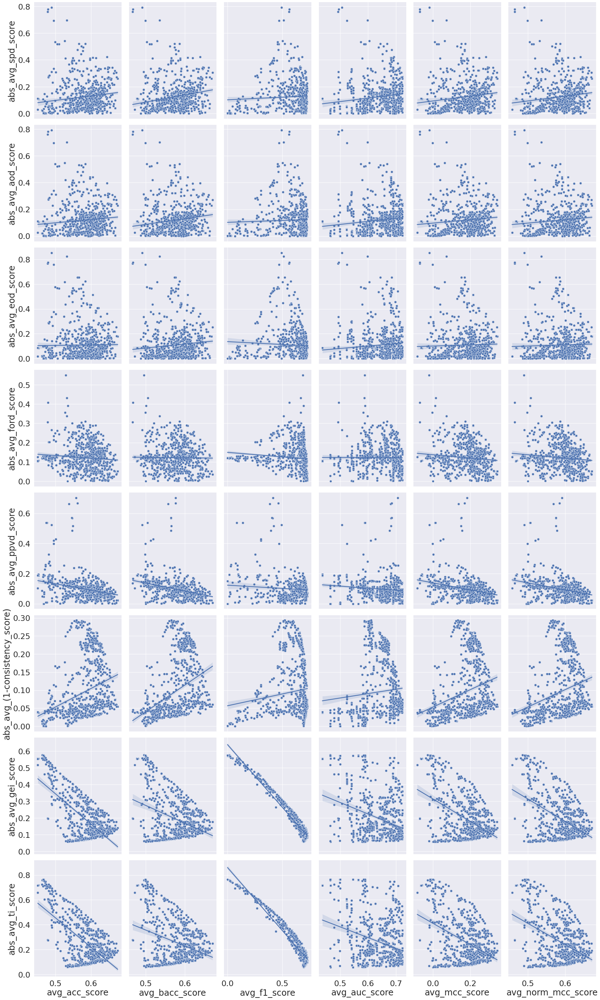

In [17]:
# Set plot font
plt.rcParams.update({'font.family':'serif'})
plt.rcParams.update({'font.serif':'Times New Roman'})

sns.set(font_scale = 2)
abs_fairness_metrics = ['abs_'+col for col in avg_fairness_metrics]
g = sns.pairplot(data=results_all_converted, x_vars=avg_accuracy_metrics, y_vars=abs_fairness_metrics,
             height=5, aspect=.8, kind="reg")
g.map(sns.scatterplot)

#### 4.1.2 Base_estimator specific Results

We can see from the graphs below:
1. Different base_estimators can also generate very different results: 
    - SVM (red) the least robust, while "NB" manifest clear trend
    - base_estimators divided into two groups when it comes to consistency_score: tree-based, ensemble (trade-offs) vs non tree-based, non ensemble

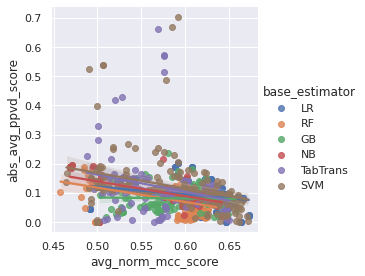

In [18]:
sns.set(font_scale = 1)
g = sns.lmplot(data=results_all_converted, x=ACC_METRIC, y=FAIR_METRIC, hue='base_estimator', height=4)

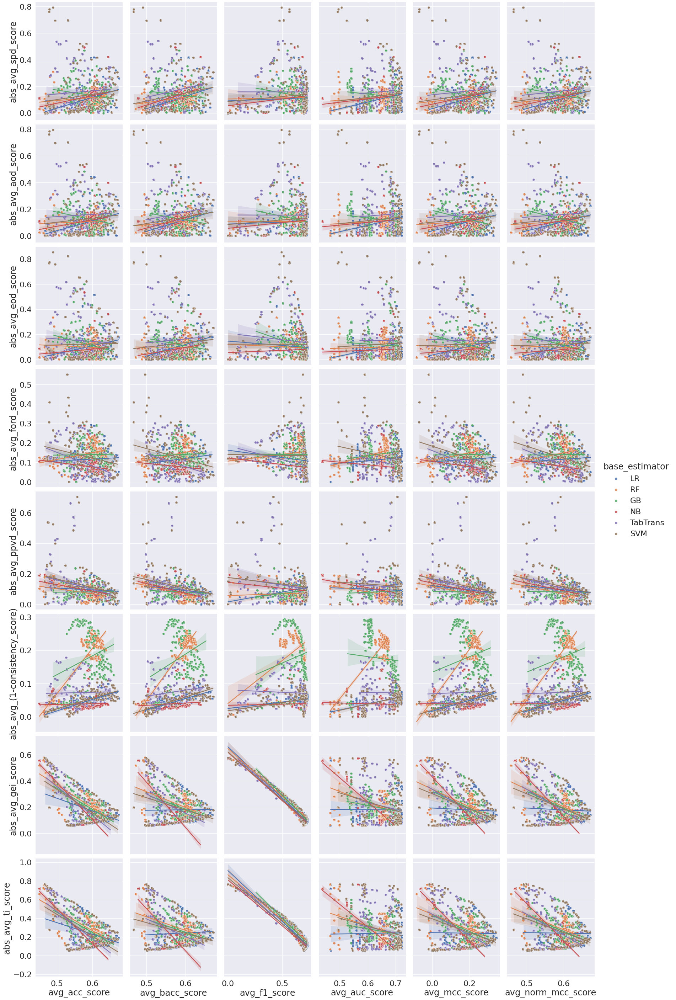

In [19]:
sns.set(font_scale = 2)
g = sns.pairplot(data=results_all_converted[results_all_converted.base_estimator!=''],
                 x_vars=avg_accuracy_metrics, y_vars=abs_fairness_metrics,
                 height=5, aspect=.8, kind="reg", hue='base_estimator')
g.map(sns.scatterplot)

LR


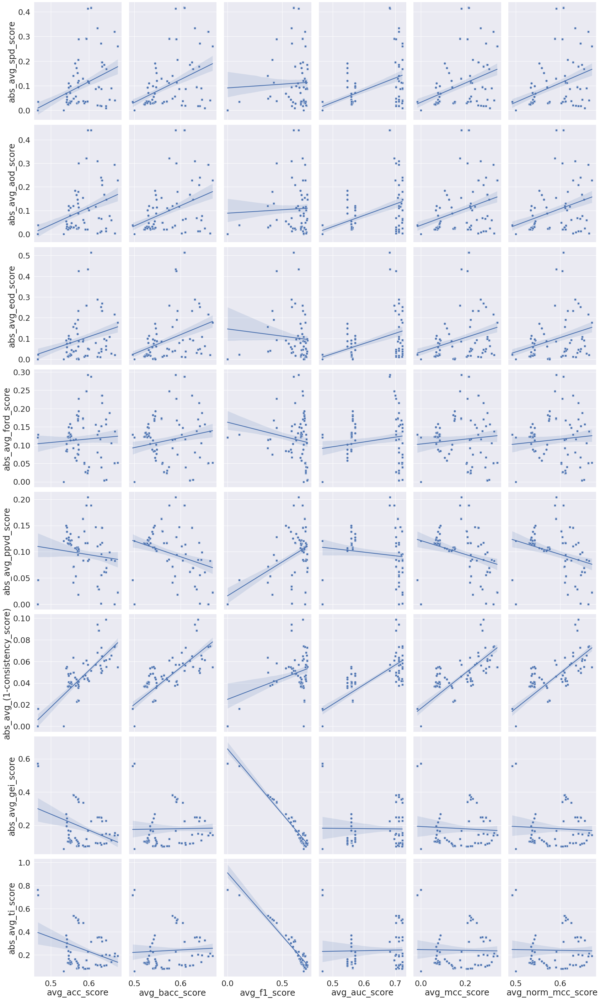

RF


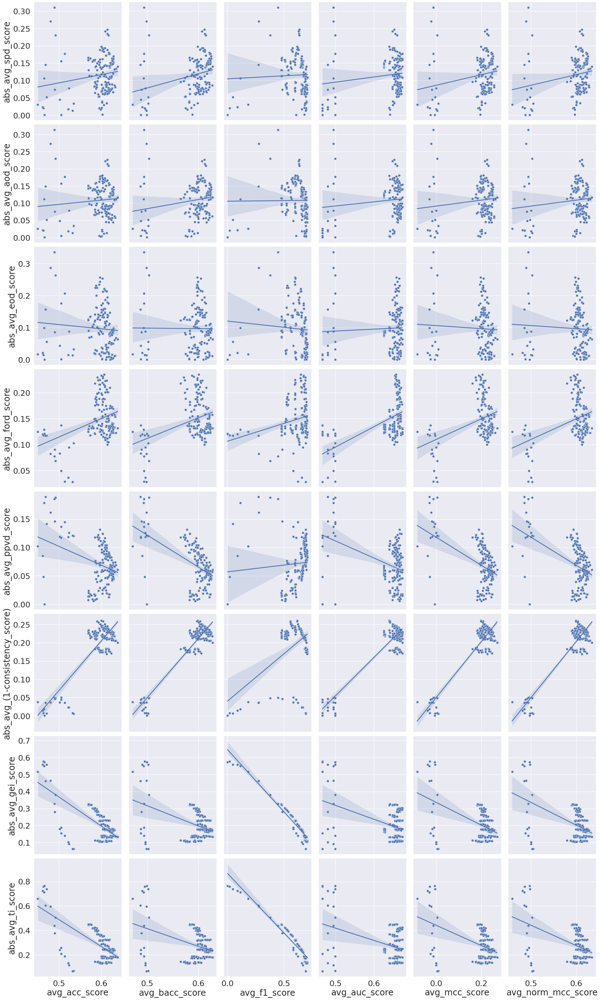

GB


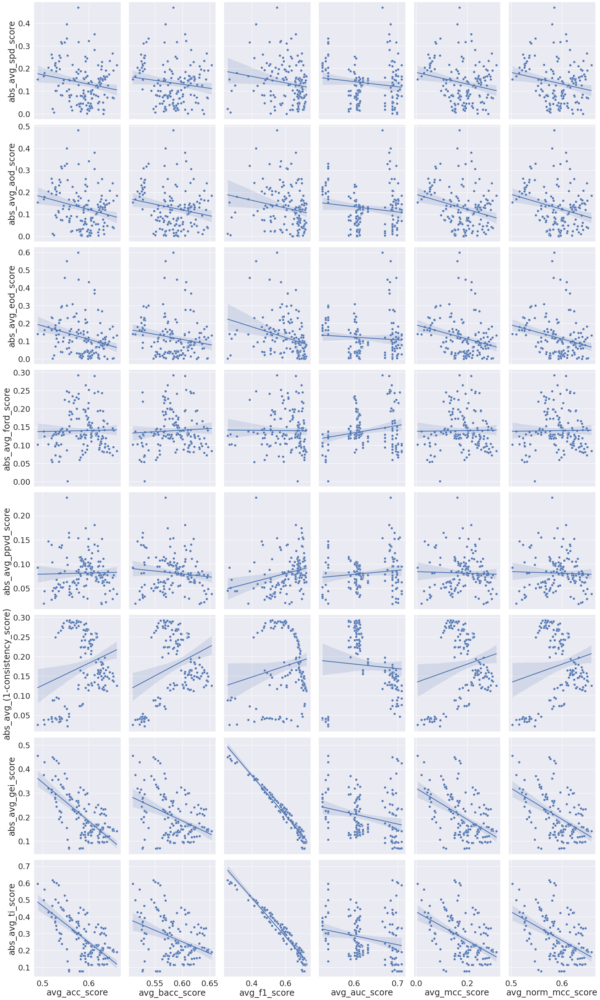

NB


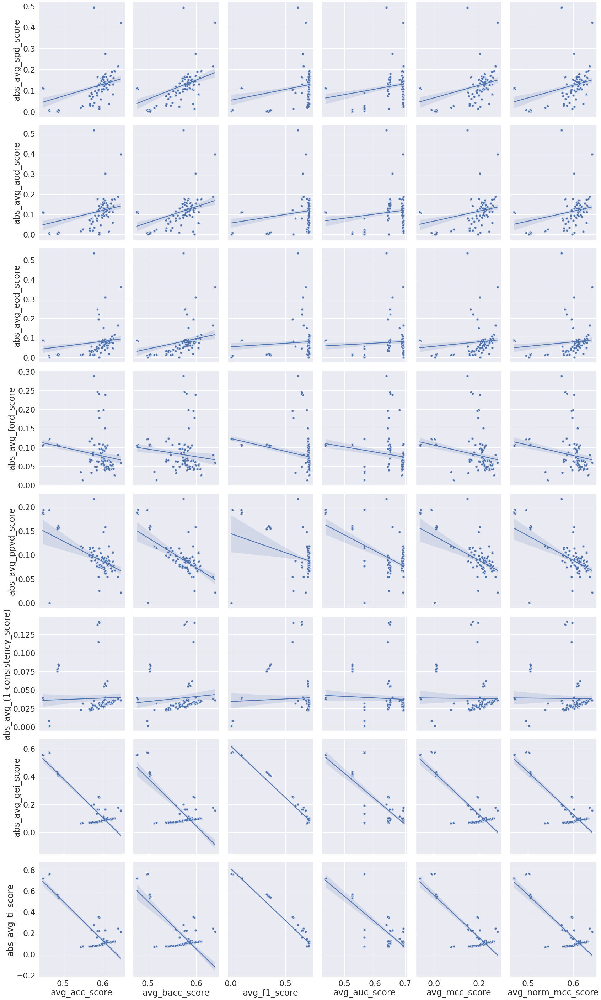

TabTrans


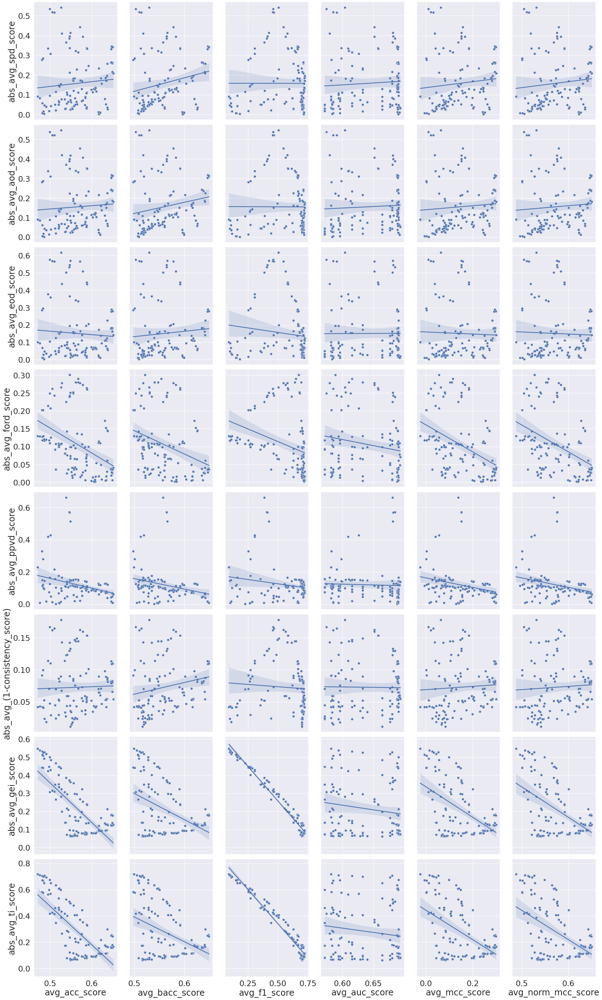

SVM


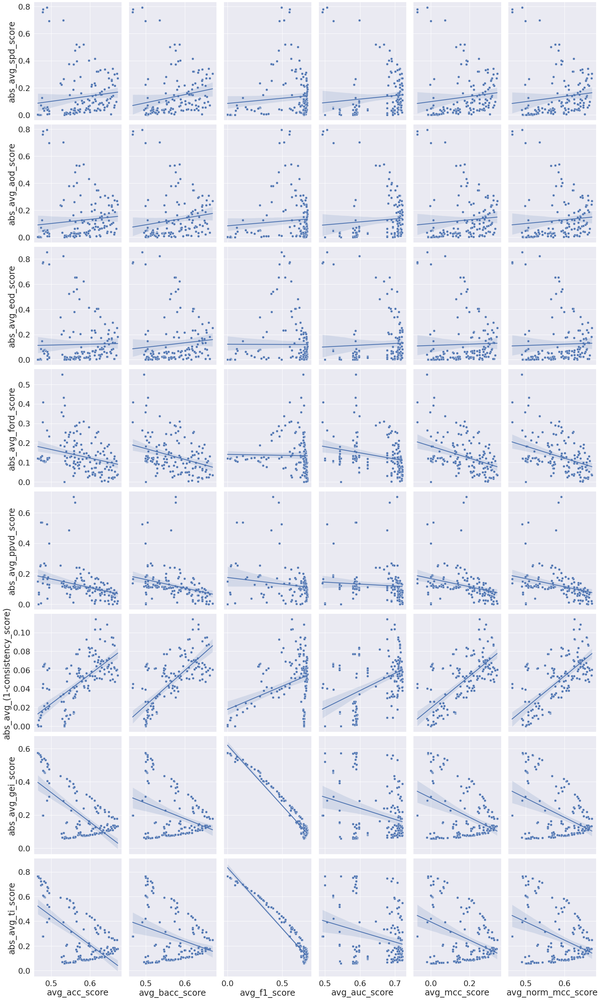

In [20]:
sns.set(font_scale = 2)
abs_fairness_metrics = ['abs_'+col for col in avg_fairness_metrics]
for base in results_all_converted.base_estimator.unique():
    print(base)
    if base=='':
        pass
    else:
        g = sns.pairplot(data=results_all_converted[results_all_converted.base_estimator==base],
                         x_vars=avg_accuracy_metrics, y_vars=abs_fairness_metrics,
                         height=5, aspect=.8, kind="reg")
        g.map(sns.scatterplot)
        plt.show()

#### 4.1.3 Threshold specific Results

We can see from the graphs below:
1. Using different threshold also yiels different results: 
    - most obvious with (f1_score, group_fairness) combinations

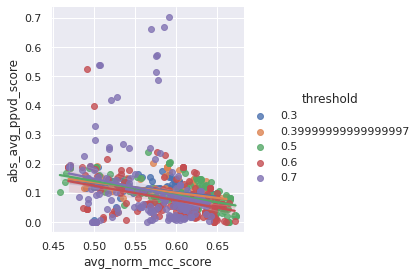

In [21]:
sns.set(font_scale = 1)
g = sns.lmplot(data=results_all_converted, x=ACC_METRIC, y=FAIR_METRIC, hue='threshold', height=4)

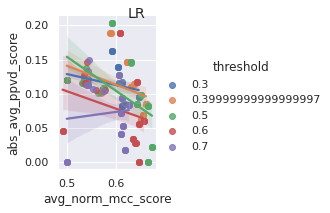

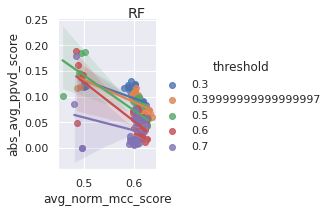

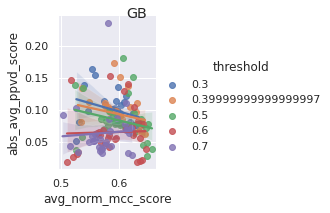

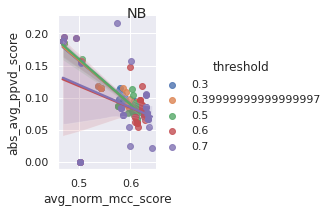

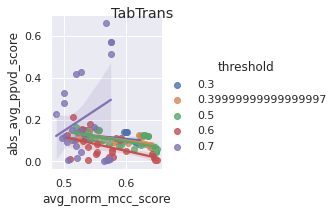

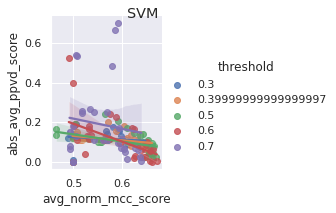

In [22]:
sns.set(font_scale = 1)
for base in results_all_converted.base_estimator.unique():
    g = sns.lmplot(data=results_all_converted[results_all_converted.base_estimator==base],
                   x="avg_norm_mcc_score", y="abs_avg_ppvd_score", hue="threshold", height=3).fig.suptitle(base)

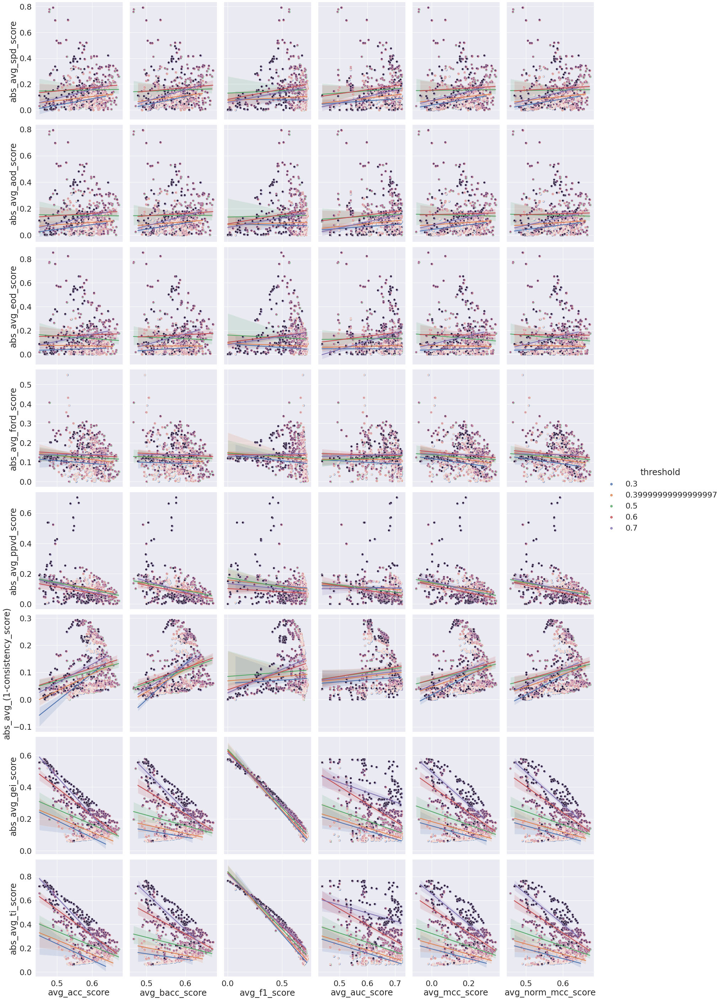

In [23]:
sns.set(font_scale = 2)
g = sns.pairplot(data=results_all_converted,
                 x_vars=avg_accuracy_metrics, y_vars=abs_fairness_metrics,
                 height=5, aspect=.8, kind="reg", hue='threshold')
g.map(sns.scatterplot)

#### 4.1.4 Bias_mitigation specific Results

We can see from the graphs below:
1. Results are clearly divided into two groups
2. Generally with wide C.I.

In [24]:
results_all_converted['BM_Category'] = results_all_converted['Bias_Mitigation'].replace({v: k for k, l in bm_category.items()\
                                                                                         for v in l})
results_all_converted[['Bias_Mitigation','BM_Category']].drop_duplicates()

,Bias_Mitigation,BM_Category
0,None,None
5,RW,PRE
10,LFR_pre,PRE
15,LFR_in,IN
20,AD,IN
25,EGR,IN
30,ROC,POST
35,CEO,POST
40,RW+ROC,RW+ROC
45,RW+CEO,RW+CEO


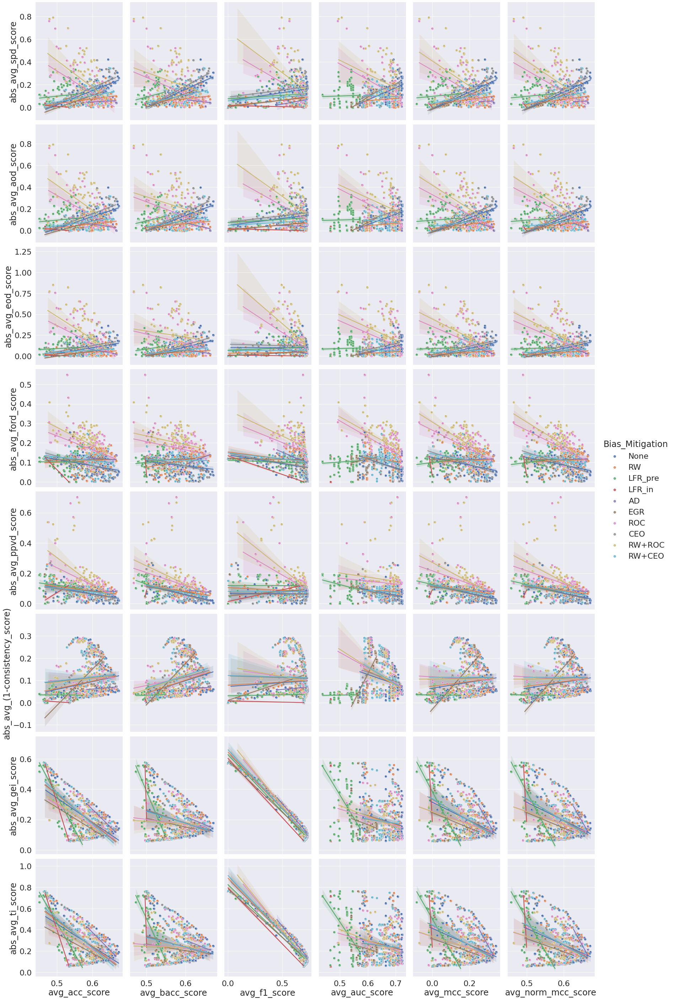

In [25]:
sns.set(font_scale = 2)
g = sns.pairplot(data=results_all_converted,
                 x_vars=avg_accuracy_metrics, y_vars=abs_fairness_metrics,
                 height=5, aspect=.8, kind="reg", hue='Bias_Mitigation')
g.map(sns.scatterplot)

In [26]:
# results_all_converted_try = results_all_converted.copy(deep=True).reset_index(drop=True)
# for i in results_all_converted_try.index:
#     if results_all_converted_try.loc[i, 'base_estimator'] == '':
#         results_all_converted_try.loc[i, 'base_estimator'] = results_all_converted_try.loc[i-1, 'base_estimator']
        
# results_all_converted_try.reset_index(drop=True).iloc[-30:,]

In [35]:
results_all_converted[(results_all_converted.Bias_Mitigation=='RW+CEO')&(results_all_converted.base_estimator=='LR')]

,base_estimator,param,Bias_Mitigation,threshold,avg_acc_score,avg_bacc_score,avg_f1_score,avg_auc_score,avg_mcc_score,avg_norm_mcc_score,...,cost,abs_avg_spd_score,abs_avg_aod_score,abs_avg_eod_score,abs_avg_ford_score,abs_avg_ppvd_score,abs_avg_(1-consistency_score),abs_avg_gei_score,abs_avg_ti_score,BM_Category
45,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}",RW+CEO,0.3,0.590081,0.563228,0.714455,0.702459,0.210488,0.605244,...,0.429053,0.034297,0.019574,0.017183,0.025806,0.116481,0.047415,0.073402,0.080948,RW+CEO
46,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}",RW+CEO,0.4,0.622276,0.601847,0.718804,0.702459,0.258205,0.629102,...,0.392122,0.021224,0.002403,0.012075,0.128502,0.110285,0.068130,0.092755,0.111687,RW+CEO
47,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}",RW+CEO,0.5,0.644390,0.637391,0.688748,0.702459,0.283160,0.641580,...,0.375504,0.017084,0.012150,0.046816,0.170561,0.084939,0.098764,0.150682,0.203699,RW+CEO
48,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}",RW+CEO,0.6,0.625041,0.634291,0.584756,0.702459,0.277768,0.638884,...,0.456142,0.095026,0.068092,0.031007,0.138874,0.028494,0.088748,0.248657,0.353097,RW+CEO
49,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}",RW+CEO,0.7,0.559024,0.581891,0.370731,0.702459,0.218995,0.609498,...,0.438736,0.048234,0.027978,0.036821,0.114912,0.071366,0.049789,0.382073,0.538033,RW+CEO
95,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'saga'}",RW+CEO,0.3,0.590081,0.563228,0.714455,0.702465,0.210488,0.605244,...,0.429053,0.034297,0.019574,0.017183,0.025806,0.116481,0.047415,0.073402,0.080948,RW+CEO
96,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'saga'}",RW+CEO,0.4,0.622276,0.601847,0.718804,0.702465,0.258205,0.629102,...,0.392122,0.021224,0.002403,0.012075,0.128502,0.110285,0.068130,0.092755,0.111687,RW+CEO
97,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'saga'}",RW+CEO,0.5,0.644390,0.637391,0.688748,0.702465,0.283160,0.641580,...,0.375504,0.017084,0.012150,0.046816,0.170561,0.084939,0.098764,0.150682,0.203699,RW+CEO
98,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'saga'}",RW+CEO,0.6,0.625041,0.634291,0.584756,0.702465,0.277768,0.638884,...,0.456142,0.095026,0.068092,0.031007,0.138874,0.028494,0.088748,0.248657,0.353097,RW+CEO
99,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'saga'}",RW+CEO,0.7,0.559024,0.581891,0.370731,0.702465,0.218995,0.609498,...,0.438736,0.048234,0.027978,0.036821,0.114912,0.071366,0.049789,0.382073,0.538033,RW+CEO


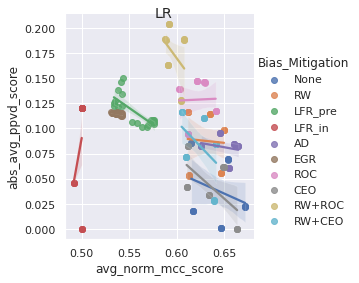

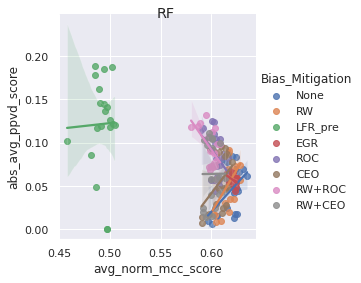

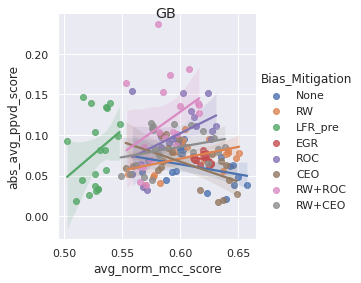

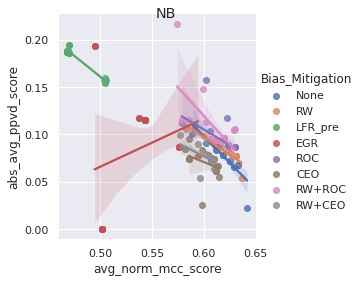

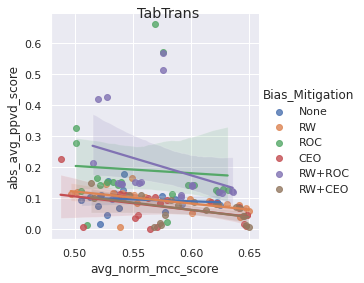

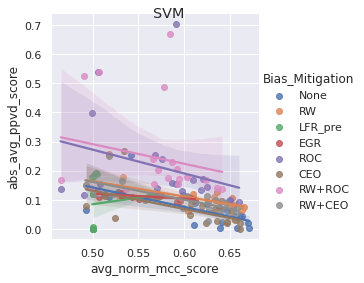

In [27]:
sns.set(font_scale = 1)
for base in results_all_converted.base_estimator.unique():
    g = sns.lmplot(data=results_all_converted[results_all_converted.base_estimator==base],
                   x="avg_norm_mcc_score", y="abs_avg_ppvd_score", hue="Bias_Mitigation", height=4).fig.suptitle(base)

##### Bias Mitigation Category

Pre- and post-processing always generate similar results, while in-processing is usually different:
    - less trade-offs between group fairness and accuracy
    - but trade-offs for "ford_score", which is the very g_fair metric showing no trade-offs in overall results

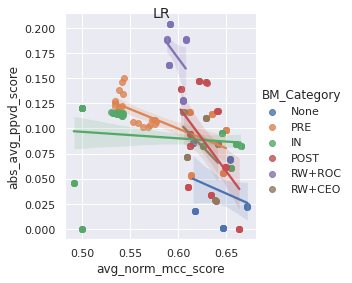

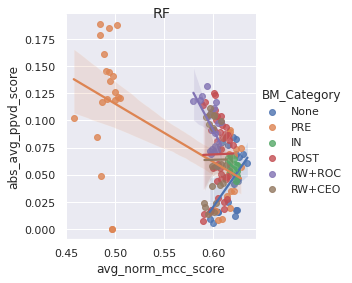

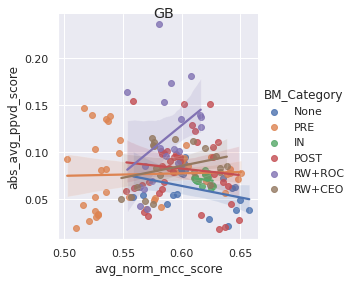

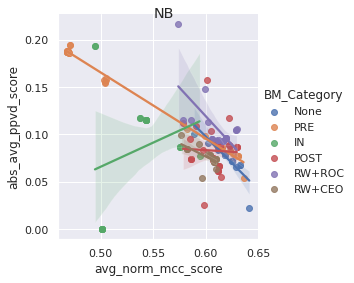

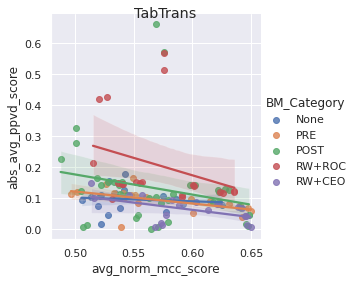

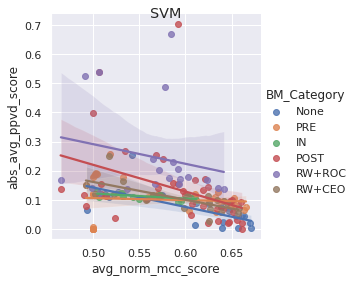

In [28]:
sns.set(font_scale = 1)
for base in results_all_converted.base_estimator.unique():
    g = sns.lmplot(data=results_all_converted[results_all_converted.base_estimator==base],
                   x="avg_norm_mcc_score", y="abs_avg_ppvd_score", hue="BM_Category", height=4).fig.suptitle(base)

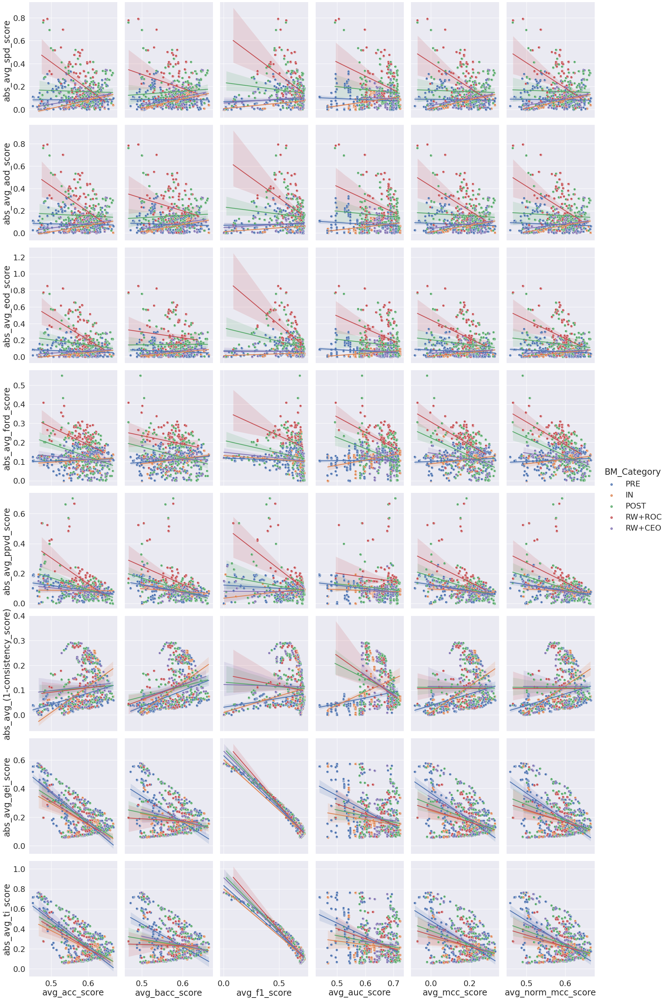

In [36]:
sns.set(font_scale = 2)
g = sns.pairplot(data=results_all_converted[results_all_converted.BM_Category!='None'],
                 x_vars=avg_accuracy_metrics, y_vars=abs_fairness_metrics,
                 height=5, aspect=.8, kind="reg", hue='BM_Category')
g.map(sns.scatterplot)

### 4.2 Group vs. Individual Fairness

No clear trend between group and individual fairness with a few exceptions

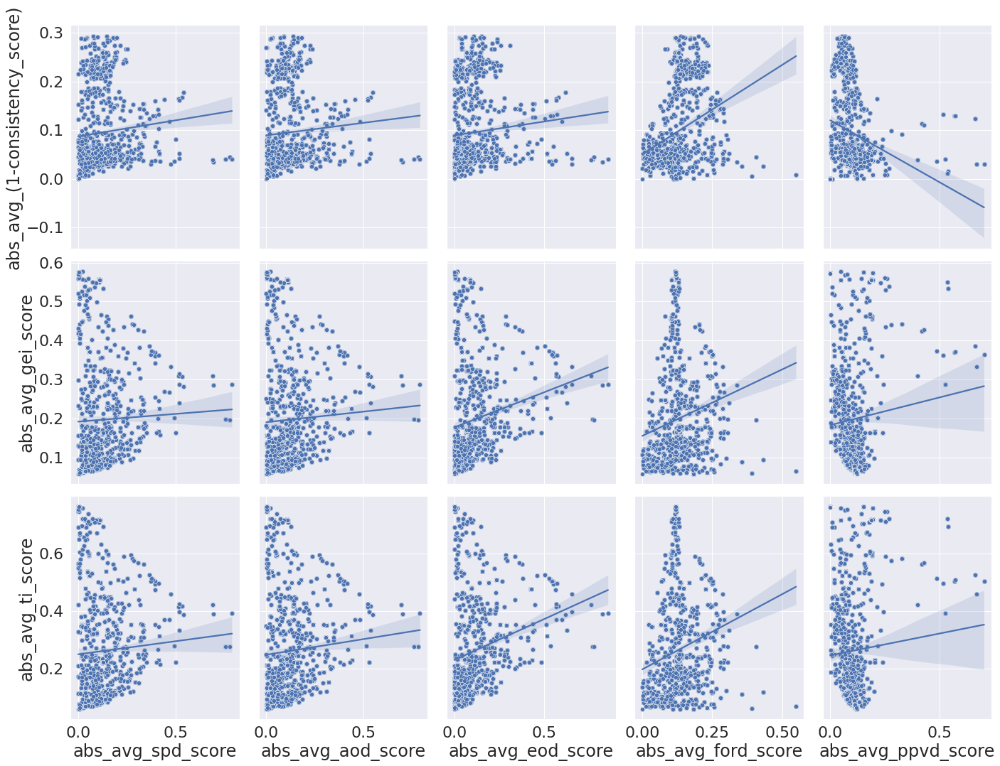

In [30]:
g = sns.pairplot(data=results_all_converted,
                 x_vars=['abs_avg_'+col for col in group_fairness], y_vars=['abs_avg_'+col for col in individual_fairness],
             height=5, aspect=.8, kind="reg")
g.map(sns.scatterplot)

#### 4.2.1 Heatmap

<AxesSubplot:>

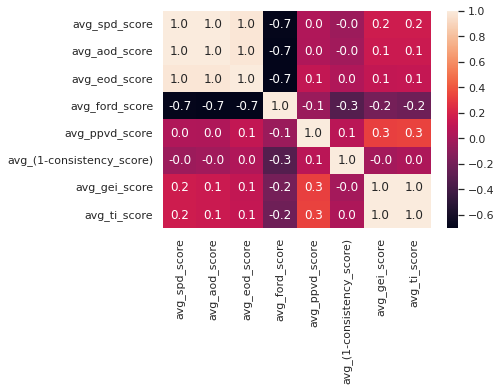

In [31]:
sns.set(font_scale = 1)
# avg_accuracy_metrics = ['avg_'+col for col in accuracy_metrics]
# avg_fairness_metrics = ['avg_'+col for col in fairness_metrics]
sns.heatmap(results_all_converted[avg_fairness_metrics].corr(), annot=True, fmt=".1f")

<AxesSubplot:>

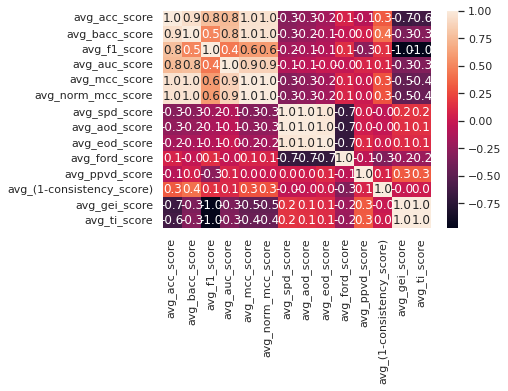

In [32]:
sns.set(font_scale = 1)
# avg_accuracy_metrics = ['avg_'+col for col in accuracy_metrics]
# avg_fairness_metrics = ['avg_'+col for col in fairness_metrics]
sns.heatmap(results_all_converted[avg_accuracy_metrics+avg_fairness_metrics].corr(), annot=True, fmt=".1f")